# Previsão de Evasão em cursos técnicos na Rede Federal de Educação Profissional, Científica e Tecnológica
<i>Este projeto tem por objetivo construir um modelo de aprendizado de máquina para prever a probabilidade de evasão em curso técnico na Rede Federal de Educação Profissional, Científica e Tecnológica no Brasil. Isso envolve aprendizado supervisionado (usando um conjunto de treinamento rotulado) para classificação, onde o <b>alvo</b> é 1 se o aluno evadiu de um curso técnico, caso contrário, 0.</i>
 


###  <b>Pipeline</b> utilizado baseado na estrutura <b>CRISP-DM:</b>

<b>1. Entendimento do negócio: definir o problema de negócio.</b><br>
<b>2. Entendimento dos dados: coletar os dados e obter uma visão geral.</b><br>
<b>3. Preparação dos dados: engenharia de características, limpeza e pré-processamento dos dados. Explorar os dados (análise exploratória de dados).</b><br>
4. Modelagem: dividir os dados em conjuntos de treinamento e teste, treinamento do modelo, comparação, seleção de características e tunning.<br>
5. Avaliação: teste e avaliação do modelo final em produção.<br>
6. Implementação (deployment): interpretar os resultados do modelo, concluir e implantar.<br>
<center>

![CRISP-DM](https://www.ibm.com/docs/pt-br/SS3RA7_18.4.0/modeler_crispdm_ddita/clementine/images/crisp_process.jpg)

</center>


<i>Neste notebook será realizada uma análise exploratória de dados (EDA), cobrindo os passos 1 a 3 do pipeline acima. O principal objetivo aqui é descobrir insights que nos darão informações valiosas sobre os padrões de evasão dentro das características disponíveis. Assim, mesmo antes de construir um modelo, será possível contribuir com a Rede Federal com alguns características e tendências de aluno que evadem. Além disso, será abordado os passos em detalhes, explicando o motivo de cada decisão tomada.</i>

##  1. Entendimento de Negócio (Problema de Negócio)
A evasão em cursos técnicos é uma preocupação universal. Entender os motivos que levam estudantes a abandonarem os estudos no ensino técnico é o anseio de muitos gestores e pesquisadores sobre interessado no tema. É relevante prever a probabilidade de um aluno evadir de um curso técnico para que pudessem agir proativamente para revender suas decisões.

<b>1.1 Qual é o contexto?</b>

Quando uma Unidade de ensino matricula um aluno em um curso técnico, três categorias de situações de matrículas são atribuídas a uma matrícula ao longo do curso:  

- <b>1. Em curso</b>: Aplica-se ao aluno que encontra-se estudando em um curso técnico. Em um determinado ano uma grande quantidade de matrículas são iniciadas em cursos técnicos na Rede Federal.<br>

- <b>2. Concluído</b>: Aplica-se ao alugno que concluiu o curso técnico. Uma relevante quantidade de alunos conclui seus cursos técnicos em um determinado ano na Rede Federal.<br>

- <b>3. Evadido</b>: Status de matrícula aplicado ao aluno que abandonou o curso técnico. Uma quantidade expressiva de alunos abandonam as aulas durante em um determinado ano na Rede Federal.<br>

> Essas situações de matrículas ajudam uma Unidade de Ensino a avaliar a eficácia de suas estratégias na formar alunos para o mundo do trabalho.  

Para maximizar a eficiência, a unidade de ensino visa minimizar as evasões e maximizar as conclusões dos alunos.

Quais são os objetivos do projeto?

- <b>1. Identificar os fatores associados a evasão de alunos.</b><br>
- <b>2. Construir um modelo capaz de prever com precisão a probabilidade de um aluno evadir de um curso técnico.</b><br>
- <b>3. Oferecer planos de ação para a unidade de ensino reduzir a evasão de alunos em cursos técnicos.</b><br>


Por que a abordagem de ordenação de probabilidade/pontuação?

> Ao implantar o modelo para que a unidade de ensino possa realizar previsões, o principal objetivo é gerar escores de probabilidade para cada aluno. Isso geralmente é mais valioso para as unidades de ensino em comparação com fazer previsões binárias (1/0), pois permite uma melhor tomada de decisões e estratégias de retenção de alunos mais eficazes.
Por exemplo, prever a probabilidade de evasão fornece insights mais acionáveis. Em vez de simplesmente determinar se um aluno vai evadir ou não, é possível obter ganho de compreensão de quão provável isso é de acontecer. Essa informação permite que a unidade de ensino aloque seus esforços e recursos de forma mais eficaz. Por exemplo, pode concentrar seus esforços de retenção em alunos com alta probabilidade de evasão, ordenando os alunos do mais provável ao menos provável de evadir.

Quais são os benefícios?
- <b>1. Redução de gastos da unidade de ensino</b><br>
- <b>2. Melhoria na retenção de alunos</b><br>
- <b>3. Experiência do aluno aprimorada</b><br>
- <b>4. Atuação pro-ativa dos setores de assistência estudantil</b><br>
- <b>5. Estudos direcionados por característica</b><br>

E, como resultado, o problema de negócio (evasão) mencionado será resolvido.


####  1.1 Importando as bibliotecas

In [1]:
# Manipulação e visualização de dados.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import openai
import geopandas as gpd
import folium
import os
 

# Dividir os dados.
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder


# Filtrar avisos.
import warnings
warnings.filterwarnings('ignore')

### Configurações de Visualização
%matplotlib inline

mpl.style.use('ggplot') 

mpl.rcParams['axes.facecolor']      = 'white'
mpl.rcParams['axes.linewidth']      = 1
mpl.rcParams['xtick.color']         = 'black'
mpl.rcParams['ytick.color']         = 'black'
mpl.rcParams['grid.color']          = 'lightgray'
mpl.rcParams['figure.dpi']          = 150
mpl.rcParams['axes.grid']           = True
mpl.rcParams['font.size']           = 12

# Configuração de Paleta
# color_palette = ['#000080', '#023177', '#4169E1', '#87CEEB', '#8AC6D1', '#A6C8FF'] #paleta de azul
# color_palette = ['#023177', '#e85d04', '#006494', '#ff9000', '#1B98E0', '#ff9c20'] 
# color_palette = ['#00274D', '#004D66', '#007380', '#009999', '#006633', '#004D26'] # paleta de verde
color_palette = ['#66C2A5', '#FC8D62', '#8DA0CB', '#E78AC3', '#A6D854', '#FFD92F', '#E5C494', '#B3B3B3']
# color_palette = ['#1b0c41', '#4b0f6f', '#781c6d', '#a52c60', '#cf4446', '#ed6925', '#fb9b06', '#f7d13d', '#fcffa4']
# color_palette = ["#F72585", "#7209B7", "#3A0CA3", "#4361EE", "#4CC9F0"]
# color_palette = 'mako' #mako Set2 cividis 
# color_palette = 'mako'

# Definindo como a paleta
sns.set_palette(sns.color_palette(color_palette))
# Exibir
sns.color_palette(color_palette)

[(0.4, 0.7607843137254902, 0.6470588235294118),
 (0.9882352941176471, 0.5529411764705883, 0.3843137254901961),
 (0.5529411764705883, 0.6274509803921569, 0.796078431372549),
 (0.9058823529411765, 0.5411764705882353, 0.7647058823529411),
 (0.6509803921568628, 0.8470588235294118, 0.32941176470588235),
 (1.0, 0.8509803921568627, 0.1843137254901961),
 (0.8980392156862745, 0.7686274509803922, 0.5803921568627451),
 (0.7019607843137254, 0.7019607843137254, 0.7019607843137254)]

---
## 2. Entendimento de dados
Coletar os dados com o objetivo de obter uma visão geral que contemple os seguintes itens:
- Análise univariada.
- Identificação de Outliers.
- Análise da variável alvo.
- Análise da variável target.
- Mapa da evasão no Brasil.

###  2.1 Coletando os Dados
- O conjunto de dados foi obtido no Portal Dados Aberto do Governo Federal: https://dadosabertos.mec.gov.br/pnp/item/261-2023-microdados-eficiencia-academica 
- A origem dos dados é a Plataforma Nilo Peçanha (PNP): https://www.gov.br/mec/pt-br/pnp 
- O conjunto de dados contém informações sobre matrículas de alunos da Rede Federal de Educação Profissional, Científica e Tecnológica em 2022, incluindo dados demográficos, institucionais e de cursos técnicos. Já está rotulado, com alunos que evadiram identificados como 1 e alunos que não evadiram identificados como 0 na variável de categoria da situação de matrícula.
- Inicialmente, cade informar que foram utilizados os dados de matrículas do tipo de cursos igual a técnico. O motivo pela escolha apenas dos cursos técnicos se embasa na lei que criou a RFEPCT, na qual a formação técnica é prioritária no percentual de oferta (no mínimo 50%) e por sua duração mínima de 800 horas aulas, permite um acompanhamento anual.
- Além disso, foi utilizada a base de dados de regiões metropolitanas do Brasil disponibiliza pelo IBGE: https://www.ibge.gov.br/geociencias/organizacao-do-territorio/estrutura-territorial/18354-recortes-metropolitanos-e-aglomeracoes-urbanas.html.
- A intenção foi identificar as escolas quem estão localizadas em regiões metropolitanas e com isso, analisar se há relação com a decisão de evadir dos alunos.

In [2]:
# Carregar a base de dados com a junção da base de matrículas da PNP 2022 + recorte de regiões metropolitanas do Brasil
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
df = pd.read_csv(data_path, sep=';')

In [3]:
df.head()

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,MUNICIPIO,REGIAO,INSTITUICAO,UNIDADE_DE_ENSINO,REGIÃO_METROPOLINA_UE
0,Concluídos,Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Campos dos Goytacazes,Sudeste,Instituto Federal Fluminense,Campus Campos Centro,NÃO
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Campos dos Goytacazes,Sudeste,Instituto Federal Fluminense,Campus Campos Centro,NÃO
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Rio de Janeiro,Sudeste,Instituto Federal do Rio de Janeiro,Campus Rio de Janeiro,SIM
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Pelotas,Sul,Instituto Federal Sul-rio-grandense,Campus Pelotas,NÃO
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Natal,Nordeste,Instituto Federal do Rio Grande do Norte,Campus Natal Central,SIM


In [4]:
print(f'O dataset contém {df.shape[0]} linhas e {df.shape[1]} colunas.')

O dataset contém 145831 linhas e 17 colunas.


In [5]:
df[df.duplicated()]

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,MUNICIPIO,REGIAO,INSTITUICAO,UNIDADE_DE_ENSINO,REGIÃO_METROPOLINA_UE
100,Concluídos,Parda,22,Masculino,"0,5<RFP<=1",Educação Presencial,Integrado,Matutino,Técnico em Mecânica,Controle e Processos Industriais,1200,RJ,Paracambi,Sudeste,Instituto Federal do Rio de Janeiro,Campus Paracambi,SIM
121,Concluídos,Parda,22,Feminino,Não declarada,Educação Presencial,Integrado,Vespertino,Técnico em Química,Produção Industrial,1200,CE,Fortaleza,Nordeste,Instituto Federal do Ceará,Campus Fortaleza,SIM
132,Concluídos,Branca,23,Feminino,Não declarada,Educação Presencial,Integrado,Integral,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,RS,Santa Maria,Sul,Colégio Técnico Industrial da UFSM,Colégio Técnico Industrial da Universidade Fed...,NÃO
135,Concluídos,Branca,23,Feminino,Não declarada,Educação Presencial,Integrado,Integral,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,RS,Santa Maria,Sul,Colégio Técnico Industrial da UFSM,Colégio Técnico Industrial da Universidade Fed...,NÃO
136,Concluídos,Branca,23,Feminino,Não declarada,Educação Presencial,Integrado,Integral,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,RS,Santa Maria,Sul,Colégio Técnico Industrial da UFSM,Colégio Técnico Industrial da Universidade Fed...,NÃO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145820,Em Curso,Branca,26,Feminino,"0,5<RFP<=1",Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Machado,Sudeste,Instituto Federal do Sul de Minas Gerais,Campus Machado,NÃO
145821,Em Curso,Parda,22,Feminino,"1<RFP<=1,5",Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Machado,Sudeste,Instituto Federal do Sul de Minas Gerais,Campus Machado,NÃO
145823,Concluídos,Branca,47,Masculino,Não declarada,Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Machado,Sudeste,Instituto Federal do Sul de Minas Gerais,Campus Machado,NÃO
145827,Concluídos,Não declarada,20,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,GO,Goiânia,Centro-Oeste,Instituto Federal de Goiás,Campus Goiânia,SIM


In [6]:
duplicados = df.duplicated()
duplicados.sum()

33170

Os valores duplicados não represetam problema para a análise de dados. Visto que, existe na base de dados alunos com caractetística idênticas em uma mesmo curso. Tais como: idade, sexo, renda familiar, cor/raça.

### 2.2 Dicionário de Dados

Avaliando o conjunto de dados para compreender os dados
Varíavel   | Descrição
------- | ------
<b> 1. CATEGORIA_SITUACAO (TARGET): | Indica a situação do aluno em relação ao seu status de matrícula (ex.: em curso, concluído, evadido). Categórico nominal.
<b> 2. COR_RACA: | Refere-se à cor ou raça do aluno, com categorias que podem incluir branca, preta, parda, amarela e indígena. Categórico nominal.
<b> 3. IDADE: | A idade do aluno no momento da matrícula ou da coleta de dados, expressa em anos. Numérica discreta.
<b> 4. SEXO: | O gênero do aluno, podendo ser masculino ou feminino. Categórico nominal.
<b> 5. RENDA_FAMILIAR: | A faixa de renda da família do aluno, que pode ser classificada em diferentes níveis. Categórico ordinal.
<b> 6. MODALIDADE_DE_ENSINO: | Modalidade de ensino que o aluno estuda, como Educação Presencial ou Educação a Distância. Categórico nominal.
<b> 7. TIPO_DE_OFERTA: | Forma como o curso é ofertado, podendo ser subsequente, concomitante ou integrado. Categórico nominal.
<b> 8. TURNO: | O período em que as aulas ocorrem, podendo ser matutino, vespertino, noturno ou integral. Categórico nominal.
<b> 9. NOME_DE_CURSO: |  O nome do curso que o aluno está matriculado. Categórico nominal.<br>
<b> 10. EIXO_TECNOLOGICO: | A área de conhecimento, geralmente relacionada a áreas técnicas ou específicas. Categórico nominal.
<b> 11. CARGA_HORARIA_MINIMA: | A carga horária mínima exigida para a conclusão do curso, expressa em horas. Categórico ordinal.
<b> 12. UF: | Unidade Federativa onde a instituição de ensino está localizada (ex.: SP para São Paulo). Categórico nominal.
<b> 13. MUNICIPIO: | O município onde a instituição está situada. Categórico nominal.
<b> 14. REGIAO:  | A região geográfica do país onde a instituição se encontra (ex.: Norte, Sul, Sudeste). Categórico nominal.
<b> 15. INSTITUICAO: | O nome da instituição de ensino em que o aluno está matriculado. Categórico nominal.
<b> 16. UNIDADE_DE_ENSINO: | A unidade de ensino da instituição onde o aluno está cursando. Categórico nominal.
<b> 17. REGIÃO_METROPOLINA_UE: | Indica se a unidade de ensino está situada em uma região metropolitana de uma unidade federativa específica. Categórico nominal.


### 2.3 Visão geral dos dados
Será apresentada as principais caracterísica do conjunto de dados. Com destaque para as seguintes observações:
- Valores nulos do dataset
- valores únicos em cada variável
- Apresentação da quantidade de dados por variável através de gráficos
- Análise de outliers
- Análise da distribuição dos dados
- Apresentação da variável alvo (target) - avaliação do balanceamento
- Análise de cada variável com relação a varíavel alvo (target)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145831 entries, 0 to 145830
Data columns (total 17 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   CATEGORIA_SITUACAO     145831 non-null  object
 1   COR_RACA               145831 non-null  object
 2   IDADE                  145831 non-null  int64 
 3   SEXO                   145831 non-null  object
 4   RENDA_FAMILIAR         145831 non-null  object
 5   MODALIDADE_DE_ENSINO   145831 non-null  object
 6   TIPO_DE_OFERTA         145831 non-null  object
 7   TURNO                  145831 non-null  object
 8   NOME_DE_CURSO          145831 non-null  object
 9   EIXO_TECNOLOGICO       145831 non-null  object
 10  CARGA_HORARIA_MINIMA   145831 non-null  int64 
 11  UF                     145831 non-null  object
 12  MUNICIPIO              145831 non-null  object
 13  REGIAO                 145831 non-null  object
 14  INSTITUICAO            145831 non-null  object
 15  

In [8]:
df

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,MUNICIPIO,REGIAO,INSTITUICAO,UNIDADE_DE_ENSINO,REGIÃO_METROPOLINA_UE
0,Concluídos,Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Campos dos Goytacazes,Sudeste,Instituto Federal Fluminense,Campus Campos Centro,NÃO
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Campos dos Goytacazes,Sudeste,Instituto Federal Fluminense,Campus Campos Centro,NÃO
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Rio de Janeiro,Sudeste,Instituto Federal do Rio de Janeiro,Campus Rio de Janeiro,SIM
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Pelotas,Sul,Instituto Federal Sul-rio-grandense,Campus Pelotas,NÃO
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Natal,Nordeste,Instituto Federal do Rio Grande do Norte,Campus Natal Central,SIM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145826,Em Curso,Parda,28,Masculino,"1,5<RFP<=2,5",Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Machado,Sudeste,Instituto Federal do Sul de Minas Gerais,Campus Machado,NÃO
145827,Concluídos,Não declarada,20,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,GO,Goiânia,Centro-Oeste,Instituto Federal de Goiás,Campus Goiânia,SIM
145828,Concluídos,Branca,19,Feminino,"0,5<RFP<=1",Educação Presencial,Integrado,Vespertino,Técnico em Informática,Informação e Comunicação,1000,MS,Campo Grande,Centro-Oeste,Instituto Federal do Mato Grosso do Sul,Campus Campo Grande,NÃO
145829,Concluídos,Não declarada,22,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Agropecuária,Recursos Naturais,1200,MA,Buriticupu,Nordeste,Instituto Federal do Maranhão,Campus Buriticupu,NÃO


In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145831.0,25.280578,8.472652,4.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145831.0,1074.305189,168.626663,800.0,1000.0,1200.0,1200.0,3000.0


In [10]:
df.describe(exclude='number')

,CATEGORIA_SITUACAO,COR_RACA,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,UF,MUNICIPIO,REGIAO,INSTITUICAO,UNIDADE_DE_ENSINO,REGIÃO_METROPOLINA_UE
count,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831,145831
unique,3,6,3,7,2,6,5,140,13,27,550,5,62,618,2
top,Concluídos,Parda,Feminino,Não declarada,Educação Presencial,Integrado,Integral,Técnico em Informática,Controle e Processos Industriais,MG,Brasília,Nordeste,Instituto Federal do Sul de Minas Gerais,Campus Pouso Alegre,NÃO
freq,68567,63079,76003,41511,131989,80647,44445,16594,26236,20477,3483,49609,8861,2396,83567


Alguns insights:
1. Das 17 colunas existentes no dataset, 15 são categóricas. E apenas 2 são numéricas.

2. A coluna CATEGORIA_SITUACAO (Target) contém três valores: em curso, concluinte, evadido.

Valores presentes no conjunto de dados
Varíavel   | Valores
------- | ------
<b> 1. CATEGORIA_SITUACAO (TARGET): | Em curso, Concluído, Evadido
<b> 2. COR_RACA: | Branca, Preta, Parda, Amarela e Indígena
<b> 3. IDADE: | De 4 a 84
<b> 4. SEXO: | Masculino, Feminino e Não informado
<b> 5. RENDA_FAMILIAR: | 0<RFP<=0,5 - 0,5<RFP<=1,0 - 1,0<RFP<=1,5 -  1,5<RFP<=2,5 2,5<RFP<=3,5 - RFP>3,5' - Não declarada 
<b> 6. MODALIDADE_DE_ENSINO: | Educação Presencial ou Educação a Distância
<b> 7. TIPO_DE_OFERTA: | Subsequente, Concomitante ou Integrado
<b> 8. TURNO: | Matutino, vespertino, noturno ou integral
<b> 9. NOME_DE_CURSO: |  140 nomes de cursos técnicos
<b> 10. EIXO_TECNOLOGICO: | 13 eixos tecnológicos
<b> 11. CARGA_HORARIA_MINIMA: | 800, 1000 e 1200
<b> 12. UF: | 27 UFs
<b> 13. MUNICIPIO: | 550 municípios
<b> 14. REGIAO:  | 5 regiões
<b> 15. INSTITUICAO: | 62 Instituições
<b> 16. UNIDADE_DE_ENSINO: | 618 unidades de ensino
<b> 17. REGIÃO_METROPOLINA_UE: | Sim ou Não

#### 2.3.1 Valores nulos do dataset

In [11]:
#Identifcação de valores nulos
df.isnull().sum()

CATEGORIA_SITUACAO       0
COR_RACA                 0
IDADE                    0
SEXO                     0
RENDA_FAMILIAR           0
MODALIDADE_DE_ENSINO     0
TIPO_DE_OFERTA           0
TURNO                    0
NOME_DE_CURSO            0
EIXO_TECNOLOGICO         0
CARGA_HORARIA_MINIMA     0
UF                       0
MUNICIPIO                0
REGIAO                   0
INSTITUICAO              0
UNIDADE_DE_ENSINO        0
REGIÃO_METROPOLINA_UE    0
dtype: int64

### 2.4 Análise Univariada
Análise univariada para observar quais são os valores típicos de cada característica dos alunos da Rede Federal EPCT.

#### 2.4.1 valores únicos em cada variável

In [9]:
#identificação de valores únicos
df.nunique()

CATEGORIA_SITUACAO         3
COR_RACA                   6
IDADE                     79
SEXO                       3
RENDA_FAMILIAR             7
MODALIDADE_DE_ENSINO       2
TIPO_DE_OFERTA             6
TURNO                      5
NOME_DE_CURSO            140
EIXO_TECNOLOGICO          13
CARGA_HORARIA_MINIMA       6
UF                        27
MUNICIPIO                550
REGIAO                     5
INSTITUICAO               62
UNIDADE_DE_ENSINO        618
REGIÃO_METROPOLINA_UE      2
dtype: int64

Não há valores ausentes ou duplicados.

#### 2.4.2 Apresentação da quantidade de dados por variável através de gráficos

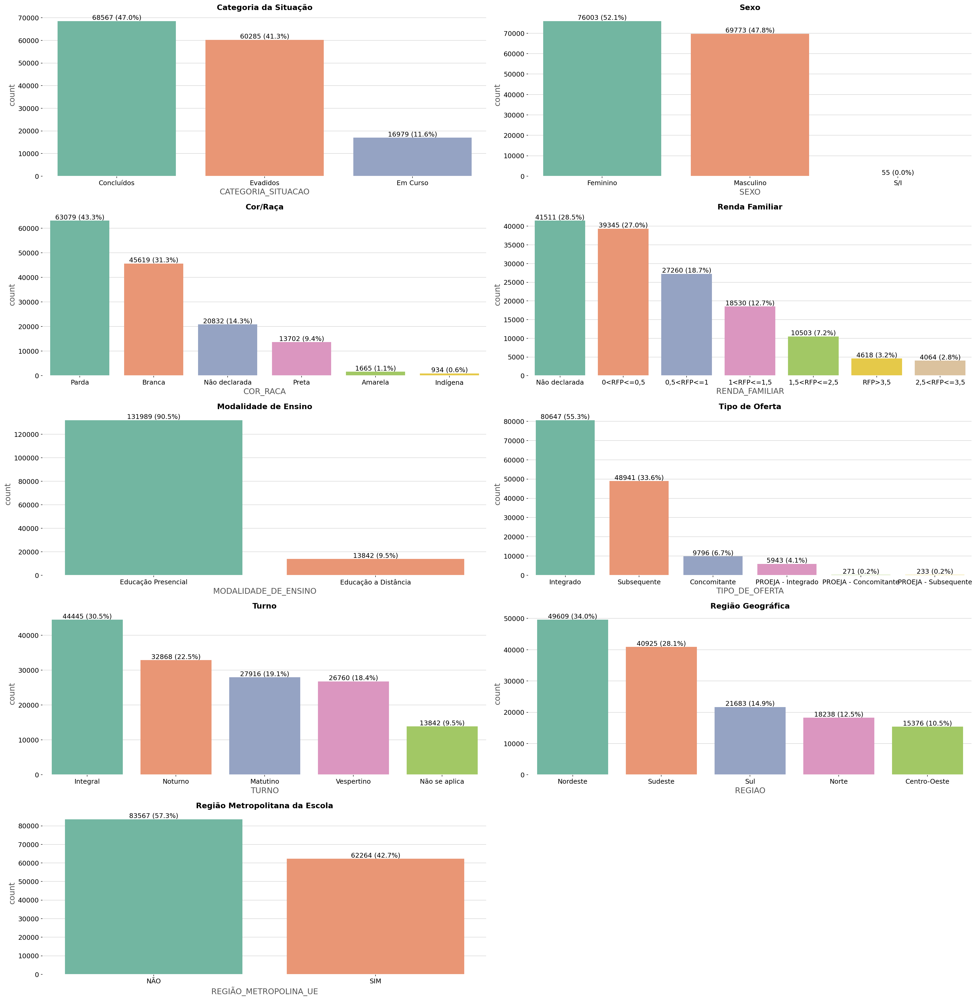

In [17]:
# Função para adicionar valores absolutos e percentuais
def add_count_and_percentage(ax, total):
    for p in ax.patches:
        count = int(p.get_height())  # Valor absoluto
        percentage = f'({100 * count / total:.1f}%)'  # Valor percentual
        x = p.get_x() + p.get_width() / 2  # Posição no eixo x
        y = p.get_height()  # Posição no eixo y
        ax.annotate(f'{count} {percentage}', (x, y), ha='center', va='bottom', fontsize=12)

# Gerar gráficos
plt.figure(figsize=(25, 45))

# Lista de variáveis e títulos
variables = [
    ('CATEGORIA_SITUACAO', 'Categoria da Situação'),
    ('SEXO', 'Sexo'),
    ('COR_RACA', 'Cor/Raça'),
    ('RENDA_FAMILIAR', 'Renda Familiar'),
    ('MODALIDADE_DE_ENSINO', 'Modalidade de Ensino'),
    ('TIPO_DE_OFERTA', 'Tipo de Oferta'),
    ('TURNO', 'Turno'),
    ('REGIAO', 'Região Geográfica'),
    ('REGIÃO_METROPOLINA_UE', 'Região Metropolitana da Escola')
]

# Loop para criar os subgráficos
for i, (var, title) in enumerate(variables, 1):
    plt.subplot(9, 2, i)
    plt.gca().set_title(title, fontsize=14, fontweight='bold')
    ax = sns.countplot(
        x=var, 
        data=df,
        palette=color_palette, 
        # palette=color_palette, 
        order=df[var].value_counts().index
    )
    add_count_and_percentage(ax, len(df[var]))

# Ajustar layout
plt.tight_layout()
plt.show()


Insight:
- Foram apresentados os valores presentes no dataset para nove (9) variáveis categóricas.Observa-se que a variável presentar a maior variação entre a oferta presencial (92%) e a oferta realizada no modalidade à distância (8%).

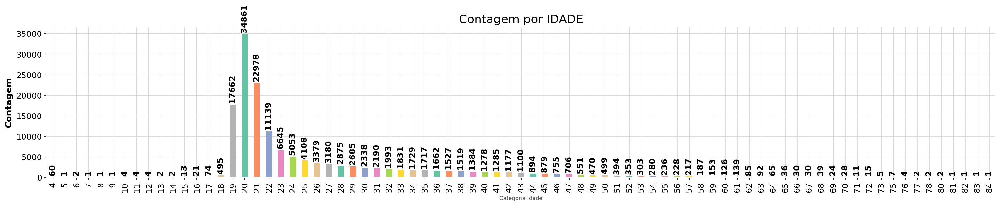

In [22]:
# Gráfico de distruição da varíavel idade
contagem = df['IDADE'].value_counts().sort_index()  # Sem normalizar

# Gerando o gráfico de barras
plt.figure(figsize=(25, 4))
contagem.plot(kind='bar', color=color_palette)
plt.title('Contagem por IDADE')
plt.xlabel('Categoria Idade', fontsize=8)
plt.ylabel('Contagem', fontsize=13, fontweight='bold', ha='center', color='black')

# Adicionando os valores absolutos acima das barras
for i, valor in enumerate(contagem):
    plt.text(i, valor, f' {valor}', fontsize=12, fontweight='bold', ha='center', rotation='vertical', color='black')

plt.show()

Insight:
- Ao observar os valores podemos afirmar há outliers na variável idade. Visto que, Para realizar cursos técnicos nos Brasil o aluno deve ter completado pelo menos o ensino fundamental, no caso do curso técnico ofertado na modalidade integral. Ou seja, a partir dos 14 anos. Logo, será aplicado tratamento nos valores inferiores a 14 anos e superiores a 100 anos.

Insights gerado pelo ChatGPT:

In [26]:
# Configuração da chave de API
from dotenv import load_dotenv
load_dotenv()
openai.api_key = os.getenv("OPENAI_API_KEY")

# Enviar dados para GPT e obter insights
def gerar_insight(dados, descricao_grafico):
    prompt = f"""
    Analise o seguinte conjunto de dados e o gráfico descrito:
    Dados: {dados}
    Descrição do gráfico: {descricao_grafico}
    Forneça cinco insights relevantes.
    """
    response = openai.ChatCompletion.create(
        model="gpt-4o-mini",
        messages=[{"role": "system", "content": "Você é um analista de dados."},
                  {"role": "user", "content": prompt}],
        temperature=0.7,
        max_tokens=500  # Limite o tamanho da resposta
    )
    return response['choices'][0]['message']['content']

# Exemplo de uso
descricao = "O gráfico apresenta a distribuição de valores por categoria."
insight = gerar_insight(df['IDADE'].head(10000).to_dict(), descricao)
print("Insight do GPT:")
print(insight)

Insight do GPT:
Com base no conjunto de dados fornecido, aqui estão cinco insights relevantes:

1. **Distribuição de Valores**: A maioria dos valores no conjunto de dados está concentrada em torno de 22 a 27, com picos em 22, 23 e 24. Isso indica que a distribuição é relativamente uniforme, com um número significativo de observações em torno das categorias centrais.

2. **Outliers e Anomalias**: Existem alguns valores outliers notáveis, como 62 e 68, que se destacam consideravelmente em comparação com os valores mais frequentes. Esses outliers podem indicar eventos especiais ou anomalias nos dados que merecem uma investigação mais profunda.

3. **Tendência Geral**: O padrão geral sugere que a maioria das observações se mantém em um intervalo baixo (entre 20 e 30), com uma frequência crescente para valores próximos a 25. Isso pode apontar para uma normalidade nos dados, indicando que a maioria das categorias opera em um nível esperado.

4. **Valores Altos em Intervalos Específicos**: Po

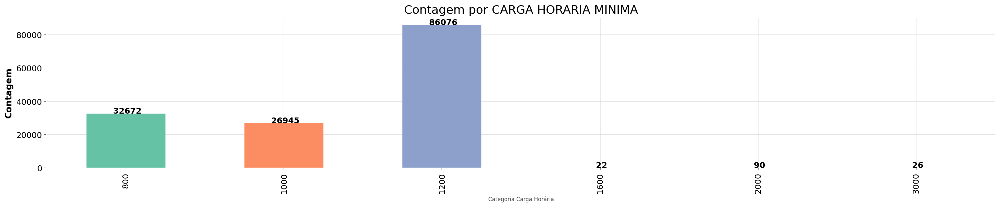

In [25]:
# Gráfico de distruição da varíavel Carga horária mínima dos cursos técnicos
contagem = df['CARGA_HORARIA_MINIMA'].value_counts().sort_index()  # Sem normalizar

# Gerando o gráfico de barras
plt.figure(figsize=(25, 4))
contagem.plot(kind='bar', color=color_palette)
plt.title('Contagem por CARGA HORARIA MINIMA')
plt.xlabel('Categoria Carga Horária', fontsize=8)
plt.ylabel('Contagem', fontsize=13, fontweight='bold', ha='center', color='black')

# Adicionando os valores absolutos acima das barras
for i, valor in enumerate(contagem):
    plt.text(i, valor, f' {valor}', fontsize=12, fontweight='bold', ha='center', color='black')

plt.show()

Insights gerado pelo ChatGPT:

In [ ]:
# Configuração da chave de API
from dotenv import load_dotenv
load_dotenv()
openai.api_key = os.getenv("OPENAI_API_KEY")

# Enviar dados para GPT e obter insights
def gerar_insight(dados, descricao_grafico):
    prompt = f"""
    Analise o seguinte conjunto de dados e o gráfico descrito:
    Dados: {dados}
    Descrição do gráfico: {descricao_grafico}
    Forneça cinco insights relevantes.
    """
    # Forneça cinco insights relevantes, como tendências, padrões ou anomalias.
    response = openai.ChatCompletion.create(
        model="gpt-4o-mini",
        messages=[{"role": "system", "content": "Você é um analista de dados."},
                  {"role": "user", "content": prompt}],
        temperature=0.7,
        max_tokens=500  # Limite o tamanho da resposta
    )
    return response['choices'][0]['message']['content']

# Exemplo de uso
descricao = "O gráfico apresenta a distribuição de valores por categoria."
insight = gerar_insight(df['CARGA_HORARIA_MINIMA'].head(10000).to_dict(), descricao)
print("Insight do GPT:")
print(insight)

Insight
- Ao observar os valores podemos afirmar a variável carga horaria miníma apresenta outliers. Visto que, os cursos técnicos apresentam carga horária entre 800 e 1200 horas-aula. Porém, os valores existem, visto que, cursos técnicos podem ter carga horária mínimas definidas pelo Ministério da Educação.

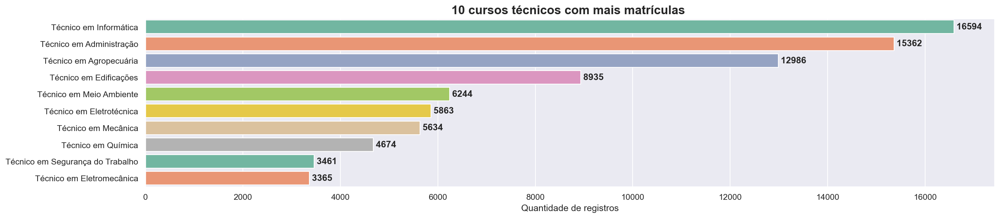

In [27]:
# Gráficos de distribuição da variável - Nome do curso
sns.set(rc={'figure.figsize': (20, 4)})
ax = sns.countplot(
    y='NOME_DE_CURSO', 
    data=df, 
    order=df['NOME_DE_CURSO'].value_counts().head(10).index, 
    palette=color_palette
)

# Adicionando os valores absolutos às barras
valores = df['NOME_DE_CURSO'].value_counts().head(10).values
for container, valor in zip(ax.patches, valores):
    x = container.get_width()  # Largura da barra (quantidade de registros)
    y = container.get_y() + container.get_height() / 2  # Posição vertical
    ax.annotate(f' {valor}', (x, y), ha='left', va='center', fontsize=12, fontweight='bold')

plt.title('10 cursos técnicos com mais matrículas ', fontsize=16, fontweight='bold')
plt.xlabel('Quantidade de registros', fontsize=12)
plt.ylabel('')
plt.show()

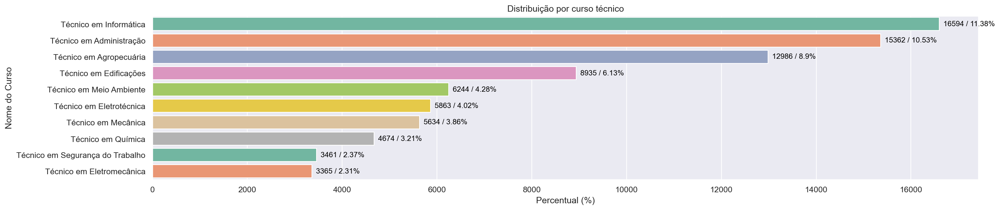

In [28]:
# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df['NOME_DE_CURSO'].value_counts(normalize=True).head(10) * 100).round(2)
# Criando o gráfico
ax = sns.countplot(
    y='NOME_DE_CURSO',
    data=df,
    order=percentuais.index,
    palette=color_palette
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df['NOME_DE_CURSO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por curso técnico')
plt.xlabel('Percentual (%)')
plt.ylabel('Nome do Curso')
plt.show()

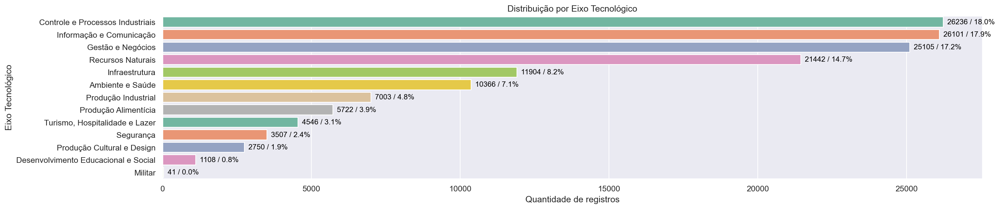

In [29]:
# Função para adicionar valores absolutos e percentuais ao gráfico
def add_values_to_barh(ax, values, percentuais):
    for i, (count, p) in enumerate(zip(values, percentuais)):
        ax.text(
            count,  # Posição x
            i,  # Posição y
            f'  {count} / {p:.1f}%',  # Texto com valor absoluto e percentual
            color='black',
            va='center',
            fontsize=10
        )

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 4)})
df_sorted = df['EIXO_TECNOLOGICO'].value_counts()

# Gráfico de barras horizontais
ax = sns.barplot(
    x=df_sorted.values, 
    y=df_sorted.index, 
    palette=color_palette

)

# Adicionando os valores e percentuais
total = len(df['EIXO_TECNOLOGICO'])
percentuais = (df_sorted / total * 100).round(1)
add_values_to_barh(ax, df_sorted.values, percentuais)

# Configuração de títulos e rótulos
plt.title('Distribuição por Eixo Tecnológico')
plt.xlabel('Quantidade de registros', fontsize=12)
plt.ylabel('Eixo Tecnológico', fontsize=12)
plt.show()

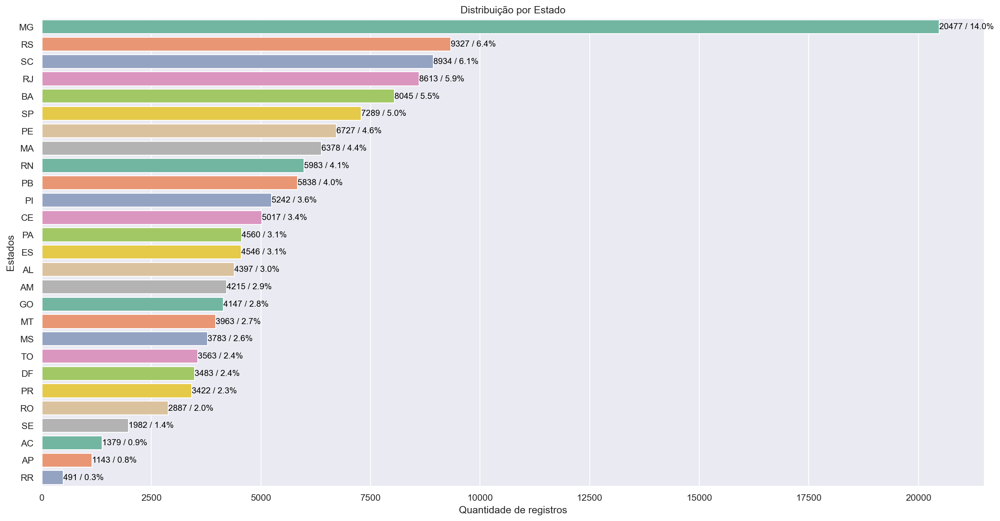

In [30]:
# Função para adicionar valores absolutos e percentuais no gráfico
def add_values_to_barh(ax, counts, percentuais):
    for i, (count, perc) in enumerate(zip(counts, percentuais)):
        ax.text(
            count,  # Posição x
            i,  # Posição y
            f'{count} / {perc:.1f}%',  # Texto com valor absoluto e percentual
            color='black',
            va='center',
            fontsize=10
        )

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 10)})
df_sorted = df['UF'].value_counts()

# Gráfico horizontal de contagem
ax = sns.barplot(
    x=df_sorted.values,
    y=df_sorted.index,
    palette=color_palette
)

# Adicionando valores absolutos e percentuais
total = len(df['UF'])
percentuais = (df_sorted / total * 100).round(1)
add_values_to_barh(ax, df_sorted.values, percentuais)

# Ajustando título e rótulos
plt.title('Distribuição por Estado')
plt.xlabel('Quantidade de registros', fontsize=12)
plt.ylabel('Estados', fontsize=12)
plt.show()

Insights gerado pelo ChatGPT:

In [31]:
# Configuração da chave de API
from dotenv import load_dotenv
load_dotenv()
openai.api_key = os.getenv("OPENAI_API_KEY")

# Enviar dados para GPT e obter insights
def gerar_insight(dados, descricao_grafico):
    prompt = f"""
    Analise o seguinte conjunto de dados e o gráfico descrito:
    Dados: {dados}
    Descrição do gráfico: {descricao_grafico}
    Forneça cinco insights relevantes.
    """
    # Forneça cinco insights relevantes, como tendências, padrões ou anomalias.
    response = openai.ChatCompletion.create(
        model="gpt-4o-mini",
        messages=[{"role": "system", "content": "Você é um analista de dados."},
                  {"role": "user", "content": prompt}],
        temperature=0.7,
        max_tokens=500  # Limite o tamanho da resposta
    )
    return response['choices'][0]['message']['content']

# Exemplo de uso
descricao = "O gráfico apresenta a distribuição de valores por categoria."
insight = gerar_insight(df['UF'].head(10000).to_dict(), descricao)
print("Insight do GPT:")
print(insight)

Insight do GPT:
Com base no conjunto de dados fornecido, que contém informações relacionadas a estados brasileiros, e considerando a descrição do gráfico que indica a distribuição de valores por categoria, aqui estão cinco insights relevantes:

1. **Predomínio do Estado do Rio de Janeiro (RJ)**:
   - O estado do Rio de Janeiro é o que aparece com maior frequência no conjunto de dados, indicando uma significativa predominância em relação aos outros estados. Isso pode sugerir uma concentração de dados ou eventos que merecem uma análise mais aprofundada para entender as razões por trás dessa alta representatividade.

2. **Diversidade de Estados Representados**:
   - O conjunto de dados inclui uma variedade de estados brasileiros, como São Paulo (SP), Rio Grande do Sul (RS), Alagoas (AL), e Pernambuco (PE). Essa diversidade pode indicar que os dados coletados estão relacionados a eventos que abrangem várias regiões, permitindo comparações regionais e insights sobre tendências específicas d

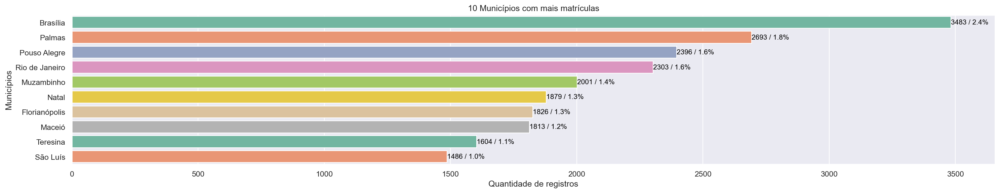

In [32]:
# Função para adicionar valores absolutos e percentuais ao gráfico
def add_values_to_barh(ax, counts, percentuais):
    for i, (count, perc) in enumerate(zip(counts, percentuais)):
        ax.text(
            count,  # Posição x
            i,  # Posição y
            f'{count} / {perc:.1f}%',  # Texto com valor absoluto e percentual
            color='black',
            va='center',
            fontsize=10
        )

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Selecionando os 10 municípios com mais matrículas
df_sorted = df['MUNICIPIO'].value_counts().head(10)

# Criando o gráfico horizontal de contagem
ax = sns.barplot(
    x=df_sorted.values, 
    y=df_sorted.index, 
    palette=color_palette
)

# Adicionando valores absolutos e percentuais
total = df['MUNICIPIO'].value_counts().sum()  # Soma total das matrículas
percentuais = (df_sorted / total * 100).round(1)
add_values_to_barh(ax, df_sorted.values, percentuais)

# Ajustando título e rótulos
plt.title('10 Municípios com mais matrículas')
plt.xlabel('Quantidade de registros', fontsize=12)
plt.ylabel('Municípios', fontsize=12)
plt.tight_layout()
plt.show()

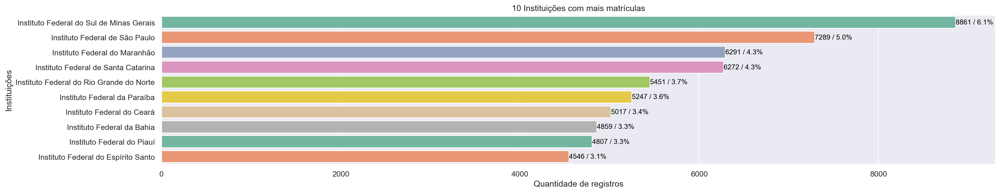

In [33]:
# Função para adicionar valores absolutos e percentuais ao gráfico
def add_values_to_barh(ax, counts, percentuais):
    for i, (count, perc) in enumerate(zip(counts, percentuais)):
        ax.text(
            count,  # Posição x
            i,  # Posição y
            f'{count} / {perc:.1f}%',  # Texto com valor absoluto e percentual
            color='black',
            va='center',
            fontsize=10
        )

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Selecionando as 10 instituições com mais matrículas
df_sorted = df['INSTITUICAO'].value_counts().head(10)

# Criando o gráfico horizontal de contagem
ax = sns.barplot(
    x=df_sorted.values, 
    y=df_sorted.index, 
     palette=color_palette
)

# Adicionando valores absolutos e percentuais
total = df['INSTITUICAO'].value_counts().sum()  # Soma total de matrículas
percentuais = (df_sorted / total * 100).round(1)
add_values_to_barh(ax, df_sorted.values, percentuais)

# Ajustando título e rótulos
plt.title('10 Instituições com mais matrículas')
plt.xlabel('Quantidade de registros', fontsize=12)
plt.ylabel('Instituições', fontsize=12)
plt.tight_layout()
plt.show()

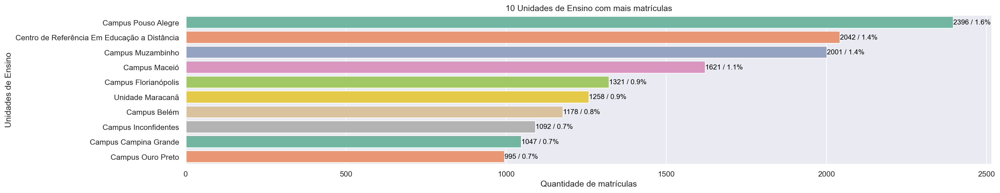

In [34]:
# Função para adicionar valores absolutos e percentuais ao gráfico
def add_values_to_barh(ax, counts, percentuais):
    for i, (count, perc) in enumerate(zip(counts, percentuais)):
        ax.text(
            count,  # Posição x
            i,  # Posição y
            f'{count} / {perc:.1f}%',  # Texto com valor absoluto e percentual
            color='black',
            va='center',
            fontsize=10
        )

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Ordenação das 10 unidades de ensino com mais matrículas
df_sorted = df['UNIDADE_DE_ENSINO'].value_counts().head(10)

# Gráfico de barras horizontal
ax = sns.barplot(
    x=df_sorted.values, 
    y=df_sorted.index, 
    palette=color_palette
)

# Cálculo de percentuais
total = df['UNIDADE_DE_ENSINO'].value_counts().sum()
percentuais = (df_sorted / total * 100).round(1)

# Adicionando valores absolutos e percentuais ao gráfico
add_values_to_barh(ax, df_sorted.values, percentuais)

# Ajustando títulos e rótulos
plt.title('10 Unidades de Ensino com mais matrículas')
plt.xlabel('Quantidade de matrículas', fontsize=12)
plt.ylabel('Unidades de Ensino', fontsize=12)
plt.tight_layout()
plt.show()

Insight
- Os valores foram apresentados considerando as 10 maiores ocorrências de cada variável. 

### 2.5 Identificando outliers

- A análise foi aplicado nas variáveis numéricas. Portanto, Idade e Carga horária mínina do curso ofertado.

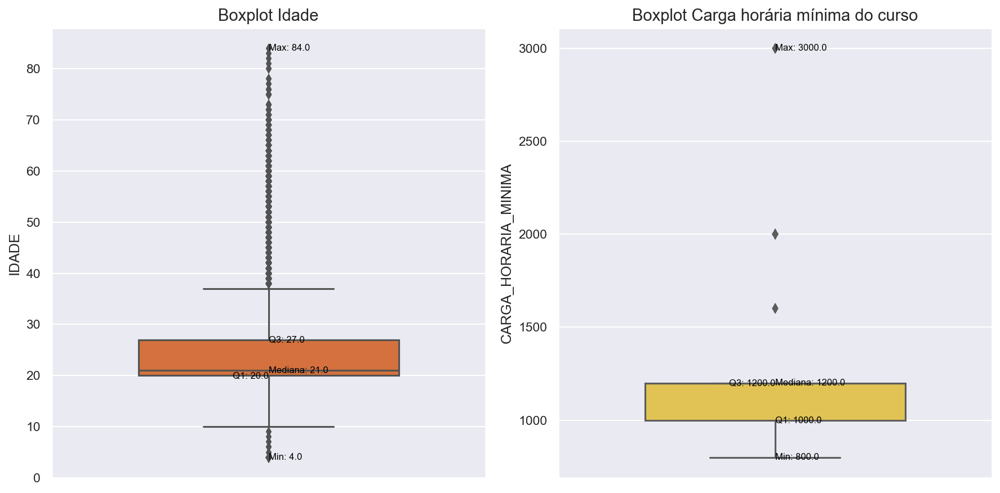

In [35]:
# Tamanho da figura otimizado
plt.figure(figsize=(12, 6))

# Boxplot de Idade
plt.subplot(1, 2, 1)
sns.boxplot(y="IDADE", data=df, color='#ed6925', width=0.6)
plt.title("Boxplot Idade", fontdict={'fontsize': 14})

# Calcula valores estatísticos para Idade
idade_stats = df['IDADE'].describe()
plt.text(0, idade_stats['50%'], f"Mediana: {idade_stats['50%']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, idade_stats['25%'], f"Q1: {idade_stats['25%']:.1f}",
         color="black", ha="right", va="center", fontsize=8)
plt.text(0, idade_stats['75%'], f"Q3: {idade_stats['75%']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, idade_stats['min'], f"Min: {idade_stats['min']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, idade_stats['max'], f"Max: {idade_stats['max']:.1f}",
         color="black", ha="left", va="center", fontsize=8)

# Boxplot de Carga Horária Mínima
plt.subplot(1, 2, 2)
sns.boxplot(y="CARGA_HORARIA_MINIMA", data=df, color='#f7d13d', width=0.6)
plt.title("Boxplot Carga horária mínima do curso", fontdict={'fontsize': 14})

# Calcula valores estatísticos para Carga Horária Mínima
carga_stats = df['CARGA_HORARIA_MINIMA'].describe()
plt.text(0, carga_stats['50%'], f"Mediana: {carga_stats['50%']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, carga_stats['25%'], f"Q1: {carga_stats['25%']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, carga_stats['75%'], f"Q3: {carga_stats['75%']:.1f}",
         color="black", ha="right", va="center", fontsize=8)
plt.text(0, carga_stats['min'], f"Min: {carga_stats['min']:.1f}",
         color="black", ha="left", va="center", fontsize=8)
plt.text(0, carga_stats['max'], f"Max: {carga_stats['max']:.1f}",
         color="black", ha="left", va="center", fontsize=8)

plt.tight_layout()
plt.show()


In [36]:
# Bolxplot de distribuição
fig = px.box(df, x=df["CATEGORIA_SITUACAO"], y=df["IDADE"], color=df["SEXO"])
fig.show()

Insight
- Ao observar os valores podemos afirmar que apenas aplica-se tratamento dos outliers na variável idade. Visto que, Para realizar cursso técnicos nos Brasil o aluno deve ter completado pelo menos o ensino fundamental, no caso do curso técnico ofertado na modalidade integral. Ou seja, a partir dos 14 anos. Logo, será aplicado tratamento nos valores inferiores a 14 anos e superiores a 100 anos.
- Quanto a variavel Carga horária mínina do curso, os cursos técnicos no Brasil tem apenas a definição de carga horária mínina da oferta. Logo, cursos podem ter diversas cargas horária superiores a esse valor.

### 2.6 Análise da distribuição dos dados (Variável = CATEGORIA_SITUACAO)

Será utilizado todo o conjunto de dados, com todas as características para usar o parâmetro 'hue' do seaborn em visualizações.

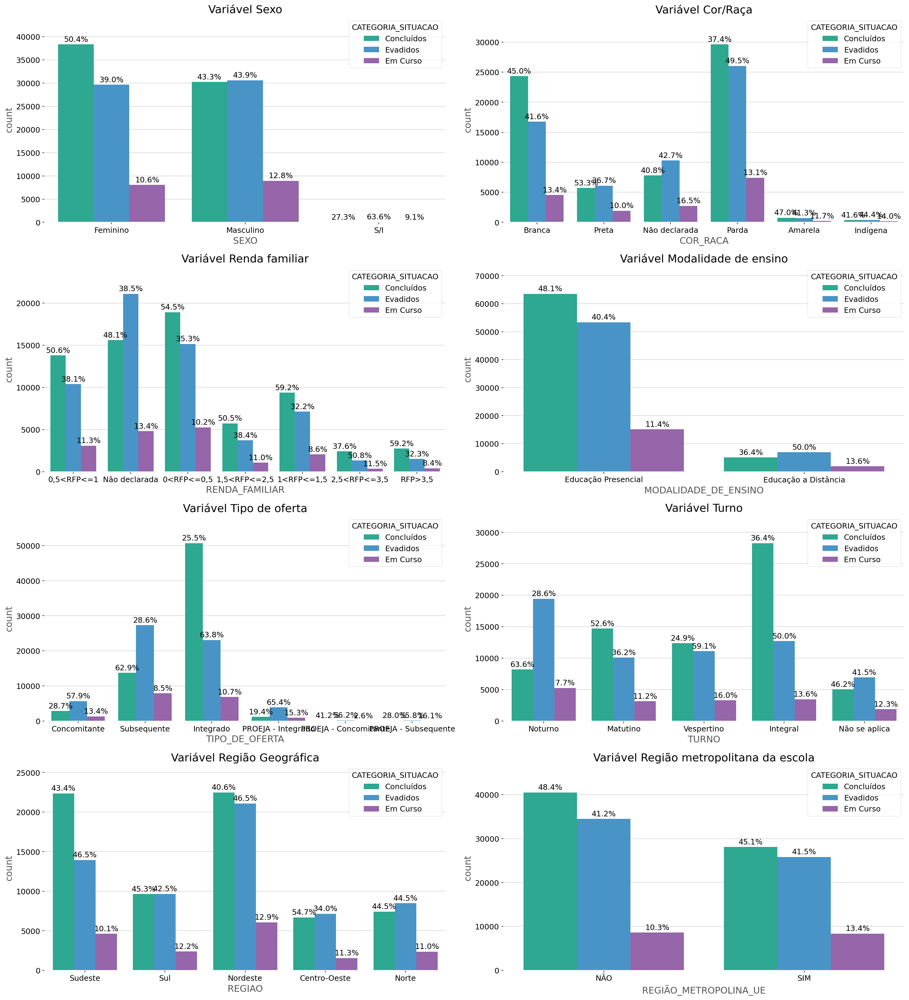

In [32]:
def add_percentage_by_group(ax, df, x, hue):
    counts = df.groupby([x, hue]).size().unstack(fill_value=0)
    
    percentages = counts.apply(lambda c: c / c.sum() * 100, axis=1)
    

    hue_order = ax.legend_.get_texts()
    hue_labels = [t.get_text() for t in hue_order]
    
    for i, c in enumerate(ax.containers):
        labels = []
        for j, v in enumerate(c):
            height = v.get_height()
            if height > 0:
                try:
                    percentage = percentages.iloc[j, percentages.columns.get_loc(hue_labels[i])]
                except KeyError:
                    percentage = percentages.iloc[j, i]
                labels.append(f'{percentage:.1f}%')
            else:
                labels.append('')
        ax.bar_label(c, labels=labels, label_type='edge', padding=2)

    plt.tight_layout()
    ax.set_ylim(0, ax.get_ylim()[1] * 1.1)  

color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]


plt.figure(figsize=(20, 45))
# plt.suptitle("Analysis Of Variable target (CATEGORIA_SITUACAO)", fontweight="bold", fontsize=20)

plt.subplot(8, 2, 1)
plt.gca().set_title('Variável Sexo')
ax1 = sns.countplot(x='SEXO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax1, df, 'SEXO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 2)
plt.gca().set_title('Variável Cor/Raça')
ax2 = sns.countplot(x='COR_RACA', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax2, df, 'COR_RACA', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 3)
plt.gca().set_title('Variável Renda familiar')
ax3 = sns.countplot(x='RENDA_FAMILIAR', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax3, df, 'RENDA_FAMILIAR', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 4)
plt.gca().set_title('Variável Modalidade de ensino')
ax4 = sns.countplot(x='MODALIDADE_DE_ENSINO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax4, df, 'MODALIDADE_DE_ENSINO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 5)
plt.gca().set_title('Variável Tipo de oferta')
ax5 = sns.countplot(x='TIPO_DE_OFERTA', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax5, df, 'TIPO_DE_OFERTA', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 6)
plt.gca().set_title('Variável Turno')
ax6 = sns.countplot(x='TURNO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax6, df, 'TURNO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 7)
plt.gca().set_title('Variável Região Geográfica')
ax8 = sns.countplot(x='REGIAO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax8, df, 'REGIAO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 8)
plt.gca().set_title('Variável Região metropolitana da escola')
ax9 = sns.countplot(x='REGIÃO_METROPOLINA_UE', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax9, df, 'REGIÃO_METROPOLINA_UE', 'CATEGORIA_SITUACAO')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

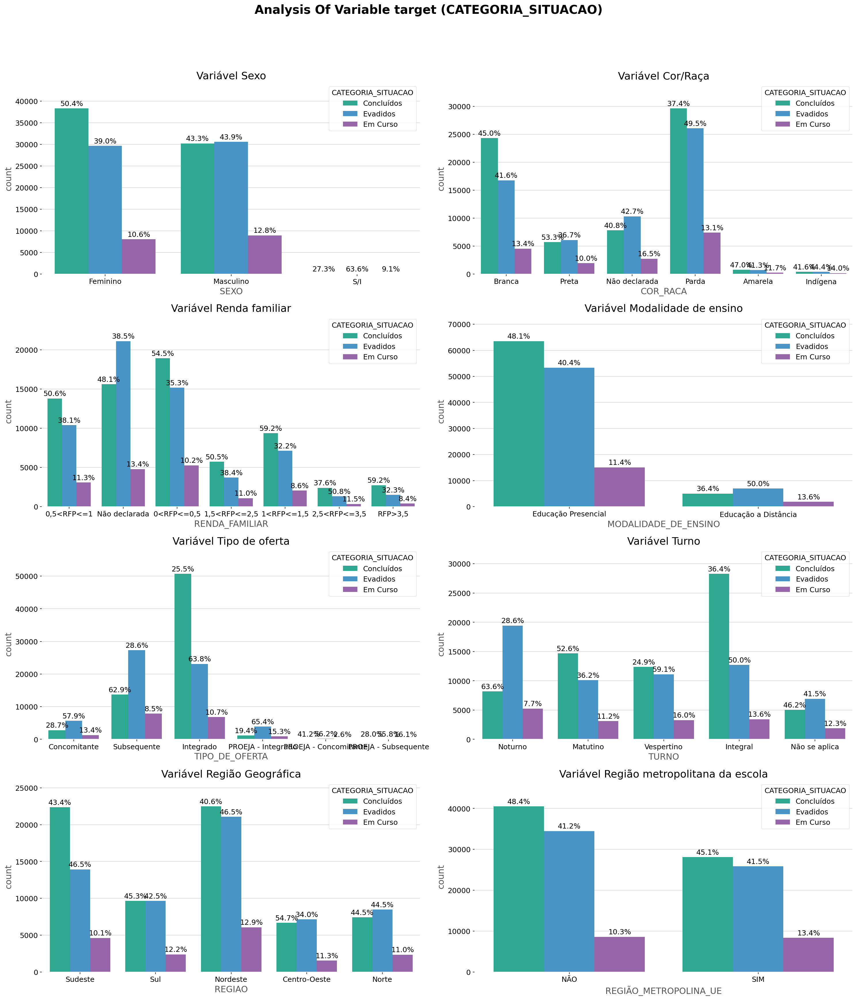

In [31]:
def add_total_percentage_label(ax, df, x, hue):
    # Calcula contagens
    counts = df.groupby([x, hue]).size().unstack(fill_value=0)
    
    # Calcula totais e percentuais por grupo (x)
    total_counts = counts.sum(axis=1)
    percentage_totals = (counts.T / total_counts).T * 100  # Percentuais por grupo
    
    # Posição X das barras (categorias de x)
    positions = range(len(counts))

    # Exibir um label por grupo com a soma das proporções (só como exemplo: soma de todas = 100%)
    for i, (idx, row) in enumerate(percentage_totals.iterrows()):
        y_pos = sum([p.get_height() for p in ax.containers[0][i:len(ax.containers)][0]])  # Altura total
        ax.text(i, y_pos + 2, '100%', ha='center', va='bottom', fontsize=10, fontweight='bold')

    # Ajuste de layout
    plt.tight_layout()
    ax.set_ylim(0, ax.get_ylim()[1] * 1.1)
    

color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]


plt.figure(figsize=(20, 45))
plt.suptitle("Analysis Of Variable target (CATEGORIA_SITUACAO)", fontweight="bold", fontsize=20)

plt.subplot(8, 2, 1)
plt.gca().set_title('Variável Sexo')
ax1 = sns.countplot(x='SEXO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax1, df, 'SEXO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 2)
plt.gca().set_title('Variável Cor/Raça')
ax2 = sns.countplot(x='COR_RACA', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax2, df, 'COR_RACA', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 3)
plt.gca().set_title('Variável Renda familiar')
ax3 = sns.countplot(x='RENDA_FAMILIAR', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax3, df, 'RENDA_FAMILIAR', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 4)
plt.gca().set_title('Variável Modalidade de ensino')
ax4 = sns.countplot(x='MODALIDADE_DE_ENSINO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax4, df, 'MODALIDADE_DE_ENSINO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 5)
plt.gca().set_title('Variável Tipo de oferta')
ax5 = sns.countplot(x='TIPO_DE_OFERTA', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax5, df, 'TIPO_DE_OFERTA', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 6)
plt.gca().set_title('Variável Turno')
ax6 = sns.countplot(x='TURNO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax6, df, 'TURNO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 7)
plt.gca().set_title('Variável Região Geográfica')
ax8 = sns.countplot(x='REGIAO', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax8, df, 'REGIAO', 'CATEGORIA_SITUACAO')

plt.subplot(8, 2, 8)
plt.gca().set_title('Variável Região metropolitana da escola')
ax9 = sns.countplot(x='REGIÃO_METROPOLINA_UE', hue='CATEGORIA_SITUACAO', palette=color_palette2, data=df)
add_percentage_by_group(ax9, df, 'REGIÃO_METROPOLINA_UE', 'CATEGORIA_SITUACAO')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


<Figure size 3750x600 with 0 Axes>

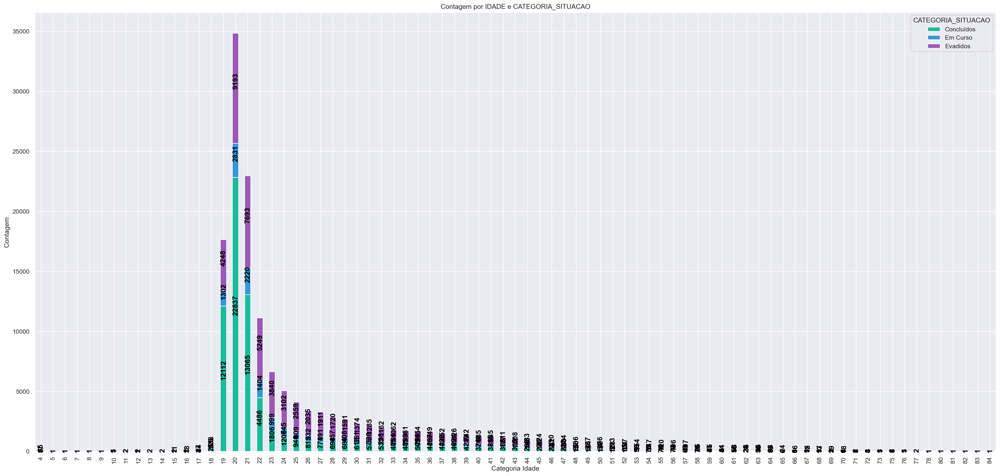

In [40]:
# Agrupando e contando as ocorrências de IDADE por SITUACAO_MATRICULA
contagem = df.groupby(['IDADE', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]


plt.figure(figsize=(25, 4))
contagem.plot(kind='bar', stacked=True, color=color_palette2, figsize=(25, 12))

# Título e rótulos
plt.title('Contagem por IDADE e CATEGORIA_SITUACAO')
plt.xlabel('Categoria Idade')
plt.ylabel('Contagem')

# Adicionando os valores absolutos nas barras empilhadas
for idx, idade in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[idade, situacao]
        if valor > 0:
            plt.text(idx, acumulado + valor / 2, str(valor), fontsize=13, fontweight='bold', ha='center', rotation='vertical',  color='black')
        acumulado += valor

# Ajustar a legenda e layout
plt.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

plt.show()


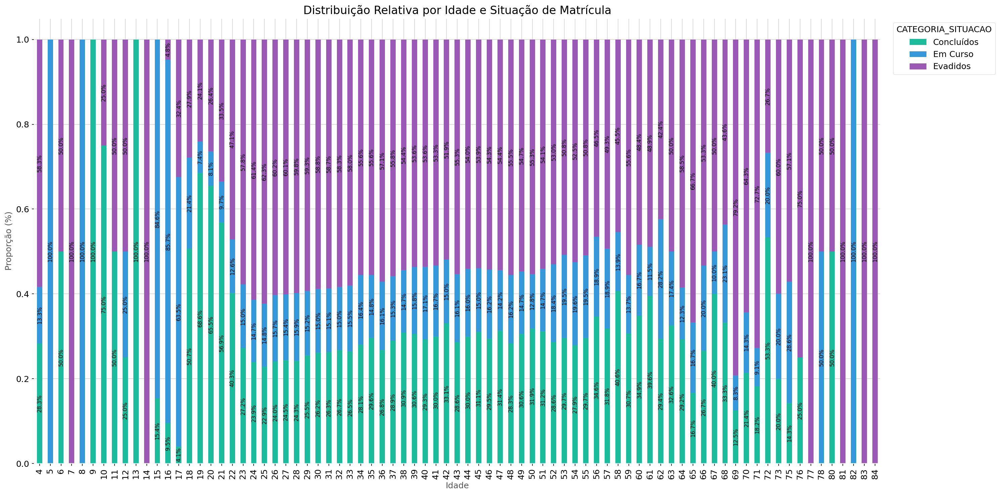

In [30]:
# Agrupando e contando as ocorrências de IDADE por CATEGORIA_SITUACAO
contagem = df.groupby(['IDADE', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os dados pela idade (opcional: manter a ordem natural)
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Mantemos o total original só para ordenação
contagem_relativa = contagem_relativa.sort_index().drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 10))
contagem_relativa.plot(kind='bar', stacked=True, color=color_palette2, ax=ax)

# Título e rótulos
ax.set_title('Distribuição Relativa por Idade e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Idade', fontsize=12)
ax.set_ylabel('Proporção (%)', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for idx, idade in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[idade, situacao]
        if valor > 0.03:  # Exibir apenas valores significativos
            ax.text(idx, acumulado + valor / 2, f"{valor * 100:.1f}%", fontsize=8,
                    va='center', ha='center', rotation=90, color='black')
        acumulado += valor

# Ajustando a legenda e layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibir o gráfico
plt.show()


<Figure size 3750x900 with 0 Axes>

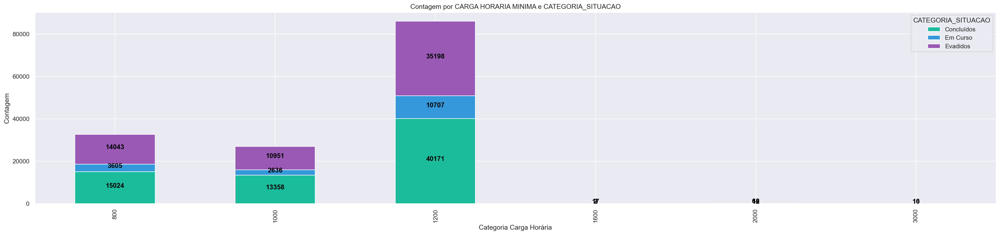

In [41]:
# Agrupando e contando as ocorrências de CARGA_HORARIA_MINIMA por SITUACAO_MATRICULA
contagem = df.groupby(['CARGA_HORARIA_MINIMA', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

plt.figure(figsize=(25, 6))
contagem.plot(kind='bar', stacked=True, color=color_palette2, figsize=(25, 6))

# Título e rótulos
plt.title('Contagem por CARGA HORARIA MINIMA e CATEGORIA_SITUACAO')
plt.xlabel('Categoria Carga Horária')
plt.ylabel('Contagem')

# Adicionando os valores absolutos nas barras empilhadas
for idx, carga_horaria in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[carga_horaria, situacao]
        if valor > 0:
            plt.text(idx, acumulado + valor / 2, str(valor), fontsize=12, fontweight='bold', ha='center', color='black')
        acumulado += valor

# Ajustar a legenda e layout
plt.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

plt.show()


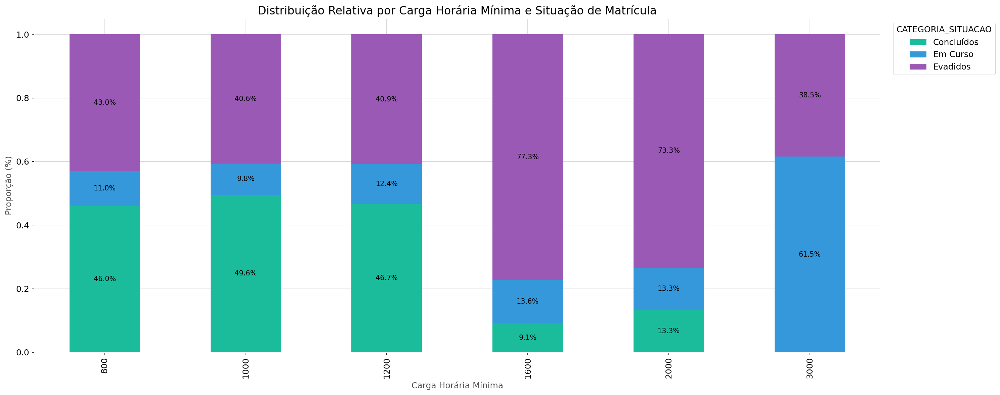

In [14]:
# Agrupando e contando as ocorrências de CARGA_HORARIA_MINIMA por CATEGORIA_SITUACAO
contagem = df.groupby(['CARGA_HORARIA_MINIMA', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os dados por CARGA_HORARIA_MINIMA
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Adiciona coluna total para ordenação, se necessário
contagem_relativa = contagem_relativa.sort_index().drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 8))
contagem_relativa.plot(kind='bar', stacked=True, color=color_palette2, ax=ax)

# Título e rótulos
ax.set_title('Distribuição Relativa por Carga Horária Mínima e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Carga Horária Mínima', fontsize=12)
ax.set_ylabel('Proporção (%)', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for idx, carga in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[carga, situacao]
        if valor > 0.03:  # Exibe apenas se maior que 3%
            ax.text(idx, acumulado + valor / 2, f"{valor * 100:.1f}%", fontsize=10,
                    va='center', ha='center', color='black')
        acumulado += valor

# Ajustar a legenda e layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibir o gráfico
plt.show()


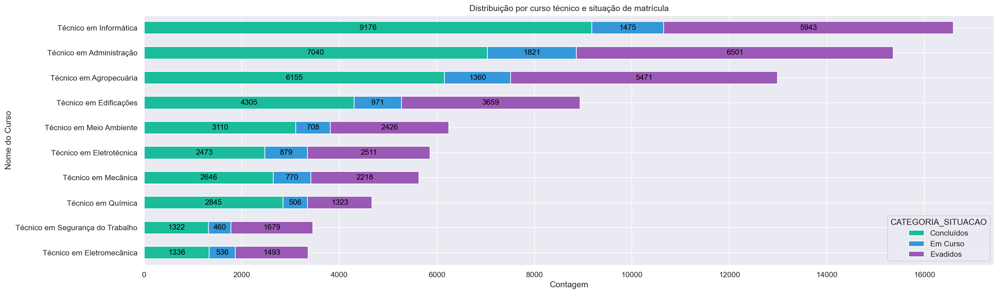

In [42]:
# Filtrando os 10 cursos mais comuns
top_cursos = df['NOME_DE_CURSO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_top_cursos = df[df['NOME_DE_CURSO'].isin(top_cursos)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_top_cursos.groupby(['NOME_DE_CURSO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os cursos pelo total de ocorrências
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]


fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por curso técnico e situação de matrícula')
ax.set_xlabel('Contagem')
ax.set_ylabel('Nome do Curso')

# Adicionando valores absolutos nas barras empilhadas
for i, curso in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[curso, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=11, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()



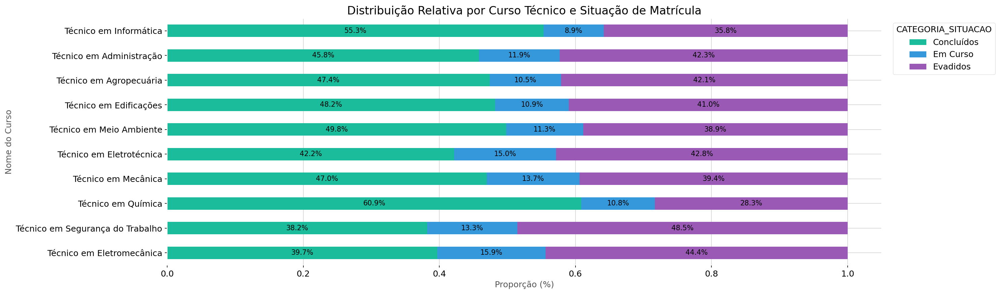

In [23]:
# Filtrando os 10 cursos mais comuns
top_cursos = df['NOME_DE_CURSO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_top_cursos = df[df['NOME_DE_CURSO'].isin(top_cursos)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_top_cursos.groupby(['NOME_DE_CURSO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os cursos pelo total de ocorrências
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Apenas para ordenação
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Título e rótulos
ax.set_title('Distribuição Relativa por Curso Técnico e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Proporção (%)', fontsize=12)
ax.set_ylabel('Nome do Curso', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for i, curso in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[curso, situacao]
        if valor > 0.03:  # Apenas exibe percentuais acima de 3%
            ax.text(acumulado + valor / 2, i, f"{valor * 100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


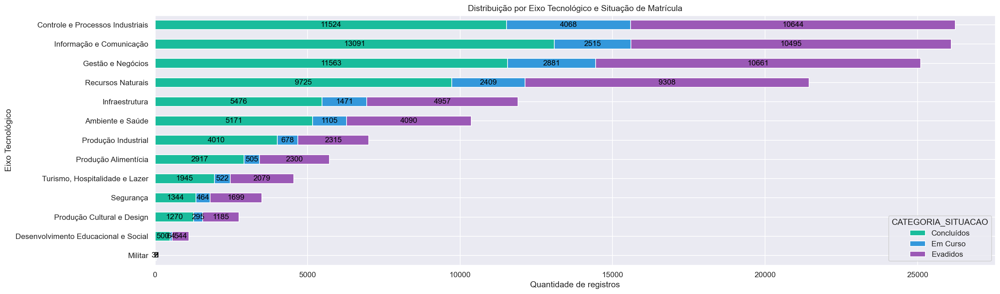

In [43]:
# Agrupando e contando as ocorrências de EIXO_TECNOLOGICO por CATEGORIA_SITUACAO
contagem = df.groupby(['EIXO_TECNOLOGICO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os dados pelo total de ocorrências em cada eixo tecnológico
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por Eixo Tecnológico e Situação de Matrícula')
ax.set_xlabel('Quantidade de registros', fontsize=12)
ax.set_ylabel('Eixo Tecnológico', fontsize=12)

# Adicionando valores absolutos nas barras empilhadas
for i, eixo in enumerate(contagem.index):
    acumulado = 0
    for j, situacao in enumerate(contagem.columns):
        valor = contagem.loc[eixo, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=11, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()



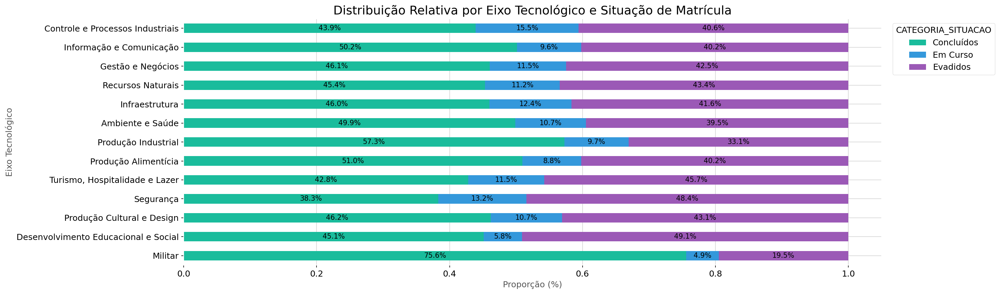

In [15]:
# Agrupando e contando as ocorrências de EIXO_TECNOLOGICO por CATEGORIA_SITUACAO
contagem = df.groupby(['EIXO_TECNOLOGICO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os dados pelo total de ocorrências em cada eixo tecnológico
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Mantemos o total original só para ordenação
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição Relativa por Eixo Tecnológico e Situação de Matrícula')
ax.set_xlabel('Proporção (%)', fontsize=12)
ax.set_ylabel('Eixo Tecnológico', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for i, eixo in enumerate(contagem_relativa.index):
    acumulado = 0
    for j, situacao in enumerate(contagem_relativa.columns):
        valor = contagem_relativa.loc[eixo, situacao]
        if valor > 0.03:  # Evita rótulos muito pequenos
            ax.text(acumulado + valor / 2, i, f"{valor*100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()

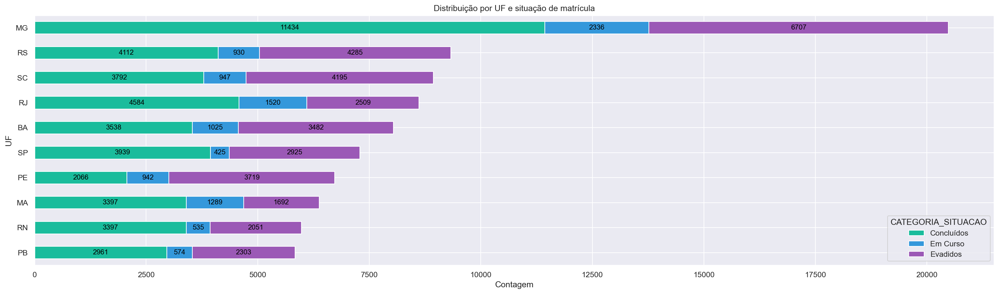

In [45]:
# Filtrando os 10 cursos mais comuns
uf = df['UF'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_uf = df[df['UF'].isin(uf)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_uf.groupby(['UF', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os estados (UF) pelo total de ocorrências
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por UF e situação de matrícula')
ax.set_xlabel('Contagem')
ax.set_ylabel('UF')

# Adicionando valores absolutos nas barras empilhadas
for i, uf in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[uf, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()



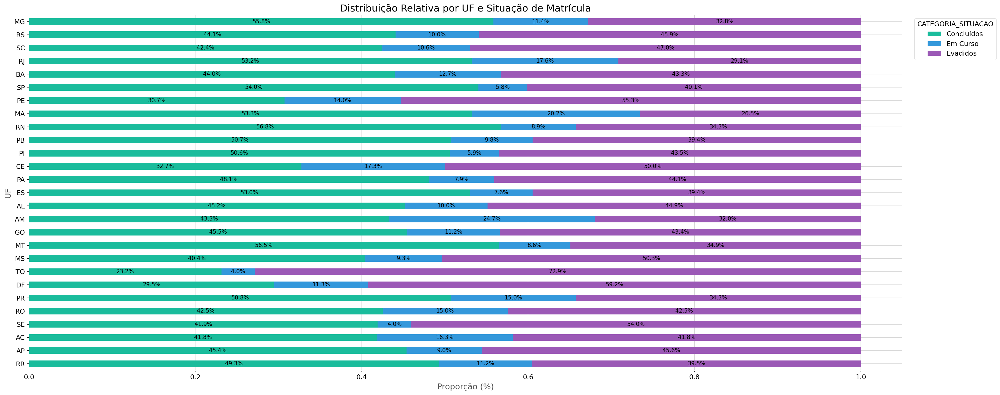

In [28]:
# Filtrando os 10 estados (UF) mais comuns
ufs_mais_comuns = df['UF'].value_counts(normalize=True).head(27).index
df_uf = df[df['UF'].isin(ufs_mais_comuns)]

# Agrupando e contando as ocorrências por UF e situação
contagem = df_uf.groupby(['UF', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Calculando proporções relativas por UF (linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os estados (UF) pelo total de ocorrências (a partir da contagem original)
contagem_relativa['TOTAL'] = contagem.sum(axis=1)
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Paleta de cores
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

# Criando o gráfico
fig, ax = plt.subplots(figsize=(25, 10))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Título e rótulos
ax.set_title('Distribuição Relativa por UF e Situação de Matrícula')
ax.set_xlabel('Proporção (%)')
ax.set_ylabel('UF')

# Adicionando rótulos percentuais nas barras
for i, uf in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[uf, situacao]
        if valor > 0.03:  # Evita rótulos em fatias muito pequenas
            ax.text(acumulado + valor / 2, i, f"{valor*100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Legenda e layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()

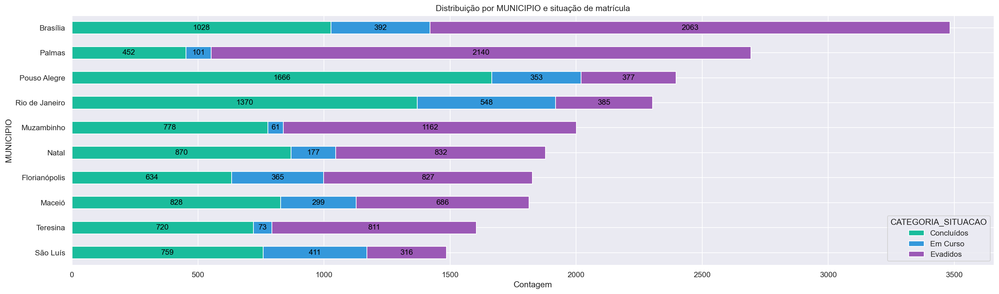

In [47]:
# Filtrando os 10 municipios mais matrículas
top_municipio = df['MUNICIPIO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_top_municipios = df[df['MUNICIPIO'].isin(top_municipio)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_top_municipios.groupby(['MUNICIPIO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os municípios pelo total de ocorrências
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por MUNICIPIO e situação de matrícula')
ax.set_xlabel('Contagem')
ax.set_ylabel('MUNICIPIO')

# Adicionando valores absolutos nas barras empilhadas
for i, municipio in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[municipio, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=11, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


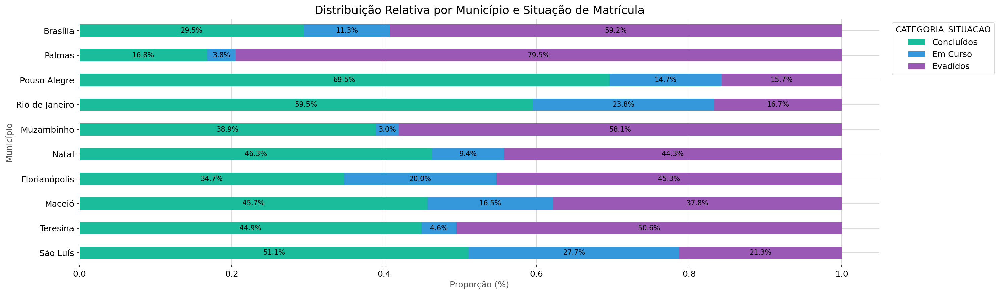

In [24]:
# Filtrando os 10 municípios com mais matrículas
top_municipio = df['MUNICIPIO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os municípios mais comuns
df_top_municipios = df[df['MUNICIPIO'].isin(top_municipio)]

# Agrupando e contando as ocorrências por município e situação de matrícula
contagem = df_top_municipios.groupby(['MUNICIPIO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando os municípios pelo total de ocorrências
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Apenas para ordenação
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição Relativa por Município e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Proporção (%)', fontsize=12)
ax.set_ylabel('Município', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for i, municipio in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[municipio, situacao]
        if valor > 0.03:  # Apenas exibe percentuais acima de 3%
            ax.text(acumulado + valor / 2, i, f"{valor * 100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


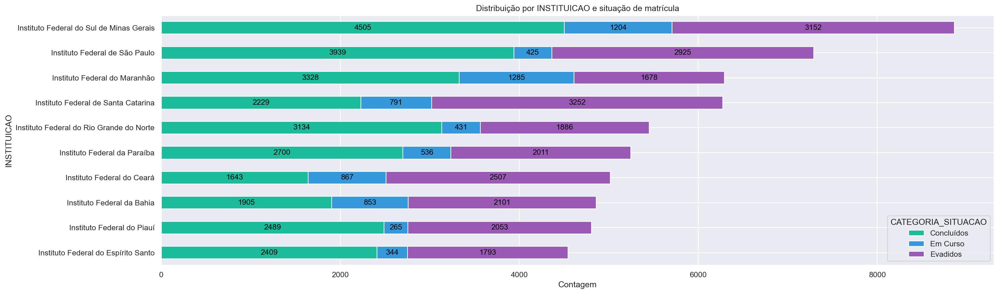

In [48]:
# Filtrando os 10 municipios mais matrículas
top_instituicao = df['INSTITUICAO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_top_instituicoes = df[df['INSTITUICAO'].isin(top_instituicao)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_top_instituicoes.groupby(['INSTITUICAO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os municípios pelo total de ocorrências
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por INSTITUICAO e situação de matrícula')
ax.set_xlabel('Contagem')
ax.set_ylabel('INSTITUICAO')

# Adicionando valores absolutos nas barras empilhadas
for i, municipio in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[municipio, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=11, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


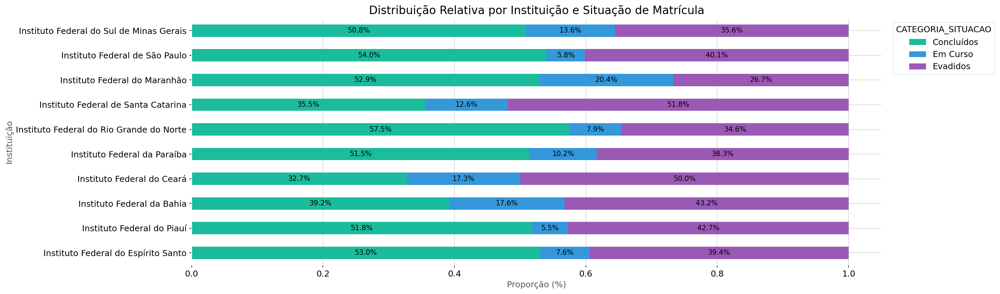

In [25]:
# Filtrando as 10 instituições com mais matrículas
top_instituicao = df['INSTITUICAO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para as instituições mais comuns
df_top_instituicoes = df[df['INSTITUICAO'].isin(top_instituicao)]

# Agrupando e contando as ocorrências por instituição e situação de matrícula
contagem = df_top_instituicoes.groupby(['INSTITUICAO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando as instituições pelo total de ocorrências
contagem_relativa['TOTAL'] = contagem.sum(axis=1)  # Apenas para ordenação
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição Relativa por Instituição e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Proporção (%)', fontsize=12)
ax.set_ylabel('Instituição', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for i, inst in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[inst, situacao]
        if valor > 0.03:  # Exibe percentuais maiores que 3%
            ax.text(acumulado + valor / 2, i, f"{valor * 100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


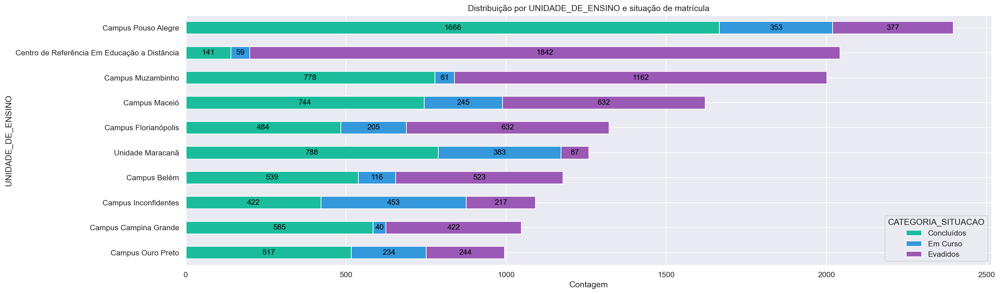

In [49]:
# Filtrando os 10 municipios mais matrículas
top_unidade_ensino = df['UNIDADE_DE_ENSINO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para os cursos mais comuns
df_top_unidades_ensino = df[df['UNIDADE_DE_ENSINO'].isin(top_unidade_ensino)]

# Agrupando e contando as ocorrências por curso e situação de matrícula
contagem = df_top_unidades_ensino.groupby(['UNIDADE_DE_ENSINO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Ordenando os municípios pelo total de ocorrências
contagem['TOTAL'] = contagem.sum(axis=1)
contagem = contagem.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico de barras empilhadas
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição por UNIDADE_DE_ENSINO e situação de matrícula')
ax.set_xlabel('Contagem')
ax.set_ylabel('UNIDADE_DE_ENSINO')

# Adicionando valores absolutos nas barras empilhadas
for i, municipio in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[municipio, situacao]
        if valor > 0:
            ax.text(acumulado + valor / 2, i, str(valor), fontsize=11, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

# Exibindo o gráfico
plt.show()




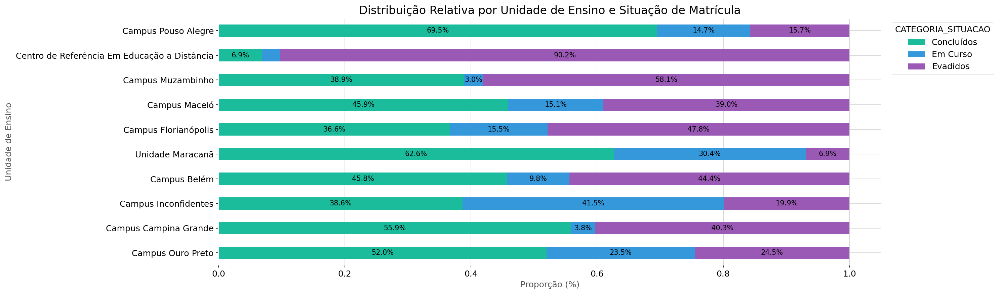

In [29]:
# Filtrando as 10 unidades de ensino com mais matrículas
top_unidade_ensino = df['UNIDADE_DE_ENSINO'].value_counts(normalize=True).head(10).index

# Filtrando o DataFrame para essas unidades
df_top_unidades_ensino = df[df['UNIDADE_DE_ENSINO'].isin(top_unidade_ensino)]

# Agrupando e contando as ocorrências por unidade de ensino e situação de matrícula
contagem = df_top_unidades_ensino.groupby(['UNIDADE_DE_ENSINO', 'CATEGORIA_SITUACAO']).size().unstack(fill_value=0)

# Convertendo os valores para proporções (percentuais por linha)
contagem_relativa = contagem.div(contagem.sum(axis=1), axis=0)

# Ordenando as unidades pelo total de ocorrências
contagem_relativa['TOTAL'] = contagem.sum(axis=1)
contagem_relativa = contagem_relativa.sort_values(by='TOTAL', ascending=True).drop(columns='TOTAL')

# Configurando o gráfico
color_palette2 = ["#1ABC9C", "#3498DB", "#9B59B6", "#E67E22", "#E74C3C"]

fig, ax = plt.subplots(figsize=(20, 6))
contagem_relativa.plot(kind='barh', stacked=True, color=color_palette2, ax=ax)

# Adicionando título e rótulos
ax.set_title('Distribuição Relativa por Unidade de Ensino e Situação de Matrícula', fontsize=16)
ax.set_xlabel('Proporção (%)', fontsize=12)
ax.set_ylabel('Unidade de Ensino', fontsize=12)

# Adicionando valores percentuais nas barras empilhadas
for i, unidade in enumerate(contagem_relativa.index):
    acumulado = 0
    for situacao in contagem_relativa.columns:
        valor = contagem_relativa.loc[unidade, situacao]
        if valor > 0.03:  # Exibe percentuais maiores que 3%
            ax.text(acumulado + valor / 2, i, f"{valor * 100:.1f}%", fontsize=10, va='center', ha='center', color='black')
        acumulado += valor

# Ajustando a legenda e o layout
ax.legend(title='CATEGORIA_SITUACAO', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()

# Exibindo o gráfico
plt.show()


### 2.7 Apresentação da variável alvo (target = EVADIDOS)

In [50]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Contabilizando a quantidade de registros 'Evadidos' por 'SEXO'
sexo_counts = df_evadidos['EIXO_TECNOLOGICO'].value_counts()

# Exibindo a contagem de registros
print(sexo_counts)
print('----------------------')

# Exibindo a contagem como percentual
sexo_percent = df_evadidos['EIXO_TECNOLOGICO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%'
print(sexo_percent)

EIXO_TECNOLOGICO
Gestão e Negócios                       10661
Controle e Processos Industriais        10644
Informação e Comunicação                10495
Recursos Naturais                        9308
Infraestrutura                           4957
Ambiente e Saúde                         4090
Produção Industrial                      2315
Produção Alimentícia                     2300
Turismo, Hospitalidade e Lazer           2079
Segurança                                1699
Produção Cultural e Design               1185
Desenvolvimento Educacional e Social      544
Militar                                     8
Name: count, dtype: int64
----------------------
EIXO_TECNOLOGICO
Gestão e Negócios                       17.7%
Controle e Processos Industriais        17.7%
Informação e Comunicação                17.4%
Recursos Naturais                       15.4%
Infraestrutura                           8.2%
Ambiente e Saúde                         6.8%
Produção Industrial                      3.

#### 2.7.1 Distribuições das Features Categóricas pela Evasão
Será analisado como a taxa de evasão está distribuída entre as diferentes categorias das variáveis categóricas, a fim de avaliar quais categorias apresentam as maiores proporções de evadidos. 

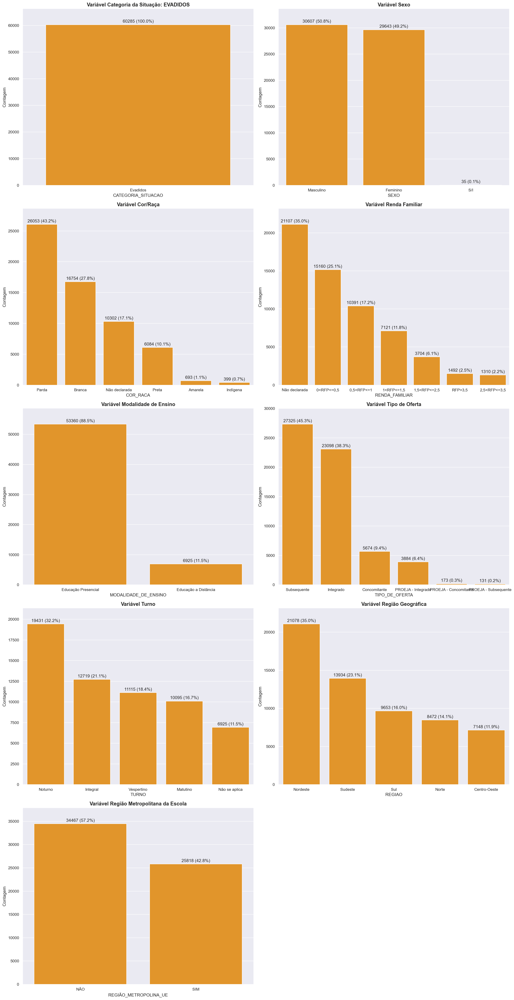

In [55]:
# Função para adicionar porcentagens às barras
def add_percentage(ax, total_count):
    for c in ax.containers:
        labels = [
            f'{v.get_height():.0f} ({(v.get_height() / total_count * 100):.1f}%)' 
            if v.get_height() > 0 else '' 
            for v in c
        ]
        ax.bar_label(c, labels=labels, label_type='edge', padding=3)
    ax.margins(y=0.1)

# Função para plotar gráficos categóricos com título e porcentagens
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"


def plot_categorical_distribution(ax, column, df, title):
    sns.countplot(
        x=column,
        data=df,
        palette=color_palette3,
        order=df[column].value_counts().index,
        ax=ax
    )
    add_percentage(ax, len(df))
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.set_xlabel(column, fontsize=12)
    ax.set_ylabel('Contagem', fontsize=12)

# Filtrando os dados para considerar apenas 'Evadidos' em 'CATEGORIA_SITUACAO'
df_filtered = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Tamanho da figura
plt.figure(figsize=(20, 40))

# Lista de variáveis e títulos
variables = [
    ('CATEGORIA_SITUACAO', 'Variável Categoria da Situação: EVADIDOS'),
    ('SEXO', 'Variável Sexo'),
    ('COR_RACA', 'Variável Cor/Raça'),
    ('RENDA_FAMILIAR', 'Variável Renda Familiar'),
    ('MODALIDADE_DE_ENSINO', 'Variável Modalidade de Ensino'),
    ('TIPO_DE_OFERTA', 'Variável Tipo de Oferta'),
    ('TURNO', 'Variável Turno'),
    ('REGIAO', 'Variável Região Geográfica'),
    ('REGIÃO_METROPOLINA_UE', 'Variável Região Metropolitana da Escola')
]

# Loop para criar os subgráficos
for i, (var, title) in enumerate(variables, 1):
    ax = plt.subplot(5, 2, i)
    plot_categorical_distribution(ax, var, df_filtered, title)
# Adicionando a legenda para 'CATEGORIA_SITUACAO'
    # plt.legend(title='Categoria de Situação', labels=['Evadidos'], loc='upper right')    
# Ajustando o layout e adicionando o título principal
# plt.suptitle("Analysis Of Variable Target (CATEGORIA_SITUACAO == 'Evadidos')", fontsize=20, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Exibindo o gráfico
plt.show()

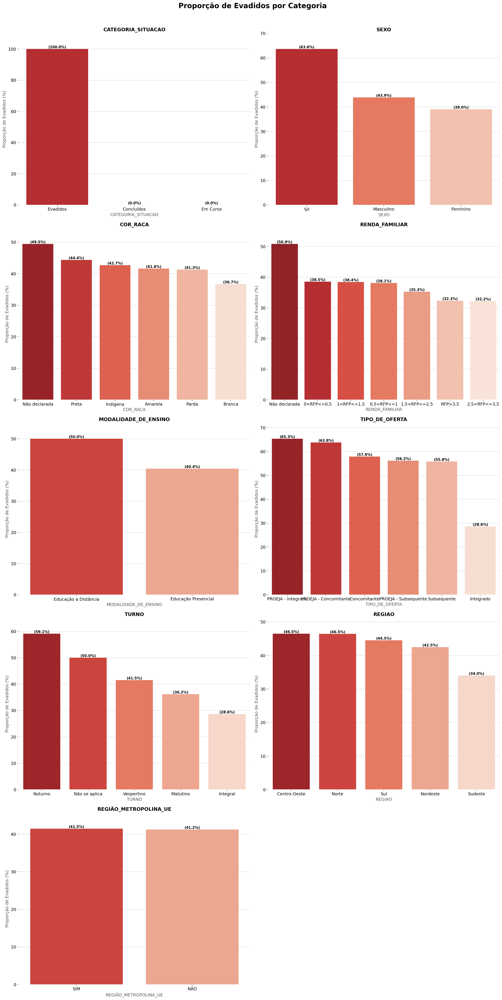

In [13]:
# Função para adicionar porcentagens às barras 
def add_relative_percentage(ax, percentuais):
    for i, bar in enumerate(ax.patches):
        valor = bar.get_height()
        if i < len(percentuais):
            percent = percentuais[i]
            ax.text(
                bar.get_x() + bar.get_width() / 2,
                valor,
                f'({percent:.1f}%)',
                ha='center',
                va='bottom',
                fontsize=10,
                fontweight='bold'
            )
    ax.margins(y=0.1)

# Função para plotar gráficos com proporções relativas
def plot_relative_distribution(ax, column, df):
    # Total por categoria (todas as situações)
    total_cat = df.groupby(column).size()
    # Evadidos por categoria
    evadidos_cat = df[df['CATEGORIA_SITUACAO'] == 'Evadidos'].groupby(column).size()
    # Proporção em %
    proporcao = ((evadidos_cat / total_cat) * 100).fillna(0).sort_values(ascending=False).round(2)
    
    # Plot
    sns.barplot(
        x=proporcao.index,
        y=proporcao.values,
        palette='Reds_r',
        ax=ax
    )
    
    add_relative_percentage(ax, proporcao.values)
    ax.set_title(column, fontsize=14, fontweight='bold')
    ax.set_xlabel(column, fontsize=12)
    ax.set_ylabel('Proporção de Evadidos (%)', fontsize=12)
    ax.tick_params(axis='x')

# Lista de variáveis a serem plotadas
variables = [
    'CATEGORIA_SITUACAO', 
    'SEXO',
    'COR_RACA',
    'RENDA_FAMILIAR',
    'MODALIDADE_DE_ENSINO',
    'TIPO_DE_OFERTA',
    'TURNO',
    'REGIAO',
    'REGIÃO_METROPOLINA_UE'
]

# variables = [
#     ('CATEGORIA_SITUACAO', 'Variável Categoria da Situação: EVADIDOS'),
#     ('SEXO', 'Variável Sexo'),
#     ('COR_RACA', 'Variável Cor/Raça'),
#     ('RENDA_FAMILIAR', 'Variável Renda Familiar'),
#     ('MODALIDADE_DE_ENSINO', 'Variável Modalidade de Ensino'),
#     ('TIPO_DE_OFERTA', 'Variável Tipo de Oferta'),
#     ('TURNO', 'Variável Turno'),
#     ('REGIAO', 'Variável Região Geográfica'),
#     ('REGIÃO_METROPOLINA_UE', 'Variável Região Metropolitana da Escola')
# ]

# Criando os gráficos
plt.figure(figsize=(20, 40))
for i, var in enumerate(variables, 1):
    ax = plt.subplot(5, 2, i)
    plot_relative_distribution(ax, var, df)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle("Proporção de Evadidos por Categoria", fontsize=20, fontweight='bold')
plt.show()

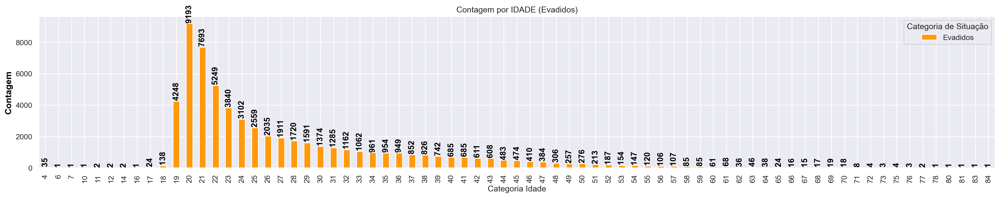

In [56]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráfico de distribuição da variável IDADE
contagem = df_evadidos['IDADE'].value_counts().sort_index()  # Sem normalizar

# Gerando o gráfico de barras
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"

plt.figure(figsize=(25, 4))
bars = contagem.plot(kind='bar', color=color_palette3, stacked=True)
plt.title('Contagem por IDADE (Evadidos)')
plt.xlabel('Categoria Idade', fontsize=12)
plt.ylabel('Contagem', fontsize=13, fontweight='bold', ha='center', color='black')

# Adicionando os valores absolutos acima das barras
for i, valor in enumerate(contagem):
    plt.text(i, valor, f' {valor}', fontsize=12, fontweight='bold', ha='center', rotation='vertical', color='black')

# Adicionando a legenda para 'CATEGORIA_SITUACAO'
plt.legend(title='Categoria de Situação', labels=['Evadidos'], loc='upper right')

# Exibindo o gráfico
plt.show()

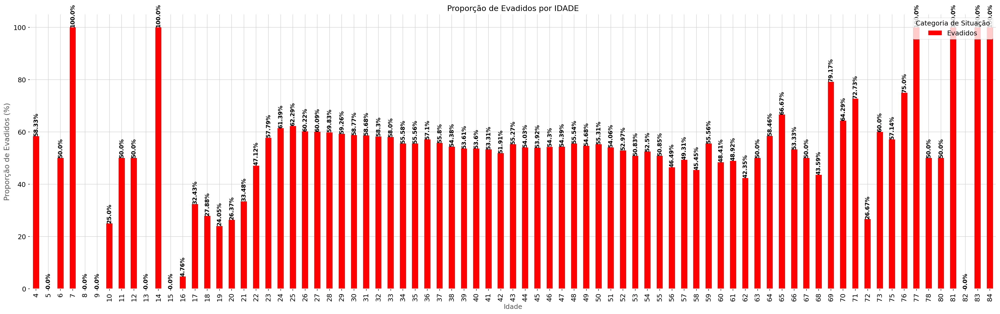

In [6]:
# Total de matrículas por idade (todas as situações)
total_por_idade = df['IDADE'].value_counts().sort_index()

# Total de evadidos por idade
evadidos_por_idade = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['IDADE'].value_counts().sort_index()

# Proporção de evadidos por idade (%)
proporcao_evadidos_idade = ((evadidos_por_idade / total_por_idade) * 100).round(2).fillna(0)

# Gerar gráfico
plt.figure(figsize=(25, 8))
bars = proporcao_evadidos_idade.plot(kind='bar', color="Red", stacked=True)

# Título e rótulos
plt.title('Proporção de Evadidos por IDADE', fontsize=14)
plt.xlabel('Idade', fontsize=12)
plt.ylabel('Proporção de Evadidos (%)', fontsize=13)

# Adicionando os valores percentuais acima das barras
for i, valor in enumerate(proporcao_evadidos_idade):
    plt.text(i, valor + 0.5, f'{valor}%', fontsize=10, fontweight='bold', ha='center', rotation='vertical', color='black')

# Legenda
plt.legend(title='Categoria de Situação', labels=['Evadidos'], loc='upper right')
plt.tight_layout()
plt.show()

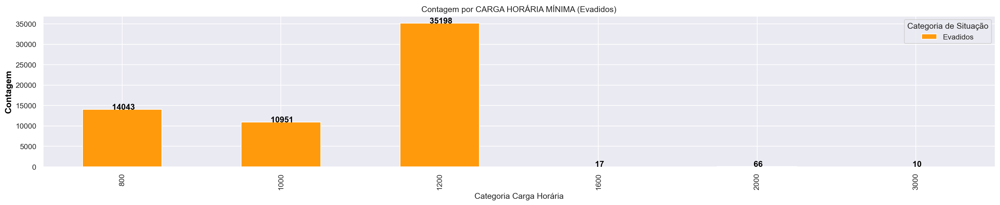

In [57]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráfico de distribuição da variável CARGA_HORARIA_MINIMA
contagem = df_evadidos['CARGA_HORARIA_MINIMA'].value_counts().sort_index()  # Sem normalizar

# Gerando o gráfico de barras
# color_palette3 = ["#109BA8","#053048","#AD8D5C","#594B12","#8c3608"]
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"


plt.figure(figsize=(25, 4))
bars = contagem.plot(kind='bar', color=color_palette3, label='Carga Horária Mínima')

# Título e rótulos
plt.title('Contagem por CARGA HORÁRIA MÍNIMA (Evadidos)')
plt.xlabel('Categoria Carga Horária', fontsize=12)
plt.ylabel('Contagem', fontsize=13, fontweight='bold', ha='center', color='black')

# Adicionando os valores absolutos acima das barras
for i, valor in enumerate(contagem):
    plt.text(i, valor, f' {valor}', fontsize=12, fontweight='bold', ha='center', color='black')

# Adicionando a legenda para 'CATEGORIA_SITUACAO'
plt.legend(title='Categoria de Situação', labels=['Evadidos'], loc='upper right')

# Exibindo o gráfico
plt.show()

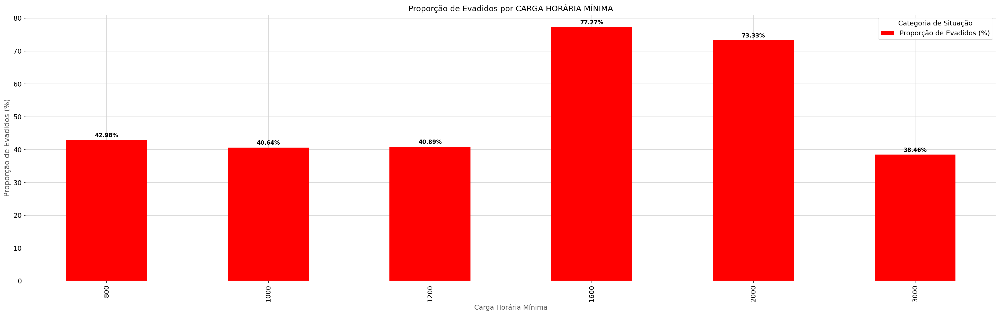

In [7]:
# Total de matrículas por carga horária (todas as situações)
total_por_carga = df['CARGA_HORARIA_MINIMA'].value_counts().sort_index()

# Total de evadidos por carga horária
evadidos_por_carga = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['CARGA_HORARIA_MINIMA'].value_counts().sort_index()

# Proporção de evadidos por carga horária (%)
proporcao_evadidos_carga = ((evadidos_por_carga / total_por_carga) * 100).round(2).fillna(0)

# Gerar gráfico
plt.figure(figsize=(25, 8))
bars = proporcao_evadidos_carga.plot(kind='bar', color='red', label='Proporção de Evadidos (%)')

# Título e rótulos
plt.title('Proporção de Evadidos por CARGA HORÁRIA MÍNIMA', fontsize=14)
plt.xlabel('Carga Horária Mínima', fontsize=12)
plt.ylabel('Proporção de Evadidos (%)', fontsize=13)

# Adicionando os valores percentuais acima das barras
for i, valor in enumerate(proporcao_evadidos_carga):
    plt.text(i, valor + 0.5, f'{valor}%', ha='center', va='bottom', fontsize=10, fontweight='bold')

# Legenda
plt.legend(title='Categoria de Situação', loc='upper right')
plt.tight_layout()
plt.show()

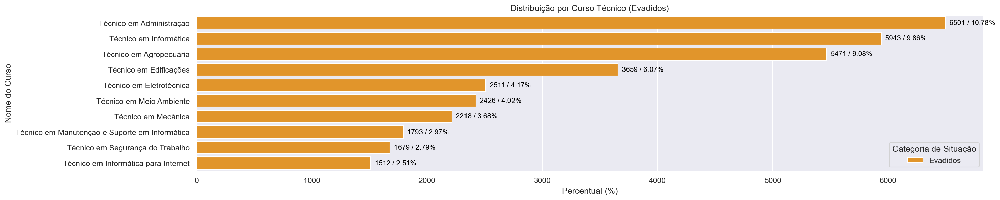

In [58]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['NOME_DE_CURSO'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico
# color_palette3 = ["#109BA8","#053048","#AD8D5C","#594B12","#8c3608"]
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"


ax = sns.countplot(
    y='NOME_DE_CURSO',
    data=df_evadidos,
    order=percentuais.index,
    palette=color_palette3
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['NOME_DE_CURSO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por Curso Técnico (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

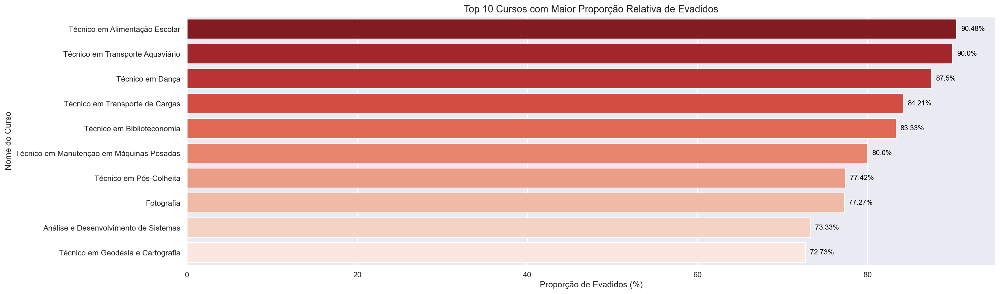

In [8]:
# Total de matrículas por curso (todas as situações)
total_por_curso = df['NOME_DE_CURSO'].value_counts()

# Total de evadidos por curso
evadidos_por_curso = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['NOME_DE_CURSO'].value_counts()

# Proporção de evadidos por curso
proporcao_evadidos_curso = ((evadidos_por_curso / total_por_curso) * 100).round(2)

# Top 10 cursos com maior proporção de evasão
top_10_cursos = proporcao_evadidos_curso.sort_values(ascending=False).head(10)

# Configuração do gráfico
sns.set(rc={'figure.figsize': (20, 6)})

# Criar gráfico de barras horizontais
ax = sns.barplot(
    y=top_10_cursos.index,
    x=top_10_cursos.values,
    palette='Reds_r'
)

# Adicionando os valores nas barras
for i, (curso, percentual) in enumerate(top_10_cursos.items()):
    ax.text(percentual + 0.5, i, f'{percentual}%', color='black', va='center', fontsize=10)

# Configurações do gráfico
plt.title('Top 10 Cursos com Maior Proporção Relativa de Evadidos', fontsize=14)
plt.xlabel('Proporção de Evadidos (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.tight_layout()
plt.show()

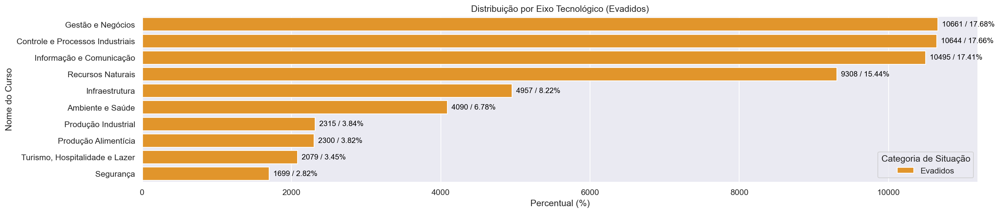

In [59]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['EIXO_TECNOLOGICO'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico
# color_palette3 = ["#109BA8","#053048","#AD8D5C","#594B12","#8c3608"]
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"


ax = sns.countplot(
    y='EIXO_TECNOLOGICO',
    data=df_evadidos,
    order=percentuais.index,
    palette=color_palette3
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['EIXO_TECNOLOGICO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por Eixo Tecnológico (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

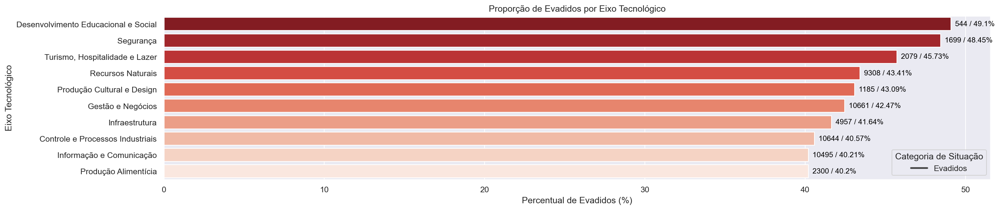

In [12]:
# Total de matrículas por EIXO_TECNOLOGICO
total_por_eixo = df['EIXO_TECNOLOGICO'].value_counts()
# Evadidos por EIXO_TECNOLOGICO
evadidos_por_eixo = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['EIXO_TECNOLOGICO'].value_counts()

# Cálculo da proporção em %
proporcao = ((evadidos_por_eixo / total_por_eixo) * 100).fillna(0).sort_values(ascending=False).head(10).round(2)

# Gráfico
sns.set(rc={'figure.figsize': (20, 4)})

ax = sns.barplot(
    y=proporcao.index,
    x=proporcao.values,
    palette='Reds_r'
)

# Adicionando os valores absolutos e percentuais ao lado das barras
for i, eixo in enumerate(proporcao.index):
    count = evadidos_por_eixo[eixo]
    percent = proporcao[eixo]
    ax.text(
        percent,
        i,
        f'  {count} / {percent}%',
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais
plt.title('Proporção de Evadidos por Eixo Tecnológico')
plt.xlabel('Percentual de Evadidos (%)', fontsize=12)
plt.ylabel('Eixo Tecnológico', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

plt.show()

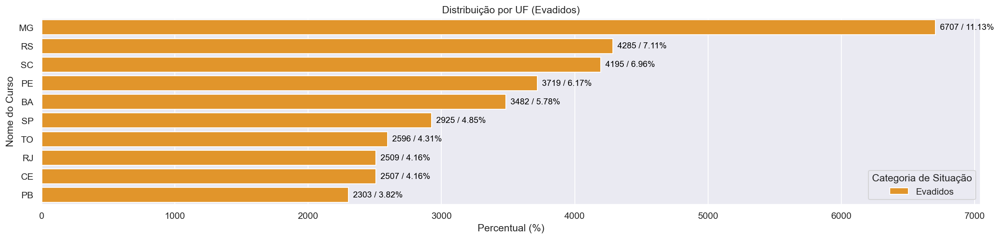

In [60]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['UF'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico
# color_palette3 = ["#109BA8","#053048","#AD8D5C","#594B12","#8c3608"]
color_palette3 = ["#ff9a0d"]  #"#053048","#AD8D5C","#594B12","#8c3608"


ax = sns.countplot(
    y='UF',
    data=df_evadidos,
    order=percentuais.index,
    palette=color_palette3
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['UF'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por UF (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

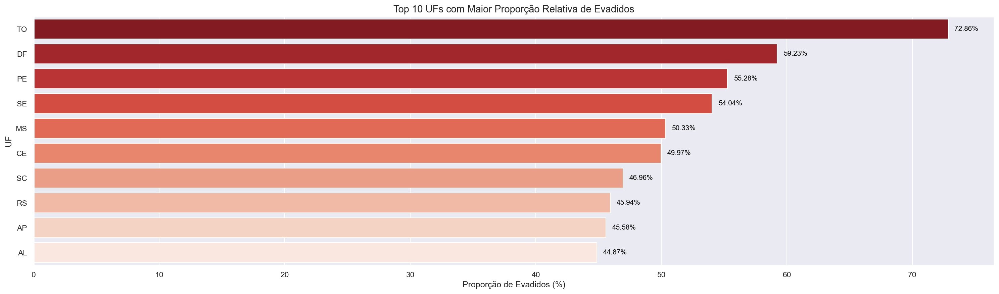

In [9]:
# Total de matrículas por UF (todas as situações)
total_por_uf = df['UF'].value_counts()

# Total de evadidos por UF
evadidos_por_uf = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['UF'].value_counts()

# Cálculo da proporção de evadidos por UF (%)
proporcao_evadidos_uf = ((evadidos_por_uf / total_por_uf) * 100).round(2)

# Top 10 UFs com maior proporção de evasão
top_10_ufs = proporcao_evadidos_uf.sort_values(ascending=False).head(10)

# Configurar o gráfico
sns.set(rc={'figure.figsize': (20, 6)})


# Criar gráfico de barras horizontais
ax = sns.barplot(
    y=top_10_ufs.index,
    x=top_10_ufs.values,
    palette='Reds_r'
)

# Adicionar rótulos nas barras
for i, (uf, percentual) in enumerate(top_10_ufs.items()):
    ax.text(percentual + 0.5, i, f'{percentual}%', color='black', va='center', fontsize=10)

# Configurações do gráfico
plt.title('Top 10 UFs com Maior Proporção Relativa de Evadidos', fontsize=14)
plt.xlabel('Proporção de Evadidos (%)', fontsize=12)
plt.ylabel('UF', fontsize=12)
plt.tight_layout()
plt.show()

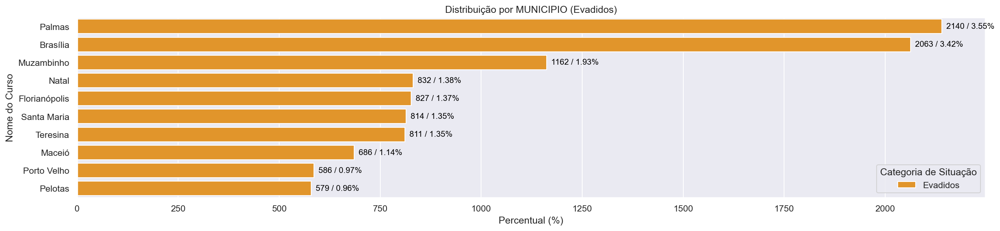

In [61]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['MUNICIPIO'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico

ax = sns.countplot(
    y='MUNICIPIO',
    data=df_evadidos,
    order=percentuais.index,
    color="#ff9a0d"
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['MUNICIPIO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por MUNICIPIO (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

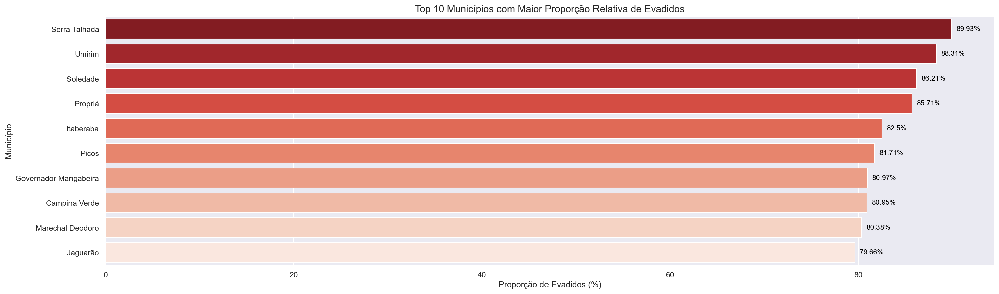

In [10]:
# Calcular total de matrículas por município
total_por_municipio = df['MUNICIPIO'].value_counts()

# Calcular total de evadidos por município
evadidos_por_municipio = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['MUNICIPIO'].value_counts()

# Calcular a proporção de evadidos por total de matrículas (%)
proporcao_evadidos = ((evadidos_por_municipio / total_por_municipio) * 100).round(2)

# Selecionar os top 10 municípios com maior proporção de evasão
top_10_municipios = proporcao_evadidos.sort_values(ascending=False).head(10)

# Criar gráfico
sns.set(rc={'figure.figsize': (20, 6)})
ax = sns.barplot(
    y=top_10_municipios.index,
    x=top_10_municipios.values,
    palette='Reds_r'
)

# Adicionar anotações nas barras
for i, (municipio, percentual) in enumerate(top_10_municipios.items()):
    ax.text(percentual + 0.5, i, f'{percentual}%', color='black', va='center', fontsize=10)

# Títulos e rótulos
plt.title('Top 10 Municípios com Maior Proporção Relativa de Evadidos', fontsize=14)
plt.xlabel('Proporção de Evadidos (%)')
plt.ylabel('Município')
plt.tight_layout()
plt.show()

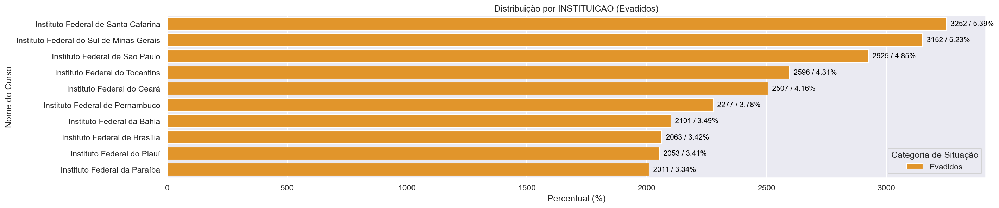

In [62]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['INSTITUICAO'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico

ax = sns.countplot(
    y='INSTITUICAO',
    data=df_evadidos,
    order=percentuais.index,
    color="#ff9a0d"
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['INSTITUICAO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por INSTITUICAO (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

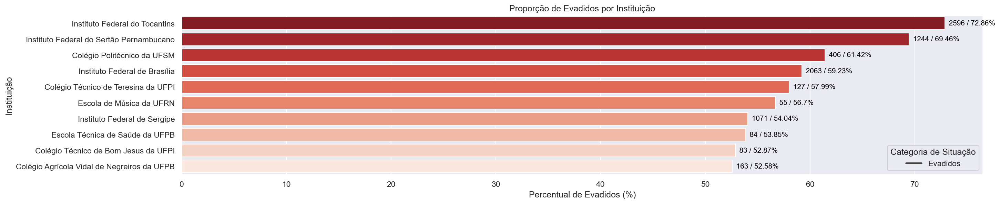

In [13]:
# Total de matrículas por INSTITUICAO
total_por_instituicao = df['INSTITUICAO'].value_counts()

# Total de evadidos por INSTITUICAO
evadidos_por_instituicao = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['INSTITUICAO'].value_counts()

# Calculando proporção (%) e selecionando o top 10
proporcao = ((evadidos_por_instituicao / total_por_instituicao) * 100).fillna(0).sort_values(ascending=False).head(10).round(2)

# Gráfico
sns.set(rc={'figure.figsize': (20, 4)})

ax = sns.barplot(
    y=proporcao.index,
    x=proporcao.values,
    palette='Reds_r'
)

# Adicionando valores absolutos + percentuais
for i, inst in enumerate(proporcao.index):
    count = evadidos_por_instituicao[inst]
    percent = proporcao[inst]
    ax.text(
        percent,
        i,
        f'  {count} / {percent}%',
        color='black',
        va='center',
        fontsize=10
    )

# Configurações finais
plt.title('Proporção de Evadidos por Instituição')
plt.xlabel('Percentual de Evadidos (%)', fontsize=12)
plt.ylabel('Instituição', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Mostrar gráfico
plt.show()

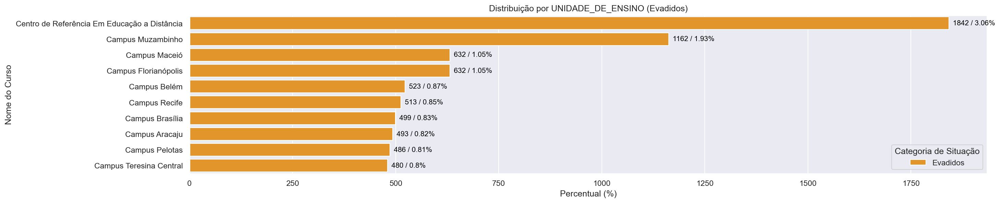

In [63]:
# Filtrando os dados para 'CATEGORIA_SITUACAO' == 'Evadidos'
df_evadidos = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']

# Gráficos de distribuição da variável - Nome do curso
# Configuração do tamanho do gráfico
sns.set(rc={'figure.figsize': (20, 4)})

# Calculando os percentuais
percentuais = (df_evadidos['UNIDADE_DE_ENSINO'].value_counts(normalize=True).head(10) * 100).round(2)

# Criando o gráfico

ax = sns.countplot(
    y='UNIDADE_DE_ENSINO',
    data=df_evadidos,
    order=percentuais.index,
    color="#ff9a0d"
)

# Adicionando os valores em percentagem ao lado das barras
for i, p in enumerate(percentuais):
    count = df_evadidos['UNIDADE_DE_ENSINO'].value_counts().iloc[i]  # Obtendo o valor absoluto
    ax.text(
        count,  # Posição x
        i,  # Posição y
        f'  {count} / {p}%',  # Texto exibindo valor absoluto e percentual
        color='black',
        va='center',
        fontsize=10
    )

# Configurações adicionais do gráfico
plt.title('Distribuição por UNIDADE_DE_ENSINO (Evadidos)')
plt.xlabel('Percentual (%)', fontsize=12)
plt.ylabel('Nome do Curso', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

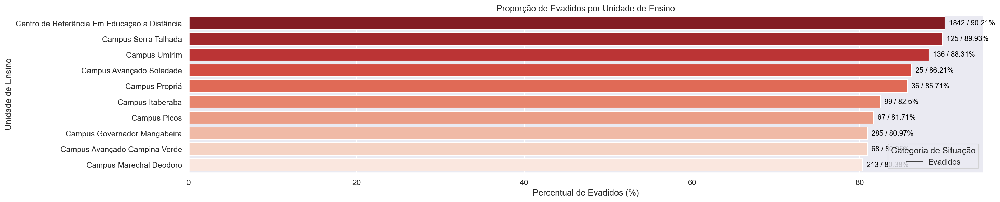

In [14]:
# Total de matrículas por UNIDADE_DE_ENSINO
total_por_unidade = df['UNIDADE_DE_ENSINO'].value_counts()

# Total de evadidos por UNIDADE_DE_ENSINO
evadidos_por_unidade = df[df['CATEGORIA_SITUACAO'] == 'Evadidos']['UNIDADE_DE_ENSINO'].value_counts()

# Calculando proporção (%) e pegando as top 10 unidades com maiores taxas
proporcao = ((evadidos_por_unidade / total_por_unidade) * 100).fillna(0).sort_values(ascending=False).head(10).round(2)

# Gráfico
sns.set(rc={'figure.figsize': (20, 4)})

ax = sns.barplot(
    y=proporcao.index,
    x=proporcao.values,
    palette='Reds_r'
)

# Adicionando valores absolutos + percentuais
for i, unidade in enumerate(proporcao.index):
    count = evadidos_por_unidade[unidade]
    percent = proporcao[unidade]
    ax.text(
        percent,
        i,
        f'  {count} / {percent}%',
        color='black',
        va='center',
        fontsize=10
    )

# Configurações do gráfico
plt.title('Proporção de Evadidos por Unidade de Ensino')
plt.xlabel('Percentual de Evadidos (%)', fontsize=12)
plt.ylabel('Unidade de Ensino', fontsize=12)
plt.legend(title='Categoria de Situação', labels=['Evadidos'])

# Exibindo o gráfico
plt.show()

Insights:
- A maioria dos alunos evadidos está na faixa etária entre 20 e 30 anos.
- O maior número de alunos evadidos são da região Nordeste do Brasil.
- Quase 60% dos evadidos são de escola localizada em regiões não metropolitanas.
- Alunos dos sexo Masculino são 56% mais propensos a evasão.
- A renda familiar que mais tem alunos evadidos é: Entre 0 a 1,5 salários mímimos.
- Alunos matrículados em turno: Nortuno são  53,6% do total de evadidos.
- Mais da metade dos alunos evadidos são da cor: Preta ou Parda.
- Os alunos dos cursos que fizeram parte do Eixo Tecnológico de: Mecânica e industrial são o que mais evadem.
- Cerca de 80% dos alunos que fizeram o curso técnico Integrado ou Subsequente ao ensino médio evadiram.
- Mais da metade dos alunos que evadiram fizem o curso técnico na Modalidade: Presencial.

### 2.8 Mapa do Brasil (target = EVADIDOS)

In [ ]:
# Mapa com GeoPandas
# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo

# Filtrar apenas os evadidos
evadidos = data_geo[data_geo['CATEGORIA_SITUACAO'] == 'Evadidos']
# evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]


# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('MUNICIPIO').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'  # ou .shp
gdf_municipios = gpd.read_file(shapefile_path)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_municipios = gdf_municipios.rename(columns={'NM_MUN': 'MUNICIPIO'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_municipios.merge(quantitativo_evadidos, on='MUNICIPIO', how='left')

# Substituir valores NaN por zero (municípios sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)

# Criar o mapa
plt.figure(figsize=(12, 12))
gdf_mapa.plot(column='quantidade', 
              cmap='Reds', #viridis
              legend=True, 
              edgecolor = 'black',
              linewidth=0.1,
              legend_kwds={'label': "Número de Evadidos por Municipio"}, 
              figsize=(15, 15))

plt.title('Distribuição de Evadidos por Municipio no Brasil', fontsize=16)
plt.axis('off')
plt.show()

In [ ]:
# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')

# Total de matrículas por município
total_matriculas = data_geo.groupby('MUNICIPIO').size().reset_index(name='total')

# Número de evadidos por município
evadidos = data_geo[data_geo['CATEGORIA_SITUACAO'] == 'Evadidos']
evadidos_por_municipio = evadidos.groupby('MUNICIPIO').size().reset_index(name='evadidos')

# Merge e cálculo da proporção em percentual
proporcao = pd.merge(total_matriculas, evadidos_por_municipio, on='MUNICIPIO', how='left')
proporcao['evadidos'] = proporcao['evadidos'].fillna(0)
proporcao['proporcao_evadidos'] = (proporcao['evadidos'] / proporcao['total']) * 100  # Em %

# Carregar o shapefile dos municípios
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'
gdf_municipios = gpd.read_file(shapefile_path)

# Ajuste do nome do município se necessário
gdf_municipios = gdf_municipios.rename(columns={'NM_MUN': 'MUNICIPIO'})

# Merge geográfico
gdf_mapa = gdf_municipios.merge(proporcao, on='MUNICIPIO', how='left')
gdf_mapa['proporcao_evadidos'] = gdf_mapa['proporcao_evadidos'].fillna(0)

# # Criar o mapa
# plt.figure(figsize=(15, 15))
# gdf_mapa.plot(
#     column='proporcao_evadidos',
#     cmap='Reds',
#     legend=True,
#     edgecolor='black',
#     linewidth=0.1,
#     legend_kwds={
#         'label': "Proporção de Evadidos (%) por Município",
#         'fmt': '%.1f%%'
#     },
#     vmin=0,
#     vmax=100
# )

# plt.title('Proporção de Evadidos por Município no Brasil', fontsize=16)
# plt.axis('off')
# plt.show()


# Criar o mapa com tamanho ajustado
fig, ax = plt.subplots(figsize=(18, 12))  # Largura x Altura em polegadas
gdf_mapa.plot(
    column='proporcao_evadidos',
    cmap='YlOrRd',
    legend=True,
    edgecolor='black',
    linewidth=0.1,
    legend_kwds={
        'label': "Proporção de Evadidos (%) por Município",
        'fmt': '%.1f%%'
    },
    vmin=0,
    vmax=100,
    ax=ax
)

# ax.set_title('Proporção de Evadidos por Município no Brasil', fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo

# Converter as colunas UF e SG_UF para o tipo string
data_geo['UF'] = data_geo['UF'].astype(str)
data_cod['SG_UF'] = data_cod['SG_UF'].astype(str)

# Realizar o merge pela coluna 'UF'
data_geo_merged = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')



# # Filtrar apenas os evadidos
# evadidos = data_geo_merged[data_geo_merged['CATEGORIA_SITUACAO'] == 'Evadidos']
# # evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]

# Filtrar apenas os evadidos
evadidos = data_geo_merged[data_geo_merged['CATEGORIA_SITUACAO'] == 'Evadidos']

# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('NM_UF').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'  # ou .shp
gdf_estados = gpd.read_file(shapefile_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por UF
gdf_estados = gdf_estados.dissolve(by='NM_UF', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_estados = gdf_estados.rename(columns={'NM_UF': 'NM_UF'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_estados.merge(quantitativo_evadidos, on='NM_UF', how='left')


# Substituir valores NaN por zero (municípios sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)



# Criar o mapa
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_mapa.plot(
    column='quantidade', 
    cmap='PuBuGn',  # Escolha o esquema de cores: coolwarm, viridis, Set2
    legend=True, 
    edgecolor='black',
    linewidth=0.1,
    legend_kwds={
        'label': "Número de Evadidos por UF", 
        'orientation': "vertical"
    }, 
    ax=ax
)

# Adicionar rótulos com a quantidade de evadidos em cada UF
for idx, row in gdf_mapa.iterrows():
    # Nome da região
    plt.text(
        row.geometry.centroid.x, 
        row.geometry.centroid.y + 0.5,  # Elevar o nome da região acima do número
        row['NM_UF'],  # Nome da região
        fontsize=6, 
        ha='center', 
        color='black', 
        fontweight='bold'
    )
    # Adiciona o texto no centro geométrico da geometria da UF
    plt.text(
        row.geometry.centroid.x, 
        row.geometry.centroid.y, 
        str(int(row['quantidade'])),  # O valor da quantidade como inteiro
        fontsize=6,  # Ajuste o tamanho da fonte
        ha='center', 
        color='black',
        fontweight='bold'
    )

# Configurar título e remover os eixos
plt.title('Distribuição de Evadidos por UF no Brasil', fontsize=16, pad=20)
plt.axis('off')
plt.show()


In [ ]:
# Carregar os dados
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')

codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')

# Garantir tipo string
data_geo['UF'] = data_geo['UF'].astype(str)
data_cod['SG_UF'] = data_cod['SG_UF'].astype(str)

# Merge para obter nomes das UFs
data_geo_merged = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Total de matrículas por UF
total_por_uf = data_geo_merged.groupby('NM_UF').size().reset_index(name='total_matriculas')

# Evadidos por UF
evadidos = data_geo_merged[data_geo_merged['CATEGORIA_SITUACAO'] == 'Evadidos']
evadidos_por_uf = evadidos.groupby('NM_UF').size().reset_index(name='evadidos')

# Calcular proporção
proporcao = pd.merge(total_por_uf, evadidos_por_uf, on='NM_UF', how='left')
proporcao['evadidos'] = proporcao['evadidos'].fillna(0)
proporcao['proporcao_evadidos'] = (proporcao['evadidos'] / proporcao['total_matriculas']) * 100

# Carregar shapefile dos estados e agrupar por UF
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'
gdf_estados = gpd.read_file(shapefile_path)
gdf_estados = gdf_estados.dissolve(by='NM_UF', as_index=False)

# Merge com dados de proporção
gdf_mapa = gdf_estados.merge(proporcao, on='NM_UF', how='left')
gdf_mapa['proporcao_evadidos'] = gdf_mapa['proporcao_evadidos'].fillna(0)

# Plotar mapa
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_mapa.plot(
    column='proporcao_evadidos',
    cmap='YlOrRd', # PuBuGn
    legend=True,
    edgecolor='black',
    linewidth=0.1,
    legend_kwds={
        'label': "Proporção de Evadidos (%) por UF",
        'orientation': "vertical",
        'fmt': '%.1f%%'
    },
    ax=ax
)

# Adicionar rótulos com a UF e percentual
for idx, row in gdf_mapa.iterrows():
    if row['proporcao_evadidos'] > 0:
        plt.text(
            row.geometry.centroid.x,
            row.geometry.centroid.y + 0.5,
            row['NM_UF'],
            fontsize=6,
            ha='center',
            color='black',
            fontweight='bold'
        )
        plt.text(
            row.geometry.centroid.x,
            row.geometry.centroid.y,
            f"{row['proporcao_evadidos']:.1f}%",
            fontsize=6,
            ha='center',
            color='black',
            fontweight='bold'
        )

# plt.title('Proporção de Evadidos por UF no Brasil', fontsize=16, pad=20)
plt.axis('off')
plt.show()

In [ ]:
# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo

# Remover a palavra "Região " dos valores na coluna REGIAO
data_geo['REGIAO'] = data_geo['REGIAO'].str.replace('Região ', '', regex=False)

# Alterar "Centro-Oeste" para "Centro-oeste"
data_geo['REGIAO'] = data_geo['REGIAO'].replace('Centro-Oeste', 'Centro-oeste')

# Filtrar apenas os evadidos
evadidos = data_geo[data_geo['CATEGORIA_SITUACAO'] == 'Evadidos']

# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('REGIAO').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'  # ou .shp
gdf_regioes = gpd.read_file(shapefile_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por UF
gdf_regioes = gdf_regioes.dissolve(by='NM_REGIAO', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_regioes = gdf_regioes.rename(columns={'NM_REGIAO': 'REGIAO'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_regioes.merge(quantitativo_evadidos, on='REGIAO', how='left')

# Substituir valores NaN por zero (municípios sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)

# Criar o mapa
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_mapa.plot(
    column='quantidade', 
    cmap='Reds',  # Escolha o esquema de cores coolwarm
    legend=True, 
    edgecolor='black',
    linewidth=0.1,
    legend_kwds={
        'label': "Número de Evadidos por Região", 
        'orientation': "vertical"
    }, 
    ax=ax
)

# Adicionar rótulos com a quantidade de evadidos em cada UF
for idx, row in gdf_mapa.iterrows():
    
    # Nome da região
    plt.text(
        row.geometry.centroid.x, 
        row.geometry.centroid.y + 0.5,  # Elevar o nome da região acima do número
        row['REGIAO'],  # Nome da região
        fontsize=9, 
        ha='center', 
        color='black', 
        fontweight='bold'
    )
    # Adiciona o texto no centro geométrico da geometria da UF
    plt.text(
        row.geometry.centroid.x, 
        row.geometry.centroid.y, 
        str(int(row['quantidade'])),  # O valor da quantidade como inteiro
        fontsize=8,  # Ajuste o tamanho da fonte
        ha='center', 
        color='black',
        fontweight='bold'
    )

# Configurar título e remover os eixos
plt.title('Distribuição de Evadidos por Região no Brasil', fontsize=16, pad=20)
plt.axis('off')
plt.show()

In [ ]:
# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')

# Padronizar nomes das regiões
data_geo['REGIAO'] = data_geo['REGIAO'].str.replace('Região ', '', regex=False)
data_geo['REGIAO'] = data_geo['REGIAO'].replace('Centro-Oeste', 'Centro-oeste')

# Total de matrículas por região
total_por_regiao = data_geo.groupby('REGIAO').size().reset_index(name='total_matriculas')

# Evadidos por região
evadidos = data_geo[data_geo['CATEGORIA_SITUACAO'] == 'Evadidos']
evadidos_por_regiao = evadidos.groupby('REGIAO').size().reset_index(name='evadidos')

# Calcular proporção
proporcao = pd.merge(total_por_regiao, evadidos_por_regiao, on='REGIAO', how='left')
proporcao['evadidos'] = proporcao['evadidos'].fillna(0)
proporcao['proporcao_evadidos'] = (proporcao['evadidos'] / proporcao['total_matriculas']) * 100

# Carregar shapefile e dissolver por região
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'
gdf_regioes = gpd.read_file(shapefile_path)
gdf_regioes = gdf_regioes.dissolve(by='NM_REGIAO', as_index=False)
gdf_regioes = gdf_regioes.rename(columns={'NM_REGIAO': 'REGIAO'})

# Merge com dados de proporção
gdf_mapa = gdf_regioes.merge(proporcao, on='REGIAO', how='left')
gdf_mapa['proporcao_evadidos'] = gdf_mapa['proporcao_evadidos'].fillna(0)

# Criar mapa
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
gdf_mapa.plot(
    column='proporcao_evadidos', 
    cmap='YlOrRd', #  YlGnBu YlOrRd
    legend=True, 
    edgecolor='black',
    linewidth=0.3,
    legend_kwds={
        'label': "Proporção de Evadidos (%) por Região", 
        'orientation': "vertical",
        'fmt': '%.1f%%'
    }, 
    ax=ax
)

# Adicionar rótulos
for idx, row in gdf_mapa.iterrows():
    if row['proporcao_evadidos'] > 0:
        plt.text(
            row.geometry.centroid.x,
            row.geometry.centroid.y + 0.5,
            row['REGIAO'],
            fontsize=9,
            ha='center',
            color='black',
            fontweight='bold'
        )
        plt.text(
            row.geometry.centroid.x,
            row.geometry.centroid.y,
            f"{row['proporcao_evadidos']:.1f}%",
            fontsize=8,
            ha='center',
            color='black',
            fontweight='bold'
        )

# Título e layout final
# plt.title('Proporção de Evadidos por Região no Brasil', fontsize=16, pad=20)
plt.axis('off')
plt.show()

In [ ]:
# transformando o arquivo IBGE .shp para .geoJSON
import geopandas as gpd

# Caminho para o arquivo shapefile
shapefile_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.shp'

# Ler o shapefile usando GeoPandas
gdf = gpd.read_file(shapefile_path)

# Caminho para salvar o arquivo GeoJSON
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'

# Exportar para o formato GeoJSON
gdf.to_file(geojson_path, driver='GeoJSON')

print(f"Arquivo convertido e salvo em: {geojson_path}")


In [ ]:
# Mapa dinâmico do Brasil de Evadidos
from folium import Choropleth
import folium.features

# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo


# Converter as colunas UF e SG_UF para o tipo string
data_geo['UF'] = data_geo['UF'].astype(str)
data_cod['SG_UF'] = data_cod['SG_UF'].astype(str)


# Realizar o merge entre o UFs
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Filtrar apenas os evadidos
evadidos = data_geo_merge[data_geo_merge['CATEGORIA_SITUACAO'] == 'Evadidos']
# evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]


# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('NM_UF').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'  # ou .shp
gdf_estados = gpd.read_file(geojson_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por UF
gdf_estados = gdf_estados.dissolve(by='NM_UF', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_estados = gdf_estados.rename(columns={'NM_UF': 'NM_UF'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_estados.merge(quantitativo_evadidos, on='NM_UF', how='left')

# Substituir valores NaN por zero (UF sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)



# Obter o centroide aproximado do Brasil para centralizar o mapa
latitude_centro = -14.2350
longitude_centro = -51.9253

# Criar o mapa base
mapa = folium.Map(location=[latitude_centro, longitude_centro], tiles="Cartodb Positron", zoom_start=5)

# Adicionar o mapa coroplético
Choropleth(
    geo_data=gdf_estados,
    data=gdf_mapa,
    columns=['NM_UF', 'quantidade'],
    key_on='properties.NM_UF',
    fill_color='viridis', #viridis
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Número de Evadidos por Estados do Brasil'
).add_to(mapa)

#Funções de destaque
estilo = lambda x: {"fillColor": "white",
                    "color": "black",
                    "fillOpacity": 0.001,
                    "weight": 0.001}

estilo_destaque = lambda x: {"fillColor": "darkblue",
                             "color": "black",
                             "fillOpacity": 0.5,
                             "weight": 1}

highlight = folium.features.GeoJson(data = gdf_estados,
                                    style_function= estilo,
                                    highlight_function=estilo_destaque)

#Adicionando o destaque ao mapa
mapa.add_child(highlight)




# # Adicionar tooltip para mostrar nome do muncípio e qtde de evadidos
folium.GeoJson(
    gdf_mapa,
    style_function=lambda feature: {
        "fillColor": 'black',
        "color": "black",
        "weight": 0.001,
        "dashArray": "5, 5",
        "fillOpacity": 0.001
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NM_UF', 'quantidade'],
        aliases=['Estado:', 'Qtde evadidos:'],
        localize=True,
        style=("background: white; color: black")

    )
).add_to(mapa)


folium.LayerControl().add_to(mapa)

# Salvar o mapa como um arquivo HTML
mapa

# Exibir instrução para o usuário
# print("Mapa salvo como 'mapa_evadidos_brasil.html'. Abra-o em um navegador para visualizar.")

In [ ]:
# Mapa dinâmico do Brasil de Evadidos
from folium import Choropleth
import folium.features

# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo


# Converter as colunas UF e SG_UF para o tipo string
data_geo['UF'] = data_geo['UF'].astype(str)
data_cod['SG_UF'] = data_cod['SG_UF'].astype(str)


# Realizar o merge entre o UFs
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Filtrar apenas os evadidos
evadidos = data_geo_merge[data_geo_merge['CATEGORIA_SITUACAO'] == 'Evadidos']
# evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]


# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('NM_UF').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'  # ou .shp
gdf_estados = gpd.read_file(geojson_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por UF
gdf_estados = gdf_estados.dissolve(by='NM_UF', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_estados = gdf_estados.rename(columns={'NM_UF': 'NM_UF'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_estados.merge(quantitativo_evadidos, on='NM_UF', how='left')

# Substituir valores NaN por zero (UF sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)



# Obter o centroide aproximado do Brasil para centralizar o mapa
latitude_centro = -14.2350
longitude_centro = -51.9253

# Criar o mapa base
mapa = folium.Map(location=[latitude_centro, longitude_centro], tiles="Cartodb Positron", zoom_start=5)



# Adicionar o mapa coroplético
Choropleth(
    geo_data=gdf_estados,
    data=gdf_mapa,
    columns=['NM_UF', 'quantidade'],
    key_on='properties.NM_UF',
    fill_color='viridis', #viridis
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Número de Evadidos por Estados do Brasil'
).add_to(mapa)

#Funções de destaque
estilo = lambda x: {"fillColor": "white",
                    "color": "black",
                    "fillOpacity": 0.001,
                    "weight": 0.001}

estilo_destaque = lambda x: {"fillColor": "darkblue",
                             "color": "black",
                             "fillOpacity": 0.5,
                             "weight": 1}

# Adicionando destaque e tooltip ao mapa
highlight = folium.features.GeoJson(
    data=gdf_mapa,
    style_function=estilo,
    highlight_function=estilo_destaque,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NM_UF', 'quantidade'],  # Campos para exibir no tooltip
        aliases=['Estado:', 'Evadidos:' ],  # Rótulos para os campos
        localize=True,
        style=("background: white; color: black")
    )
)

# Adicionar o destaque ao mapa
highlight.add_to(mapa)

# Adicionar controle de camadas
folium.LayerControl().add_to(mapa)

# Salvar o mapa como um arquivo HTML
mapa

# Exibir instrução para o usuário
# print("Mapa salvo como 'mapa_evadidos_brasil.html'. Abra-o em um navegador para visualizar.")


In [ ]:
# Carregar datasets
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')

codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')

# Converter colunas para string
data_geo['UF'] = data_geo['UF'].astype(str)
data_cod['SG_UF'] = data_cod['SG_UF'].astype(str)

# Merge entre dados e códigos de UF
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Total de matrículas por UF
total_por_uf = data_geo_merge.groupby('NM_UF').size().reset_index(name='total_matriculas')

# Total de evadidos por UF
evadidos = data_geo_merge[data_geo_merge['CATEGORIA_SITUACAO'] == 'Evadidos']
evadidos_por_uf = evadidos.groupby('NM_UF').size().reset_index(name='evadidos')

# Merge para calcular proporção
proporcao_df = pd.merge(total_por_uf, evadidos_por_uf, on='NM_UF', how='left')
proporcao_df['evadidos'] = proporcao_df['evadidos'].fillna(0)
proporcao_df['proporcao'] = (proporcao_df['evadidos'] / proporcao_df['total_matriculas']) * 100

# Carregar shapefile dos estados do Brasil (GeoJSON)
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'
gdf_estados = gpd.read_file(geojson_path)

# Dissolver para obter geometria por estado
gdf_estados = gdf_estados.dissolve(by='NM_UF', as_index=False)

# Merge com dados de proporção
gdf_mapa = gdf_estados.merge(proporcao_df, on='NM_UF', how='left')
gdf_mapa['proporcao'] = gdf_mapa['proporcao'].fillna(0)

# Centro aproximado do Brasil
latitude_centro = -14.2350
longitude_centro = -51.9253

# Criar mapa base
mapa = folium.Map(location=[latitude_centro, longitude_centro], tiles="Cartodb Positron", zoom_start=5)

# Mapa coroplético com proporção
Choropleth(
    geo_data=gdf_estados,
    data=gdf_mapa,
    columns=['NM_UF', 'proporcao'],
    key_on='properties.NM_UF',
    fill_color='YlOrRd',
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Proporção de Evadidos (%) por Estado'
).add_to(mapa)

# Estilo para destaque
estilo = lambda x: {"fillColor": "white", "color": "black", "fillOpacity": 0.001, "weight": 0.001}
estilo_destaque = lambda x: {"fillColor": "darkblue", "color": "black", "fillOpacity": 0.5, "weight": 1}

# Adicionar tooltip com proporção
highlight = folium.features.GeoJson(
    data=gdf_mapa,
    style_function=estilo,
    highlight_function=estilo_destaque,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NM_UF', 'proporcao'],
        aliases=['Estado:', 'Proporção de Evadidos (%):'],
        localize=True,
        style=("background: white; color: black"),
        labels=True,
        sticky=True
    )
)
highlight.add_to(mapa)

# Controles
folium.LayerControl().add_to(mapa)

# Exibir
mapa

In [ ]:
# Mapa dinâmico do Brasil de Evadidos
from folium import Choropleth
import folium.features

# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo


# Realizar o merge entre o UFs
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

data_geo_merge.tail()

In [ ]:
# Mapa dinâmico do Brasil de Evadidos
from folium import Choropleth
import folium.features

# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo


# Realizar o merge entre o UFs
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Filtrar apenas os evadidos
evadidos = data_geo_merge[data_geo_merge['CATEGORIA_SITUACAO'] == 'Evadidos']
# evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]


# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('MUNICIPIO').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'  # ou .shp
gdf_municipio = gpd.read_file(geojson_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por Municipio
gdf_municipio = gdf_municipio.dissolve(by='NM_MUN', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_municipio = gdf_municipio.rename(columns={'NM_MUN': 'MUNICIPIO'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_municipio.merge(quantitativo_evadidos, on='MUNICIPIO', how='left')

# Substituir valores NaN por zero (Munic sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)


# Obter o centroide aproximado do Brasil para centralizar o mapa
latitude_centro = -14.2350
longitude_centro = -51.9253

# Criar o mapa base
mapa = folium.Map(location=[latitude_centro, longitude_centro], tiles="Cartodb Positron", zoom_start=5)

# # Adicionar o mapa coroplético
Choropleth(
    geo_data=gdf_municipio,
    data=gdf_mapa,
    columns=['MUNICIPIO', 'quantidade'],
    key_on='properties.MUNICIPIO',
    fill_color='viridis', #viridis
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Número de Evadidos por Municípios do Brasil'
).add_to(mapa)

# #Funções de destaque
# estilo = lambda x: {"fillColor": "white",
#                     "color": "black",
#                     "fillOpacity": 0.001,
#                     "weight": 0.001}

# estilo_destaque = lambda x: {"fillColor": "darkblue",
#                              "color": "black",
#                              "fillOpacity": 0.5,
#                              "weight": 1}

# # Adicionando destaque e tooltip ao mapa
# highlight = folium.features.GeoJson(
#     data=gdf_mapa,
#     style_function=estilo,
#     highlight_function=estilo_destaque,
#     tooltip=folium.features.GeoJsonTooltip(
#         fields=['MUNICIPIO', 'quantidade'],  # Campos para exibir no tooltip
#         aliases=['Município:', 'Evadidos:'],  # Rótulos para os campos
#         localize=True,
#         style=("background: white; color: black")
#     )
# )



# Adicionar o destaque ao mapa
# highlight.add_to(mapa)


# Adicionar controle de camadas
folium.LayerControl().add_to(mapa)

# Salvar o mapa como um arquivo HTML
mapa

# Exibir instrução para o usuário
# print("Mapa salvo como 'mapa_evadidos_brasil.html'. Abra-o em um navegador para visualizar.")

In [ ]:
# Mapa dinâmico do Brasil de Evadidos - PlotLy
from folium import Choropleth
import folium.features

import pandas as pd
import geopandas as gpd
import plotly.express as px

# Carregar o dataset
data_path = '../artifacts/microdados_eficiencia_academica_RedeFederal_2023_tecnico_RegiaoMetropolitana.csv'
data_geo = pd.read_csv(data_path, sep=';')  # Substitua pelo caminho do seu arquivo
# Carregar o dataset
codUF_path = '../artifacts/codigo_estados.csv'
data_cod = pd.read_csv(codUF_path, sep=';', encoding='ISO-8859-1')  # Substitua pelo caminho do seu arquivo


# Realizar o merge entre o UFs
data_geo_merge = pd.merge(data_geo, data_cod, left_on='UF', right_on='SG_UF', how='left')

# Filtrar apenas os evadidos
evadidos = data_geo_merge[data_geo_merge['CATEGORIA_SITUACAO'] == 'Evadidos']
# evadidos = data_geo[(data_geo['CATEGORIA_SITUACAO'] == 'Evadidos') & (data_geo['REGIAO'] == 'Região Centro-Oeste')]


# Agrupar por município e contar o número de evadidos
quantitativo_evadidos = evadidos.groupby('MUNICIPIO').size().reset_index(name='quantidade')

# Carregar o shapefile dos municípios do Brasil (GeoJSON ou shapefile)
# Substitua pelo caminho correto do arquivo
geojson_path = '../artifacts/BR_Municipios_2023/BR_Municipios_2023.geojson'  # ou .shp
gdf_municipio = gpd.read_file(geojson_path)


# Certificar-se de que o GeoDataFrame contém uma única geometria por Municipio
gdf_municipio = gdf_municipio.dissolve(by='NM_MUN', as_index=False)

# Verificar se o nome do município coincide com o dataset
# Caso necessário, ajuste a coluna para realizar o merge corretamente
gdf_municipio = gdf_municipio.rename(columns={'NM_MUN': 'MUNICIPIO'})

# Realizar o merge entre o shapefile e os dados de quantitativo
gdf_mapa = gdf_municipio.merge(quantitativo_evadidos, on='MUNICIPIO', how='left')

# Substituir valores NaN por zero (Munic sem evadidos)
gdf_mapa['quantidade'] = gdf_mapa['quantidade'].fillna(0)


# Criar o mapa dinâmico com Plotly
fig = px.choropleth_mapbox(
    gdf_mapa,
    geojson=gdf_mapa.geometry,
    locations=gdf_mapa.index,
    color="quantidade",
    hover_name="MUNICIPIO",
    hover_data={"quantidade": True},
    mapbox_style="carto-positron",
    center={"lat": -14.2350, "lon": -51.9253},
    zoom=4,
    color_continuous_scale="Viridis",
    title="Número de Evadidos por Municípios do Brasil"
)

# Configurações adicionais para o layout
fig.update_layout(margin={"r": 0, "t": 50, "l": 0, "b": 0})

# Exibir o mapa
fig.show()

In [10]:
gdf_municipio.head()

In [7]:
gdf_mapa.head()

---
## 3. Preparação dos dados
A preparação de dados normamente envolve a engenharia de características, limpeza e pré-processamento dos dados. Com as seguintes tarefas:

- Tratamento de outliers na variável numérica Idade
- Substituição de valores nas colunas
- Ordenação e substituição de valores da variável  Renda Familiar com uso de OrdinalEncoder


### 3.1 Engenharia de características, limpeza, construindo novos dados e pré-processamento dos dados. Explorar os dados (análise exploratória de dados).</b><br>

In [18]:
df.nunique()

CATEGORIA_SITUACAO         3
COR_RACA                   6
IDADE                     79
SEXO                       3
RENDA_FAMILIAR             7
MODALIDADE_DE_ENSINO       2
TIPO_DE_OFERTA             6
TURNO                      5
NOME_DE_CURSO            140
EIXO_TECNOLOGICO          13
CARGA_HORARIA_MINIMA       6
UF                        27
MUNICIPIO                550
REGIAO                     5
INSTITUICAO               62
UNIDADE_DE_ENSINO        618
REGIÃO_METROPOLINA_UE      2
dtype: int64

In [19]:
for coluna in df.select_dtypes(include="object"):
    print(f"{coluna}: {df[coluna].unique()}")
    print()

CATEGORIA_SITUACAO: ['Concluídos' 'Evadidos' 'Em Curso']

COR_RACA: ['Branca' 'Preta' 'Não declarada' 'Parda' 'Amarela' 'Indígena']

SEXO: ['Feminino' 'Masculino' 'S/I']

RENDA_FAMILIAR: ['0,5<RFP<=1' 'Não declarada' '0<RFP<=0,5' '1,5<RFP<=2,5' '1<RFP<=1,5'
 '2,5<RFP<=3,5' 'RFP>3,5']

MODALIDADE_DE_ENSINO: ['Educação Presencial' 'Educação a Distância']

TIPO_DE_OFERTA: ['Concomitante' 'Subsequente' 'Integrado' 'PROEJA - Integrado'
 'PROEJA - Concomitante' 'PROEJA - Subsequente']

TURNO: ['Noturno' 'Matutino' 'Vespertino' 'Integral' 'Não se aplica']

NOME_DE_CURSO: ['Técnico em Química' 'Técnico em Mineração' 'Técnico em Farmácia'
 'Técnico em Eletrotécnica' 'Técnico em Informática'
 'Técnico em Eletromecânica' 'Técnico em Edificações'
 'Técnico em Manutenção e Suporte em Informática'
 'Técnico em Informática para Internet' 'Técnico em Plásticos'
 'Técnico em Mecânica' 'Técnico em Controle Ambiental'
 'Técnico em Eletrônica' 'Técnico em Meio Ambiente'
 'Técnico em Automação Industrial' 

#### 3.1.1 Tratamento de outliers na variável numérica Idade

In [20]:
numplots_features = ['IDADE', 
                     'CARGA_HORARIA_MINIMA']

In [21]:
# Função para gerar os Plots
palette=sns.color_palette(["#588157", "#A3B18A", "#DAD7CD", "#3A5A40", "#344E41"])

def analysis_plots(data, features, histplot=True, barplot=False, mean=None, text_y=0.5,
                   outliers=False, boxplot=False, boxplot_x=None, kde=False, hue=None,
                   nominal=False, color='#053048', figsize=(24, 12)):
    
        # Get num_features and num_rows and iterating over the sublot dimensions.
        num_features = len(features)
        num_rows = num_features // 3 + (num_features % 3 > 0)

        fig, axes = plt.subplots(num_rows, 3, figsize=figsize)

        for i, feature in enumerate(features):
            row = i // 3
            col = i % 3

            ax = axes[row, col] if num_rows > 1 else axes[col]

            if barplot:
                if mean:
                    data_grouped = data.groupby(
                        [feature])[[mean]].mean().reset_index()
                    data_grouped[mean] = round(data_grouped[mean], 2)
                    ax.barh(y=data_grouped[feature],
                            width=data_grouped[mean], color=color)
                    for index, value in enumerate(data_grouped[mean]):
                        # Adjust the text position based on the width of the bars
                        ax.text(value + text_y, index,
                                f'{value:.1f}', va='center', fontsize=15)
                else:
                    if hue:
                        data_grouped = data.groupby([feature])[[hue]].mean(
                        ).reset_index().rename(columns={hue: 'pct'})
                        data_grouped['pct'] *= 100
                    else:
                        data_grouped = data.groupby([feature])[[feature]].count().rename(
                            columns={feature: 'count'}).reset_index()
                        data_grouped['pct'] = data_grouped['count'] / \
                            data_grouped['count'].sum() * 100

                    ax.barh(y=data_grouped[feature],
                            width=data_grouped['pct'], color=color)

                    if pd.api.types.is_numeric_dtype(data_grouped[feature]):
                        ax.invert_yaxis()

                    for index, value in enumerate(data_grouped['pct']):
                        # Adjust the text position based on the width of the bars
                        ax.text(value + text_y, index,
                                f'{value:.1f}%', va='center', fontsize=15)

                ax.set_yticks(ticks=range(data_grouped[feature].nunique(
                )), labels=data_grouped[feature].tolist(), fontsize=15)
                ax.get_xaxis().set_visible(False)
                ax.spines['top'].set_visible(False)
                ax.spines['right'].set_visible(False)
                ax.spines['bottom'].set_visible(False)
                ax.spines['left'].set_visible(False)
                ax.grid(False)

            elif outliers:
                # Plot univariate boxplot.
                sns.boxplot(data=data, x=feature, ax=ax, color=color)

            elif boxplot:
                # Plot multivariate boxplot.
                sns.boxplot(data=data, x=boxplot_x, y=feature,
                            showfliers=outliers, ax=ax, palette=palette)

            else:
                # Plot histplot.
                sns.histplot(data=data, x=feature, kde=kde, ax=ax,
                             color=color, stat='proportion', hue=hue)

            ax.set_title(feature)
            ax.set_xlabel('')

        # Remove unused axes.
        if num_features < len(axes.flat):
            for j in range(num_features, len(axes.flat)):
                fig.delaxes(axes.flat[j])

        plt.tight_layout()


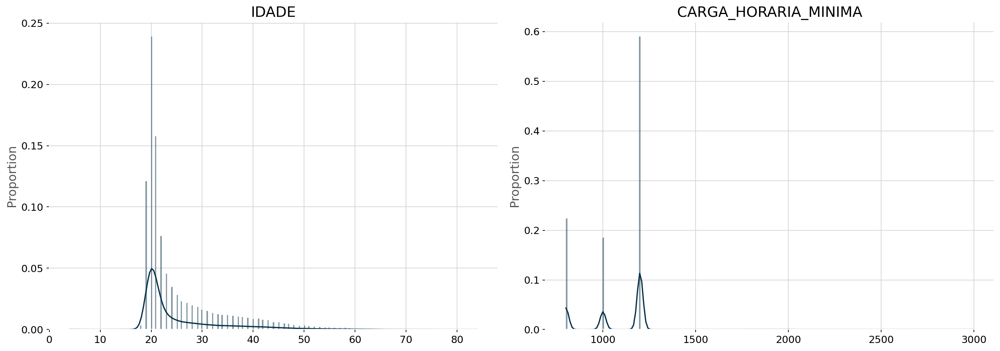

In [22]:
analysis_plots(data=df, features=numplots_features, kde=True, figsize=(25, 6))

In [24]:
def check_outliers(df, features):
        outlier_counts = {}
        outlier_indexes = {}
        total_outliers = 0
        
        for feature in features:
            Q1 = df[feature].quantile(0.25)
            Q3 = df[feature].quantile(0.75)
            
            IQR = Q3 - Q1
            
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            
            feature_outliers = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)]
            outlier_indexes[feature] = feature_outliers.index.tolist()
            outlier_count = len(feature_outliers)
            outlier_counts[feature] = outlier_count
            total_outliers += outlier_count
        
        print(f'Existem {total_outliers} outliers no dataset.')
        print()
        print(f'Número (percentual) de outliers por feature: ')
        print()
        for feature, count in outlier_counts.items():
            print(f'{feature}: {count} ({round(count/len(df)*100, 2)})%')

        return outlier_indexes, outlier_counts, total_outliers

In [25]:
outlier_indexes, outlier_counts, total_outliers = check_outliers(df=df, features=numplots_features)

Existem 15798 outliers no dataset.

Número (percentual) de outliers por feature: 

IDADE: 15660 (10.74)%
CARGA_HORARIA_MINIMA: 138 (0.09)%


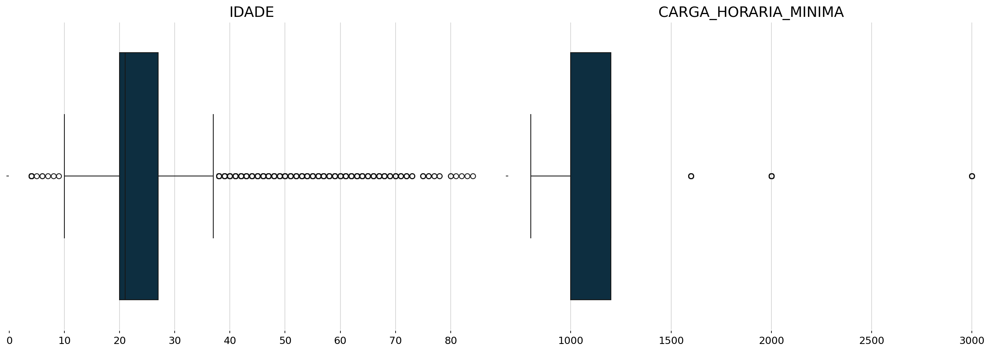

In [26]:
analysis_plots(data=df, features=numplots_features, outliers=True, figsize=(25, 6))

In [27]:
for coluna in df:
    print(f"{coluna}: {df[coluna].unique()}")
    print()

CATEGORIA_SITUACAO: ['Concluídos' 'Evadidos' 'Em Curso']

COR_RACA: ['Branca' 'Preta' 'Não declarada' 'Parda' 'Amarela' 'Indígena']

IDADE: [29 26 25 24 27 12 23 22 47 41 37 36 18 45 31 53 28 34 35 43 30 39 42 32
 52 54 48 49 21 55 38 33 51 20 62 58 50 60 19 40 44 46 56 61 11 68 57 59
 64 69 17 10 72 71 16 66 76 67 63 15 75 78 84 13 65 70  6 73 14  9 77 80
  4 82  5 81 83  7  8]

SEXO: ['Feminino' 'Masculino' 'S/I']

RENDA_FAMILIAR: ['0,5<RFP<=1' 'Não declarada' '0<RFP<=0,5' '1,5<RFP<=2,5' '1<RFP<=1,5'
 '2,5<RFP<=3,5' 'RFP>3,5']

MODALIDADE_DE_ENSINO: ['Educação Presencial' 'Educação a Distância']

TIPO_DE_OFERTA: ['Concomitante' 'Subsequente' 'Integrado' 'PROEJA - Integrado'
 'PROEJA - Concomitante' 'PROEJA - Subsequente']

TURNO: ['Noturno' 'Matutino' 'Vespertino' 'Integral' 'Não se aplica']

NOME_DE_CURSO: ['Técnico em Química' 'Técnico em Mineração' 'Técnico em Farmácia'
 'Técnico em Eletrotécnica' 'Técnico em Informática'
 'Técnico em Eletromecânica' 'Técnico em Edificações'
 'Téc

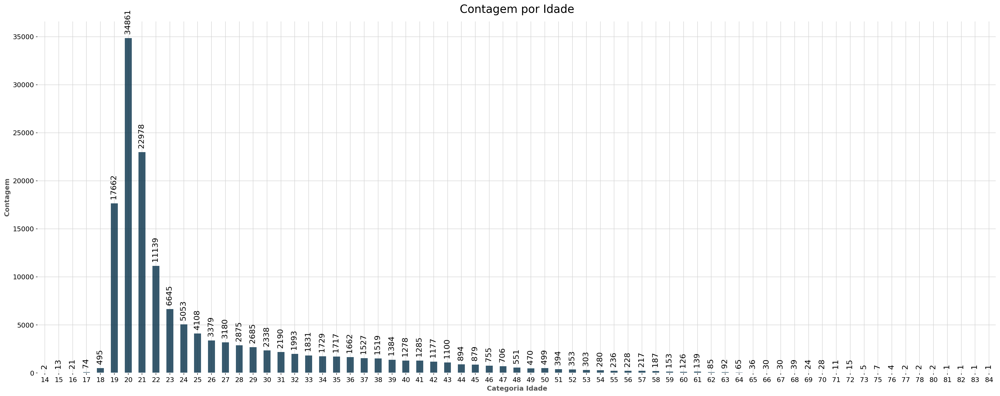

In [41]:
# Contabilizando a variável numérica Idade
contagem_absoluta = df['IDADE'].value_counts().sort_index()
contagem_percentual = df['IDADE'].value_counts(normalize=True).sort_index().mul(100).round(1)

# Gerando o gráfico de barras
plt.figure(figsize=(25, 10))
ax = contagem_absoluta.plot(kind='bar', color='#053048', alpha=0.8)

# Títulos e rótulos
plt.title('Contagem por Idade',fontsize=20, pad=15, loc='center')
plt.xlabel('Categoria Idade', fontsize=12, fontweight='bold')
plt.ylabel('Contagem', fontsize=12, fontweight='bold')

# Adicionando os valores absolutos e percentuais acima das barras
for i, (valor_abs, valor_perc) in enumerate(zip(contagem_absoluta, contagem_percentual)):
    ax.text(i, valor_abs + 1, f'  {valor_abs}', fontsize=14, ha='center', rotation='vertical', color='black')  # Valor absoluto

# Ajustando o layout
plt.xticks(fontsize=12, rotation=0)
plt.tight_layout()

# Exibindo o gráfico
plt.show()

In [42]:
#Identificado quantidade de idade inferiores menores de 13 anos e superiores a 100 anos de idade.
dfOutliers = df[(df['IDADE'].between(-100, 13))] 
dfOutliers2 = df[(df['IDADE'] >= 100)]
print(dfOutliers['IDADE'].value_counts(ascending=True).reset_index())
print(dfOutliers2['IDADE'].value_counts(ascending=True).reset_index())
print("----------------------")
print(dfOutliers.shape + dfOutliers2.shape)



Empty DataFrame
Columns: [IDADE, count]
Index: []
Empty DataFrame
Columns: [IDADE, count]
Index: []
----------------------
(0, 17, 0, 17)


In [43]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145751.0,25.291442,8.462015,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145751.0,1074.322646,168.629477,800.0,1000.0,1200.0,1200.0,3000.0


In [44]:
# Excluir linhas com idades entre -100 e 13 amos
df.drop(df[df['IDADE'].between(-100, 13)].index, axis=0, inplace=True)


In [45]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145751.0,25.291442,8.462015,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145751.0,1074.322646,168.629477,800.0,1000.0,1200.0,1200.0,3000.0


In [46]:
# Excluir linhas com idades maior que 120 anos
df.drop(df[df['IDADE'] >= 120].index, axis=0, inplace=True)


In [47]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145751.0,25.291442,8.462015,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145751.0,1074.322646,168.629477,800.0,1000.0,1200.0,1200.0,3000.0


In [48]:
df.shape

(145751, 17)

    IDADE  count
0      83      1
1      81      1
2      84      1
3      82      1
4      77      2
..    ...    ...
64     23   6645
65     22  11139
66     19  17662
67     21  22978
68     20  34861

[69 rows x 2 columns]


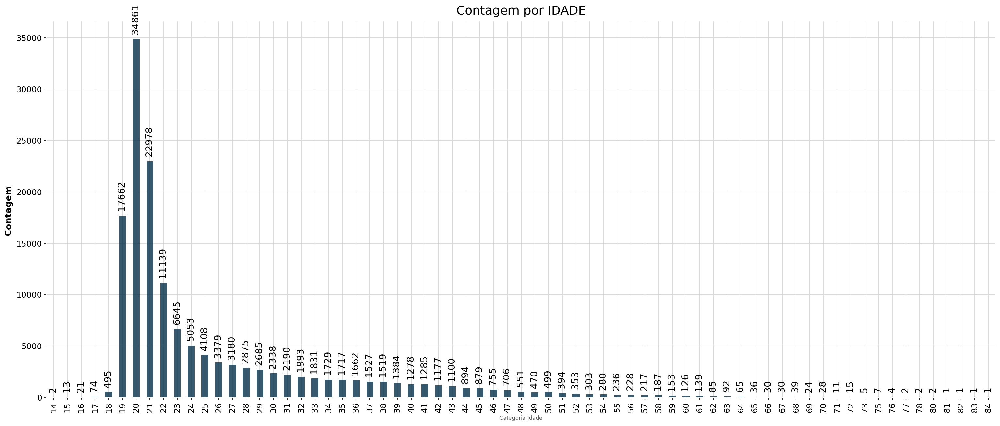

In [49]:
#Contabilizando a variável numérica idade sem outliers
print(df['IDADE'].value_counts(ascending=True).reset_index())

contagem = df['IDADE'].value_counts().sort_index()

# Gerando o gráfico de barras
plt.figure(figsize=(25, 10))
ax = contagem.plot(kind='bar', color='#053048', alpha=0.8)

plt.title('Contagem por IDADE', fontsize=18, pad=10, loc='center')
plt.xlabel('Categoria Idade', fontsize=8)
plt.ylabel('Contagem ', fontsize=13, fontweight='bold', ha='center', color='black')

# Adicionando os valores absolutos e percentuais acima das barras
for i, (valor) in enumerate(contagem):
    ax.text(i, valor + 1, f'  {valor}', fontsize=14, ha='center', rotation='vertical', color='black')  # Valor absoluto
plt.show()

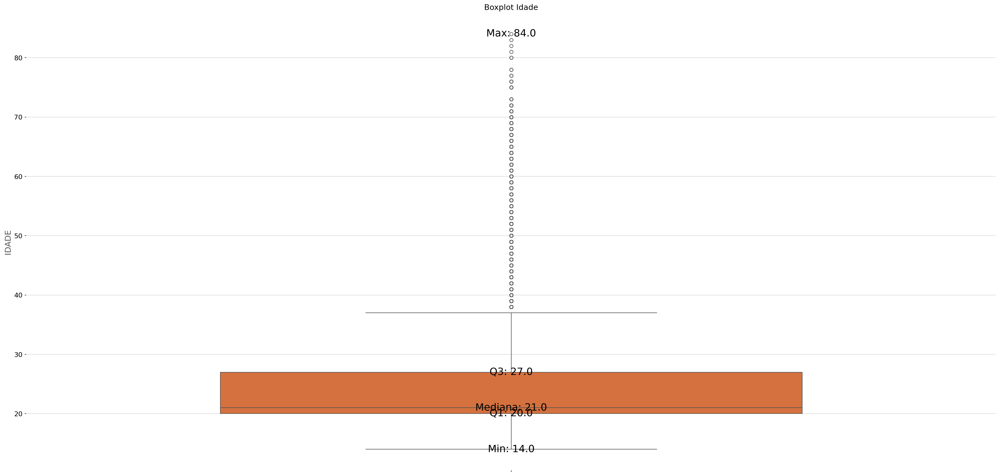

In [40]:
# Boxplot de distribuição das variáveis - (Idade) 

plt.figure(figsize=(25, 12))

# Boxplot de Idade
plt.subplot(1, 1, 1)
sns.boxplot(y=df["IDADE"], color='#ed6925', width=0.6)
plt.title("Boxplot Idade", fontdict={'fontsize': 14})

# Calcula valores estatísticos para Idade
idade_stats = df['IDADE'].describe()
plt.text(0, idade_stats['50%'], f"Mediana: {idade_stats['50%']:.1f}",
         color="black", ha="center", va="center", fontsize=18)
plt.text(0, idade_stats['25%'], f"Q1: {idade_stats['25%']:.1f}",
         color="black", ha="center", va="center", fontsize=18)
plt.text(0, idade_stats['75%'], f"Q3: {idade_stats['75%']:.1f}",
         color="black", ha="center", va="center", fontsize=18)
plt.text(0, idade_stats['min'], f"Min: {idade_stats['min']:.1f}",
         color="black", ha="center", va="center", fontsize=18)
plt.text(0, idade_stats['max'], f"Max: {idade_stats['max']:.1f}",
         color="black", ha="center", va="center", fontsize=18)

plt.tight_layout()
plt.show()


As proporções de outliers na variável CARGA_HORARIA_MINNA não representam informações inconsistentes, como erros de medição, não serão removidos.

In [31]:
#Identifcação de valores nulos
df.isnull().sum()

CATEGORIA_SITUACAO       0
COR_RACA                 0
IDADE                    0
SEXO                     0
RENDA_FAMILIAR           0
MODALIDADE_DE_ENSINO     0
TIPO_DE_OFERTA           0
TURNO                    0
NOME_DE_CURSO            0
EIXO_TECNOLOGICO         0
CARGA_HORARIA_MINIMA     0
UF                       0
MUNICIPIO                0
REGIAO                   0
INSTITUICAO              0
UNIDADE_DE_ENSINO        0
REGIÃO_METROPOLINA_UE    0
dtype: int64

In [32]:
df.shape

(145751, 17)

In [24]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Criar subplots com dois gráficos lado a lado
fig = make_subplots(
    rows=1,
    cols=1,
    subplot_titles=[
        "Distribuição de Idade por Categoria da Situação e Sexo",
        ]
)

# Paleta de cores personalizada
color_map = {"Masculino": "#109BA8", "Feminino": "#AD8D5C", "S/I": "blue" }

# Adicionar boxplot para "IDADE"
for sexo in df["SEXO"].unique():
    filtered_data = df[df["SEXO"] == sexo]
    fig.add_trace(
        go.Box(
            x=filtered_data["CATEGORIA_SITUACAO"],
            y=filtered_data["IDADE"],
            name=f"Idade ({sexo})",
            marker_color=color_map[sexo]
        ),
        row=1,
        col=1
    )

# Ajustar layout do gráfico
fig.update_layout(
    width=1300,  # Largura total do gráfico
    height=800,  # Altura total do gráfico
    showlegend=True,
    legend_title=dict(text="Sexo", font=dict(size=14)),
    xaxis_title="Categoria da Situação",
    yaxis_title="Idade",
    font=dict(size=12)
)

# Exibir o gráfico
fig.show()


Insights:

Foi retirado os outliers de Idade. Por crer que são realmente erros de entrada de dados. Visto que, existia a ocorrência de idade negativas.
Foi retirado da base também alunos com idade inferior a 14 anos. Por considerar essa a idade mínima para um estudante realizar um curso técnico.

Insight gerados pelo chatGPT:

In [25]:
# Configuração da chave de API
from dotenv import load_dotenv
load_dotenv()
openai.api_key = os.getenv("OPENAI_API_KEY")

# Enviar dados para GPT e obter insights
def gerar_insight(dados, descricao_grafico):
    prompt = f"""
    Analise o seguinte conjunto de dados e o gráfico descrito:
    Dados: {dados}
    Descrição do gráfico: {descricao_grafico}
    Forneça cinco insights relevantes.
    """
    response = openai.ChatCompletion.create(
        model="gpt-4o-mini",
        messages=[{"role": "system", "content": "Você é um analista de dados."},
                  {"role": "user", "content": prompt}],
        temperature=0.7,
        max_tokens=500  # Limite o tamanho da resposta
    )
    return response['choices'][0]['message']['content']
dados_filtrados = df[df['SEXO'] == 'MASCULINO']
# Exemplo de uso
descricao = "O gráfico apresenta a distribuição de valores por categoria."
insight = gerar_insight(df['IDADE'].head(10000).to_dict(), descricao)
print("Insight do GPT:")
print(insight)

Insight do GPT:
1. **Distribuição Geral dos Valores**: A maioria dos valores no conjunto de dados concentra-se em torno de 20 a 30, com uma alta frequência de valores em torno de 21, 22, 23, 24, e 25. Isso sugere que a maior parte das categorias está associada a valores relativamente baixos, indicando uma possível normalidade na distribuição dos dados. 

2. **Valores Extremamente Altos**: Existem alguns valores extremos, como 62, 68, 55, 58 e 54, que estão significativamente acima da média dos dados. Esses picos podem indicar categorias que possuem características únicas ou anomalias que merecem investigação adicional. Por exemplo, o valor 62 pode representar um evento ou uma categoria atípica que não segue a tendência geral.

3. **Tendência Decrescente em Categorias Altas**: À medida que os valores aumentam, a frequência de ocorrência diminui. Isso é evidente ao observar que, após os valores em torno de 25, a quantidade de categorias com valores mais altos (como 30, 40, 50 e 60) é bas

#### 3.1.2 Substituição de valores nas colunas (Cor/Raça)

In [50]:
df.columns

Index(['CATEGORIA_SITUACAO', 'COR_RACA', 'IDADE', 'SEXO', 'RENDA_FAMILIAR',
       'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA', 'TURNO', 'NOME_DE_CURSO',
       'EIXO_TECNOLOGICO', 'CARGA_HORARIA_MINIMA', 'UF', 'MUNICIPIO', 'REGIAO',
       'INSTITUICAO', 'UNIDADE_DE_ENSINO', 'REGIÃO_METROPOLINA_UE'],
      dtype='object')

In [51]:
# renomear o dataset para daqui pra frente realizar diversos ajustes na base de dados.
data = df

In [52]:
data.shape

(145751, 17)

In [53]:
data['TIPO_DE_OFERTA'].value_counts()

TIPO_DE_OFERTA
Integrado                80605
Subsequente              48907
Concomitante              9793
PROEJA - Integrado        5942
PROEJA - Concomitante      271
PROEJA - Subsequente       233
Name: count, dtype: int64

In [54]:
# # Substituição de valores nas colunas Tipo de oferta e cor/raça
# data["TIPO_DE_OFERTA"] = data["TIPO_DE_OFERTA"].map({"Subsequente": 'Subsequente', "PROEJA - Subsequente": 'Subsequente', "Concomitante": 'Concomitante',
#                                                     "PROEJA - Concomitante": 'Concomitante', "Integrado": 'Integrado', "PROEJA - Integrado": 'Integrado'})
# data["COR_RACA"] = data["COR_RACA"].map({"Preta": 'Preta', "Parda": 'Parda', "Indígena": 'Indígena',
#                                         "Não declarada": 'Não declarada', "Amarela": 'Amarela/Branca', "Branca": 'Amarela/Branca'})
# Substituição de valores na  coluna  cor/raça
data["COR_RACA"] = data["COR_RACA"].map({"Preta": 'Preta', "Parda": 'Parda', "Indígena": 'Indígena',
                                        "Não declarada": 'Não declarada', "Amarela": 'Amarela/Branca', "Branca": 'Amarela/Branca'})

In [55]:
# novos valores para a variável cor/raça. As cores/raças Amarela/Branca foram juntadas no dataset.
data['COR_RACA'].value_counts()

COR_RACA
Parda             63051
Amarela/Branca    47274
Não declarada     20796
Preta             13696
Indígena            934
Name: count, dtype: int64

In [56]:
data['IDADE'].value_counts()


IDADE
20    34861
21    22978
19    17662
22    11139
23     6645
      ...  
80        2
84        1
82        1
81        1
83        1
Name: count, Length: 69, dtype: int64

In [57]:
for coluna in data.select_dtypes(include="object"):
    print(f"{coluna}: {data[coluna].unique()}")
    print()

CATEGORIA_SITUACAO: ['Concluídos' 'Evadidos' 'Em Curso']

COR_RACA: ['Amarela/Branca' 'Preta' 'Não declarada' 'Parda' 'Indígena']

SEXO: ['Feminino' 'Masculino']

RENDA_FAMILIAR: ['0,5<RFP<=1' 'Não declarada' '0<RFP<=0,5' '1,5<RFP<=2,5' '1<RFP<=1,5'
 '2,5<RFP<=3,5' 'RFP>3,5']

MODALIDADE_DE_ENSINO: ['Educação Presencial' 'Educação a Distância']

TIPO_DE_OFERTA: ['Concomitante' 'Subsequente' 'Integrado' 'PROEJA - Integrado'
 'PROEJA - Concomitante' 'PROEJA - Subsequente']

TURNO: ['Noturno' 'Matutino' 'Vespertino' 'Integral' 'Não se aplica']

NOME_DE_CURSO: ['Técnico em Química' 'Técnico em Mineração' 'Técnico em Farmácia'
 'Técnico em Eletrotécnica' 'Técnico em Informática'
 'Técnico em Eletromecânica' 'Técnico em Edificações'
 'Técnico em Manutenção e Suporte em Informática'
 'Técnico em Informática para Internet' 'Técnico em Plásticos'
 'Técnico em Mecânica' 'Técnico em Controle Ambiental'
 'Técnico em Eletrônica' 'Técnico em Meio Ambiente'
 'Técnico em Automação Industrial' 'Técnico

In [58]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO       0
COR_RACA                 0
IDADE                    0
SEXO                     0
RENDA_FAMILIAR           0
MODALIDADE_DE_ENSINO     0
TIPO_DE_OFERTA           0
TURNO                    0
NOME_DE_CURSO            0
EIXO_TECNOLOGICO         0
CARGA_HORARIA_MINIMA     0
UF                       0
MUNICIPIO                0
REGIAO                   0
INSTITUICAO              0
UNIDADE_DE_ENSINO        0
REGIÃO_METROPOLINA_UE    0
dtype: int64

In [59]:
# Criação de arquivo csv com dataset numérico (dummy) - a ser usada no modelagem.
# data.to_csv('baseEficiencia1.csv', sep=';', encoding='utf-8')

#### 3.1.3 Retirada de colunas por questões computacionais

In [60]:
numerical_features = data.select_dtypes('number').columns.to_list()
print(f'Há {len(numerical_features)} variáveis numéricas')
print('Elas são:')
print(numerical_features)

Há 2 variáveis numéricas
Elas são:
['IDADE', 'CARGA_HORARIA_MINIMA']


In [61]:
categorical_features = data.select_dtypes('object').columns.to_list()
print(f'Há {len(categorical_features)} variáveis categoricas.')
print('São elas: ')
print(categorical_features)

Há 15 variáveis categoricas.
São elas: 
['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO', 'RENDA_FAMILIAR', 'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA', 'TURNO', 'NOME_DE_CURSO', 'EIXO_TECNOLOGICO', 'UF', 'MUNICIPIO', 'REGIAO', 'INSTITUICAO', 'UNIDADE_DE_ENSINO', 'REGIÃO_METROPOLINA_UE']


In [62]:
# Criação de arquivo csv com dataset categorico (Tratamento apenas em Idade ) - a ser usada no modelagem.
# data.to_csv('microdados_eficiencia_2023_todas_colunas_categoricas_CatBoostV1.csv', sep=';', encoding='utf-8')

In [63]:
# A necessidade de excluir é devido ao fato que essas variáveis apresenta algumas centenas de colunas
# Excluindo colunas categóricas desnecessárias
# colunas_excluidas = ['MUNICIPIO', 'UNIDADE_DE_ENSINO', 'NOME_DE_CURSO', 'UF', 'INSTITUICAO'] ## Deletando a Coluna original RENDA_FAMILIAR como categórica
# data.drop(columns=colunas_excluidas, axis=1, inplace=True)

colunas_excluidas = ['MUNICIPIO', 'UNIDADE_DE_ENSINO'] ## Deletando a Coluna original RENDA_FAMILIAR como categórica
data.drop(columns=colunas_excluidas, axis=1, inplace=True)

In [64]:
categorical_features = data.select_dtypes('object').columns.to_list()
print(f'Há {len(categorical_features)} variáveis categoricas.')
print('São elas: ')
print(categorical_features)

Há 13 variáveis categoricas.
São elas: 
['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO', 'RENDA_FAMILIAR', 'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA', 'TURNO', 'NOME_DE_CURSO', 'EIXO_TECNOLOGICO', 'UF', 'REGIAO', 'INSTITUICAO', 'REGIÃO_METROPOLINA_UE']


In [65]:
data

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,REGIAO,INSTITUICAO,REGIÃO_METROPOLINA_UE
0,Concluídos,Amarela/Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal do Rio de Janeiro,SIM
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Sul,Instituto Federal Sul-rio-grandense,NÃO
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Nordeste,Instituto Federal do Rio Grande do Norte,SIM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145826,Em Curso,Parda,28,Masculino,"1,5<RFP<=2,5",Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Sudeste,Instituto Federal do Sul de Minas Gerais,NÃO
145827,Concluídos,Não declarada,20,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,GO,Centro-Oeste,Instituto Federal de Goiás,SIM
145828,Concluídos,Amarela/Branca,19,Feminino,"0,5<RFP<=1",Educação Presencial,Integrado,Vespertino,Técnico em Informática,Informação e Comunicação,1000,MS,Centro-Oeste,Instituto Federal do Mato Grosso do Sul,NÃO
145829,Concluídos,Não declarada,22,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Agropecuária,Recursos Naturais,1200,MA,Nordeste,Instituto Federal do Maranhão,NÃO


In [66]:
#Variáveis a serem trabalhadas
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   CATEGORIA_SITUACAO     145751 non-null  object
 1   COR_RACA               145751 non-null  object
 2   IDADE                  145751 non-null  int64 
 3   SEXO                   145751 non-null  object
 4   RENDA_FAMILIAR         145751 non-null  object
 5   MODALIDADE_DE_ENSINO   145751 non-null  object
 6   TIPO_DE_OFERTA         145751 non-null  object
 7   TURNO                  145751 non-null  object
 8   NOME_DE_CURSO          145751 non-null  object
 9   EIXO_TECNOLOGICO       145751 non-null  object
 10  CARGA_HORARIA_MINIMA   145751 non-null  int64 
 11  UF                     145751 non-null  object
 12  REGIAO                 145751 non-null  object
 13  INSTITUICAO            145751 non-null  object
 14  REGIÃO_METROPOLINA_UE  145751 non-null  object
dtypes: in

In [67]:
# Criação de arquivo csv com dataset numérico (dummy) - a ser usada no modelagem.
data.to_csv('BaseEvasao_ajustada.csv', sep=';', encoding='utf-8')

In [68]:
for coluna in data.select_dtypes(include="number"):
    print(f"{coluna}: {data[coluna].unique()}")
    print()

IDADE: [29 26 25 24 27 23 22 47 41 37 36 18 45 31 53 28 34 35 43 30 39 42 32 52
 54 48 49 21 55 38 33 51 20 62 58 50 60 19 40 44 46 56 61 68 57 59 64 69
 17 72 71 16 66 76 67 63 15 75 78 84 65 70 73 14 77 80 82 81 83]

CARGA_HORARIA_MINIMA: [1200 1000  800 2000 3000 1600]



#### 3.1.4 Ordenação e substituição de valores com uso de OrdinalEncoder (Renda Familiar)

In [69]:
# Categorizar Renda Familiar com uso de OrdinalEncoder
from sklearn.preprocessing import OrdinalEncoder

In [70]:
# Ordenação definida para a variável Renda Familiar com base na progressão das faixas salariais:
ordenarRenda = ['Não declarada', '0<RFP<=0,5', '0,5<RFP<=1', '1<RFP<=1,5', '1,5<RFP<=2,5', '2,5<RFP<=3,5', 'RFP>3,5']

In [71]:
rendaFamiliarOrdenado = OrdinalEncoder(categories=[ordenarRenda])

In [72]:
rendaFamiliarOrdenado.fit_transform(data[['RENDA_FAMILIAR']])

array([[2.],
       [0.],
       [0.],
       ...,
       [2.],
       [0.],
       [0.]])

In [73]:
data['_Renda_Familiar_Ord'] = rendaFamiliarOrdenado.transform(data[['RENDA_FAMILIAR']])
data.head()

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,REGIAO,INSTITUICAO,REGIÃO_METROPOLINA_UE,_Renda_Familiar_Ord
0,Concluídos,Amarela/Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,2.0
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,0.0
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal do Rio de Janeiro,SIM,0.0
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Sul,Instituto Federal Sul-rio-grandense,NÃO,0.0
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Nordeste,Instituto Federal do Rio Grande do Norte,SIM,1.0


In [74]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 16 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   CATEGORIA_SITUACAO     145751 non-null  object 
 1   COR_RACA               145751 non-null  object 
 2   IDADE                  145751 non-null  int64  
 3   SEXO                   145751 non-null  object 
 4   RENDA_FAMILIAR         145751 non-null  object 
 5   MODALIDADE_DE_ENSINO   145751 non-null  object 
 6   TIPO_DE_OFERTA         145751 non-null  object 
 7   TURNO                  145751 non-null  object 
 8   NOME_DE_CURSO          145751 non-null  object 
 9   EIXO_TECNOLOGICO       145751 non-null  object 
 10  CARGA_HORARIA_MINIMA   145751 non-null  int64  
 11  UF                     145751 non-null  object 
 12  REGIAO                 145751 non-null  object 
 13  INSTITUICAO            145751 non-null  object 
 14  REGIÃO_METROPOLINA_UE  145751 non-null  o

In [75]:
# Alterando a nova coluna para Int64
data["_Renda_Familiar_Ord"] = data["_Renda_Familiar_Ord"].astype("Int64")

In [76]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 16 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   CATEGORIA_SITUACAO     145751 non-null  object
 1   COR_RACA               145751 non-null  object
 2   IDADE                  145751 non-null  int64 
 3   SEXO                   145751 non-null  object
 4   RENDA_FAMILIAR         145751 non-null  object
 5   MODALIDADE_DE_ENSINO   145751 non-null  object
 6   TIPO_DE_OFERTA         145751 non-null  object
 7   TURNO                  145751 non-null  object
 8   NOME_DE_CURSO          145751 non-null  object
 9   EIXO_TECNOLOGICO       145751 non-null  object
 10  CARGA_HORARIA_MINIMA   145751 non-null  int64 
 11  UF                     145751 non-null  object
 12  REGIAO                 145751 non-null  object
 13  INSTITUICAO            145751 non-null  object
 14  REGIÃO_METROPOLINA_UE  145751 non-null  object
 15  _Rend

In [77]:
data

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,REGIAO,INSTITUICAO,REGIÃO_METROPOLINA_UE,_Renda_Familiar_Ord
0,Concluídos,Amarela/Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,2
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,0
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal do Rio de Janeiro,SIM,0
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Sul,Instituto Federal Sul-rio-grandense,NÃO,0
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Nordeste,Instituto Federal do Rio Grande do Norte,SIM,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145826,Em Curso,Parda,28,Masculino,"1,5<RFP<=2,5",Educação a Distância,Subsequente,Não se aplica,Técnico em Manutenção e Suporte em Informática,Informação e Comunicação,1000,MG,Sudeste,Instituto Federal do Sul de Minas Gerais,NÃO,4
145827,Concluídos,Não declarada,20,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Eletrotécnica,Controle e Processos Industriais,1200,GO,Centro-Oeste,Instituto Federal de Goiás,SIM,0
145828,Concluídos,Amarela/Branca,19,Feminino,"0,5<RFP<=1",Educação Presencial,Integrado,Vespertino,Técnico em Informática,Informação e Comunicação,1000,MS,Centro-Oeste,Instituto Federal do Mato Grosso do Sul,NÃO,2
145829,Concluídos,Não declarada,22,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Agropecuária,Recursos Naturais,1200,MA,Nordeste,Instituto Federal do Maranhão,NÃO,0


In [78]:
#Contabilizando a Renda Familiar
print(df['_Renda_Familiar_Ord'].value_counts())
print('----------------------')
print(df['_Renda_Familiar_Ord'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')

_Renda_Familiar_Ord
0    41476
1    39325
2    27250
3    18522
4    10496
6     4618
5     4064
Name: count, dtype: Int64
----------------------
_Renda_Familiar_Ord
0    28.5%
1    27.0%
2    18.7%
3    12.7%
4     7.2%
6     3.2%
5     2.8%
Name: proportion, dtype: object


In [79]:
# Inserir gráfico da nova categórização de Renda Familiar

#### 3.1.5 Quantidade de registros com ajustes no Dataset

In [80]:
#Contabilizando a variável target
print(data['CATEGORIA_SITUACAO'].value_counts())
print('----------------------')
print(data['CATEGORIA_SITUACAO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável idade dos alubnos
print(data['IDADE'].value_counts())
print('----------------------')
print(data['IDADE'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável cor/raça dos alunos
print(data['COR_RACA'].value_counts())
print('----------------------')
print(data['COR_RACA'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável sexo dos alunos
print(data['SEXO'].value_counts())
print('----------------------')
print(data['SEXO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Renda Familiar dos alunos
print(data['RENDA_FAMILIAR'].value_counts())
print('----------------------')
print(data['RENDA_FAMILIAR'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Modalidade de Ensino dos cursos
print(data['MODALIDADE_DE_ENSINO'].value_counts())
print('----------------------')
print(data['MODALIDADE_DE_ENSINO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Tipo de Oferta dos cursos
print(data['TIPO_DE_OFERTA'].value_counts())
print('----------------------')
print(data['TIPO_DE_OFERTA'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Turno dos cursos
print(data['TURNO'].value_counts())
print('----------------------')
print(data['TURNO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando os cursos
# print(data['NOME_DE_CURSO'].value_counts())
# print('----------------------')
# print(data['NOME_DE_CURSO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
# print('-------------------------------------------------------------')

# #Contabilizando os UF 
# print(data['UF'].value_counts())
# print('----------------------')
# print(data['UF'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
# print('-------------------------------------------------------------')

# #Contabilizando os municípios
# print(data['MUNICIPIO'].value_counts())
# print('----------------------')
# print(data['MUNICIPIO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
# print('-------------------------------------------------------------')

#Contabilizando a Região geográfica das escolas
print(data['REGIAO'].value_counts())
print('----------------------')
print(data['REGIAO'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')
#Contabilizando a Região metropolitana das escolas
print(data['REGIÃO_METROPOLINA_UE'].value_counts())
print('----------------------')
print(data['REGIÃO_METROPOLINA_UE'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')


CATEGORIA_SITUACAO
Concluídos    68540
Evadidos      60243
Em Curso      16968
Name: count, dtype: int64
----------------------
CATEGORIA_SITUACAO
Concluídos    47.0%
Evadidos      41.3%
Em Curso      11.6%
Name: proportion, dtype: object
-------------------------------------------------------------
IDADE
20    34861
21    22978
19    17662
22    11139
23     6645
      ...  
80        2
84        1
82        1
81        1
83        1
Name: count, Length: 69, dtype: int64
----------------------
IDADE
20    23.9%
21    15.8%
19    12.1%
22     7.6%
23     4.6%
      ...  
80     0.0%
84     0.0%
82     0.0%
81     0.0%
83     0.0%
Name: proportion, Length: 69, dtype: object
-------------------------------------------------------------
COR_RACA
Parda             63051
Amarela/Branca    47274
Não declarada     20796
Preta             13696
Indígena            934
Name: count, dtype: int64
----------------------
COR_RACA
Parda             43.3%
Amarela/Branca    32.4%
Não declarada     14.

Médias (Categoria Situação de matrículas)

In [81]:
# Média de idade por categoria da situação:
data.groupby('CATEGORIA_SITUACAO')['IDADE'].mean()

CATEGORIA_SITUACAO
Concluídos    23.243303
Em Curso      27.091938
Evadidos      27.114536
Name: IDADE, dtype: float64

In [82]:
# Média de idade por categoria da situação:
data.groupby('CATEGORIA_SITUACAO')['_Renda_Familiar_Ord'].mean()

CATEGORIA_SITUACAO
Concluídos    1.837059
Em Curso      1.526167
Evadidos      1.454028
Name: _Renda_Familiar_Ord, dtype: Float64

In [83]:
# Média de idade por categoria da situação:
data.groupby('CATEGORIA_SITUACAO')['CARGA_HORARIA_MINIMA'].mean()

CATEGORIA_SITUACAO
Concluídos    1073.545375
Em Curso      1086.374352
Evadidos      1071.812493
Name: CARGA_HORARIA_MINIMA, dtype: float64

#### 3.1.4.1 Características dos dados

Analisando algumas estatísticas descritivas.

In [84]:
# df.describe().T
data.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145751.0,25.291442,8.462015,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145751.0,1074.322646,168.629477,800.0,1000.0,1200.0,1200.0,3000.0
_Renda_Familiar_Ord,145751.0,1.642548,1.566318,0.0,0.0,1.0,3.0,6.0


Alguns insights:

1. A idade média é de aproximadamente 23 anos. Metade dos alunos tem entre 18 e 26 anos, indicando um perfil mais jovem.
2. Em média, os alunos realizam cursos técnicos que tem 1091 horas de carga horária mínima.

Além disso, observando os valores mínimos e máximos, parece que não há valores inconsistentes.

Observando valores ausentes e duplicados.

In [85]:
data.isna().sum()

CATEGORIA_SITUACAO       0
COR_RACA                 0
IDADE                    0
SEXO                     0
RENDA_FAMILIAR           0
MODALIDADE_DE_ENSINO     0
TIPO_DE_OFERTA           0
TURNO                    0
NOME_DE_CURSO            0
EIXO_TECNOLOGICO         0
CARGA_HORARIA_MINIMA     0
UF                       0
REGIAO                   0
INSTITUICAO              0
REGIÃO_METROPOLINA_UE    0
_Renda_Familiar_Ord      0
dtype: int64

In [86]:
data.duplicated().sum()

40715

Não há valores ausentes. Quanto aos valores duplicados serão mantido visto que, não configura-se registro duplicados no dataset, e sim, alunos com caractéristicas idênticas.

- Foi descartado a variável código de matrícula do dataset original porque possui um valor único para cada registro, porém, não sendo útil para a análise.
- Será renomeado as colunas em um formato padrão para facilitar a manipulação dos dados. Além disso, a variável CATEGORIA_SITUACAO será renomeada como evadido para fins de interpretação.
- As variáveis IDADE e CARGA_HORARIA_MINIMA mínima será expressas como binárias. Isso facilitará a análise exploratória de dados (EDA), como ao observar valores percentuais.

In [87]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 16 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   CATEGORIA_SITUACAO     145751 non-null  object
 1   COR_RACA               145751 non-null  object
 2   IDADE                  145751 non-null  int64 
 3   SEXO                   145751 non-null  object
 4   RENDA_FAMILIAR         145751 non-null  object
 5   MODALIDADE_DE_ENSINO   145751 non-null  object
 6   TIPO_DE_OFERTA         145751 non-null  object
 7   TURNO                  145751 non-null  object
 8   NOME_DE_CURSO          145751 non-null  object
 9   EIXO_TECNOLOGICO       145751 non-null  object
 10  CARGA_HORARIA_MINIMA   145751 non-null  int64 
 11  UF                     145751 non-null  object
 12  REGIAO                 145751 non-null  object
 13  INSTITUICAO            145751 non-null  object
 14  REGIÃO_METROPOLINA_UE  145751 non-null  object
 15  _Rend

In [88]:
#Identifcação de valores nulos
data.nunique()

CATEGORIA_SITUACAO         3
COR_RACA                   5
IDADE                     69
SEXO                       2
RENDA_FAMILIAR             7
MODALIDADE_DE_ENSINO       2
TIPO_DE_OFERTA             6
TURNO                      5
NOME_DE_CURSO            140
EIXO_TECNOLOGICO          13
CARGA_HORARIA_MINIMA       6
UF                        27
REGIAO                     5
INSTITUICAO               62
REGIÃO_METROPOLINA_UE      2
_Renda_Familiar_Ord        7
dtype: int64

In [89]:
for coluna in data.select_dtypes(include="object"):
    print(f"{coluna}: {data[coluna].unique()}")
    # print(f"{coluna}.cat.categories: {df_categorizado[coluna].cat.categories}")
    # print(f"{coluna}.cat.ordered: {df_categorizado[coluna].cat.ordered}")
    print()

CATEGORIA_SITUACAO: ['Concluídos' 'Evadidos' 'Em Curso']

COR_RACA: ['Amarela/Branca' 'Preta' 'Não declarada' 'Parda' 'Indígena']

SEXO: ['Feminino' 'Masculino']

RENDA_FAMILIAR: ['0,5<RFP<=1' 'Não declarada' '0<RFP<=0,5' '1,5<RFP<=2,5' '1<RFP<=1,5'
 '2,5<RFP<=3,5' 'RFP>3,5']

MODALIDADE_DE_ENSINO: ['Educação Presencial' 'Educação a Distância']

TIPO_DE_OFERTA: ['Concomitante' 'Subsequente' 'Integrado' 'PROEJA - Integrado'
 'PROEJA - Concomitante' 'PROEJA - Subsequente']

TURNO: ['Noturno' 'Matutino' 'Vespertino' 'Integral' 'Não se aplica']

NOME_DE_CURSO: ['Técnico em Química' 'Técnico em Mineração' 'Técnico em Farmácia'
 'Técnico em Eletrotécnica' 'Técnico em Informática'
 'Técnico em Eletromecânica' 'Técnico em Edificações'
 'Técnico em Manutenção e Suporte em Informática'
 'Técnico em Informática para Internet' 'Técnico em Plásticos'
 'Técnico em Mecânica' 'Técnico em Controle Ambiental'
 'Técnico em Eletrônica' 'Técnico em Meio Ambiente'
 'Técnico em Automação Industrial' 'Técnico

In [141]:
data.head()

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,CARGA_HORARIA_MINIMA,UF,REGIAO,INSTITUICAO,REGIÃO_METROPOLINA_UE,_Renda_Familiar_Ord
0,Concluídos,Amarela/Branca,29,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,2
1,Evadidos,Preta,29,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal Fluminense,NÃO,0
2,Concluídos,Não declarada,26,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,1200,RJ,Sudeste,Instituto Federal do Rio de Janeiro,SIM,0
3,Evadidos,Não declarada,25,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,1200,RS,Sul,Instituto Federal Sul-rio-grandense,NÃO,0
4,Evadidos,Parda,25,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,1200,RN,Nordeste,Instituto Federal do Rio Grande do Norte,SIM,1


In [53]:
data.describe()

,IDADE,CARGA_HORARIA_MINIMA,_Renda_Familiar_Ord
count,145751.000000,145751.000000,145751.0
mean,25.291442,1074.322646,1.642548
std,8.462015,168.629477,1.566318
min,14.000000,800.000000,0.0
25%,20.000000,1000.000000,0.0
50%,21.000000,1200.000000,1.0
75%,27.000000,1200.000000,3.0
max,84.000000,3000.000000,6.0


#### 3.1.5 Exclusão de variáveis categóricas (Diminuir o processamento da base de dados)

In [90]:
data.nunique()

CATEGORIA_SITUACAO         3
COR_RACA                   5
IDADE                     69
SEXO                       2
RENDA_FAMILIAR             7
MODALIDADE_DE_ENSINO       2
TIPO_DE_OFERTA             6
TURNO                      5
NOME_DE_CURSO            140
EIXO_TECNOLOGICO          13
CARGA_HORARIA_MINIMA       6
UF                        27
REGIAO                     5
INSTITUICAO               62
REGIÃO_METROPOLINA_UE      2
_Renda_Familiar_Ord        7
dtype: int64

In [91]:
# A necessidade de excluir
# Deletando a Coluna original MUNICIPIO como categórica
data = data.drop(['MUNICIPIO'], axis=1, inplace=True)
# Deletando a Coluna original UNIDADE_DE_ENSINO como categórica
data = data.drop(['UNIDADE_DE_ENSINO'], axis=1, inplace=True)
# Deletando a Coluna original NOME_DE_CURSO como categórica
data = data.drop(['NOME_DE_CURSO'], axis=1, inplace=True)
# Deletando a Coluna original UF como categórica
data = data.drop(['UF'], axis=1, inplace=True)
# Deletando a Coluna original INSTITUICAO como categórica
data = data.drop(['INSTITUICAO'], axis=1, inplace=True)

KeyError: "['MUNICIPIO'] not found in axis"

In [ ]:
# A necessidade de excluir é devido ao fato que essas variáveis apresenta algumas centenas de colunas
# Excluindo colunas categóricas desnecessárias
# colunas_excluidas = ['MUNICIPIO', 'UNIDADE_DE_ENSINO', 'NOME_DE_CURSO', 'UF', 'INSTITUICAO', 'RENDA_FAMILIAR'] ## Deletando a Coluna original RENDA_FAMILIAR como categórica
# data.drop(columns=colunas_excluidas, axis=1, inplace=True)

colunas_excluidas = ['RENDA_FAMILIAR'] ## Deletando a Coluna original RENDA_FAMILIAR como categórica
data.drop(columns=colunas_excluidas, axis=1, inplace=True)

In [ ]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO       0
COR_RACA                 0
IDADE                    0
SEXO                     0
MODALIDADE_DE_ENSINO     0
TIPO_DE_OFERTA           0
TURNO                    0
NOME_DE_CURSO            0
EIXO_TECNOLOGICO         0
CARGA_HORARIA_MINIMA     0
UF                       0
REGIAO                   0
INSTITUICAO              0
REGIÃO_METROPOLINA_UE    0
_Renda_Familiar_Ord      0
dtype: int64

In [ ]:
#Nova estrutura de colunas do Dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   CATEGORIA_SITUACAO     145751 non-null  object
 1   COR_RACA               145751 non-null  object
 2   IDADE                  145751 non-null  int64 
 3   SEXO                   145751 non-null  object
 4   MODALIDADE_DE_ENSINO   145751 non-null  object
 5   TIPO_DE_OFERTA         145751 non-null  object
 6   TURNO                  145751 non-null  object
 7   NOME_DE_CURSO          145751 non-null  object
 8   EIXO_TECNOLOGICO       145751 non-null  object
 9   CARGA_HORARIA_MINIMA   145751 non-null  int64 
 10  UF                     145751 non-null  object
 11  REGIAO                 145751 non-null  object
 12  INSTITUICAO            145751 non-null  object
 13  REGIÃO_METROPOLINA_UE  145751 non-null  object
 14  _Renda_Familiar_Ord    145751 non-null  Int64 
dtypes: In

In [ ]:
# Renomear a coluna _Renda_Familiar_Ord 
data.rename(columns={'_Renda_Familiar_Ord': 'RENDA_FAMILIAR_AJUSTADA'}, inplace=True)

In [ ]:
#Nova estrutura de colunas do Dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145751 entries, 0 to 145830
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   CATEGORIA_SITUACAO       145751 non-null  object
 1   COR_RACA                 145751 non-null  object
 2   IDADE                    145751 non-null  int64 
 3   SEXO                     145751 non-null  object
 4   MODALIDADE_DE_ENSINO     145751 non-null  object
 5   TIPO_DE_OFERTA           145751 non-null  object
 6   TURNO                    145751 non-null  object
 7   NOME_DE_CURSO            145751 non-null  object
 8   EIXO_TECNOLOGICO         145751 non-null  object
 9   CARGA_HORARIA_MINIMA     145751 non-null  int64 
 10  UF                       145751 non-null  object
 11  REGIAO                   145751 non-null  object
 12  INSTITUICAO              145751 non-null  object
 13  REGIÃO_METROPOLINA_UE    145751 non-null  object
 14  RENDA_FAMILIAR_AJUSTADA  

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145751.0,25.291442,8.462015,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145751.0,1074.322646,168.629477,800.0,1000.0,1200.0,1200.0,3000.0
RENDA_FAMILIAR_AJUSTADA,145751.0,1.642548,1.566318,0.0,0.0,1.0,3.0,6.0


In [ ]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO         0
COR_RACA                   0
IDADE                      0
SEXO                       0
MODALIDADE_DE_ENSINO       0
TIPO_DE_OFERTA             0
TURNO                      0
NOME_DE_CURSO              0
EIXO_TECNOLOGICO           0
CARGA_HORARIA_MINIMA       0
UF                         0
REGIAO                     0
INSTITUICAO                0
REGIÃO_METROPOLINA_UE      0
RENDA_FAMILIAR_AJUSTADA    0
dtype: int64

#### 3.1.6 Transformando variável categóricas em numéricas (OneHotEncoder)

In [92]:
# Importando OneHotEncoder
from sklearn.preprocessing import OneHotEncoder

In [93]:
#Inicializando OHE object
onehotencoder = OneHotEncoder()

In [94]:
variablesCategoricas = onehotencoder.fit(data[['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO',  'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA',
                                         'TURNO', 'EIXO_TECNOLOGICO', 'REGIAO', 'REGIÃO_METROPOLINA_UE']])

In [95]:
variablesCategoricas.transform(data[['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO',  'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA',
                                         'TURNO', 'EIXO_TECNOLOGICO', 'REGIAO', 'REGIÃO_METROPOLINA_UE']])

<145751x43 sparse matrix of type '<class 'numpy.float64'>'
	with 1311759 stored elements in Compressed Sparse Row format>

In [96]:
variablesCategoricas.transform(data[['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO',  'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA',
                                         'TURNO', 'EIXO_TECNOLOGICO', 'REGIAO', 'REGIÃO_METROPOLINA_UE']]).toarray()

array([[1., 0., 0., ..., 0., 1., 0.],
       [0., 0., 1., ..., 0., 1., 0.],
       [1., 0., 0., ..., 0., 0., 1.],
       ...,
       [1., 0., 0., ..., 0., 1., 0.],
       [1., 0., 0., ..., 0., 1., 0.],
       [1., 0., 0., ..., 0., 1., 0.]])

In [97]:
ohe_data = pd.DataFrame(variablesCategoricas.transform(data[['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO',  'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA',
                                         'TURNO', 'EIXO_TECNOLOGICO', 'REGIAO', 'REGIÃO_METROPOLINA_UE']]).toarray())

ohe_data

,0,1,2,3,4,5,6,7,8,9,...,33,34,35,36,37,38,39,40,41,42
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
4,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145746,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
145747,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
145748,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
145749,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


In [98]:
ohe_data.head()

,0,1,2,3,4,5,6,7,8,9,...,33,34,35,36,37,38,39,40,41,42
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
4,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [99]:
# Obtendo os nomes das colunas para o DataFrame resultante
colunas = variablesCategoricas.get_feature_names_out()
colunas

array(['CATEGORIA_SITUACAO_Concluídos', 'CATEGORIA_SITUACAO_Em Curso',
       'CATEGORIA_SITUACAO_Evadidos', 'COR_RACA_Amarela/Branca',
       'COR_RACA_Indígena', 'COR_RACA_Não declarada', 'COR_RACA_Parda',
       'COR_RACA_Preta', 'SEXO_Feminino', 'SEXO_Masculino',
       'MODALIDADE_DE_ENSINO_Educação Presencial',
       'MODALIDADE_DE_ENSINO_Educação a Distância',
       'TIPO_DE_OFERTA_Concomitante', 'TIPO_DE_OFERTA_Integrado',
       'TIPO_DE_OFERTA_PROEJA - Concomitante',
       'TIPO_DE_OFERTA_PROEJA - Integrado',
       'TIPO_DE_OFERTA_PROEJA - Subsequente',
       'TIPO_DE_OFERTA_Subsequente', 'TURNO_Integral', 'TURNO_Matutino',
       'TURNO_Noturno', 'TURNO_Não se aplica', 'TURNO_Vespertino',
       'EIXO_TECNOLOGICO_Ambiente e Saúde',
       'EIXO_TECNOLOGICO_Controle e Processos Industriais',
       'EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social',
       'EIXO_TECNOLOGICO_Gestão e Negócios',
       'EIXO_TECNOLOGICO_Informação e Comunicação',
       'EIXO_TECNOLOG

In [100]:
# Alteração do tipo para Int64
var_data = pd.DataFrame(variablesCategoricas.transform(data[['CATEGORIA_SITUACAO', 'COR_RACA', 'SEXO',  'MODALIDADE_DE_ENSINO', 'TIPO_DE_OFERTA',
                                         'TURNO', 'EIXO_TECNOLOGICO', 'REGIAO', 'REGIÃO_METROPOLINA_UE']]).toarray(),
                        columns=colunas,
                        dtype='int64'
                        )

In [101]:
var_data

,CATEGORIA_SITUACAO_Concluídos,CATEGORIA_SITUACAO_Em Curso,CATEGORIA_SITUACAO_Evadidos,COR_RACA_Amarela/Branca,COR_RACA_Indígena,COR_RACA_Não declarada,COR_RACA_Parda,COR_RACA_Preta,SEXO_Feminino,SEXO_Masculino,...,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_NÃO,REGIÃO_METROPOLINA_UE_SIM
0,1,0,0,1,0,0,0,0,1,0,...,0,0,0,0,0,0,1,0,1,0
1,0,0,1,0,0,0,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
2,1,0,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,1,0,0,1
3,0,0,1,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,1,1,0
4,0,0,1,0,0,0,1,0,1,0,...,1,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145746,0,1,0,0,0,0,1,0,0,1,...,0,0,0,0,0,0,1,0,1,0
145747,1,0,0,0,0,1,0,0,0,1,...,0,0,0,1,0,0,0,0,0,1
145748,1,0,0,1,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
145749,1,0,0,0,0,1,0,0,0,1,...,1,0,0,0,1,0,0,0,1,0


In [102]:
#Identifcação de valores nulos
var_data.isnull().sum()

CATEGORIA_SITUACAO_Concluídos                            0
CATEGORIA_SITUACAO_Em Curso                              0
CATEGORIA_SITUACAO_Evadidos                              0
COR_RACA_Amarela/Branca                                  0
COR_RACA_Indígena                                        0
COR_RACA_Não declarada                                   0
COR_RACA_Parda                                           0
COR_RACA_Preta                                           0
SEXO_Feminino                                            0
SEXO_Masculino                                           0
MODALIDADE_DE_ENSINO_Educação Presencial                 0
MODALIDADE_DE_ENSINO_Educação a Distância                0
TIPO_DE_OFERTA_Concomitante                              0
TIPO_DE_OFERTA_Integrado                                 0
TIPO_DE_OFERTA_PROEJA - Concomitante                     0
TIPO_DE_OFERTA_PROEJA - Integrado                        0
TIPO_DE_OFERTA_PROEJA - Subsequente                     

In [103]:
data = pd.concat([data, var_data], axis=1)

In [104]:
data.head()

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,...,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_NÃO,REGIÃO_METROPOLINA_UE_SIM
0,Concluídos,Amarela/Branca,29.0,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,Evadidos,Preta,29.0,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,Concluídos,Não declarada,26.0,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,Evadidos,Não declarada,25.0,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
4,Evadidos,Parda,25.0,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [105]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO                                       80
COR_RACA                                                 80
IDADE                                                    80
SEXO                                                     80
RENDA_FAMILIAR                                           80
MODALIDADE_DE_ENSINO                                     80
TIPO_DE_OFERTA                                           80
TURNO                                                    80
NOME_DE_CURSO                                            80
EIXO_TECNOLOGICO                                         80
CARGA_HORARIA_MINIMA                                     80
UF                                                       80
REGIAO                                                   80
INSTITUICAO                                              80
REGIÃO_METROPOLINA_UE                                    80
_Renda_Familiar_Ord                                      80
CATEGORIA_SITUACAO_Concluídos           

In [106]:
#Excluir os valores Nulos gerados pela junção dos dataset
data = data.dropna()

In [107]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO                                       0
COR_RACA                                                 0
IDADE                                                    0
SEXO                                                     0
RENDA_FAMILIAR                                           0
MODALIDADE_DE_ENSINO                                     0
TIPO_DE_OFERTA                                           0
TURNO                                                    0
NOME_DE_CURSO                                            0
EIXO_TECNOLOGICO                                         0
CARGA_HORARIA_MINIMA                                     0
UF                                                       0
REGIAO                                                   0
INSTITUICAO                                              0
REGIÃO_METROPOLINA_UE                                    0
_Renda_Familiar_Ord                                      0
CATEGORIA_SITUACAO_Concluídos                           

In [108]:
data.shape

(145671, 59)

In [109]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145671 entries, 0 to 145750
Data columns (total 59 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   CATEGORIA_SITUACAO                                     145671 non-null  object 
 1   COR_RACA                                               145671 non-null  object 
 2   IDADE                                                  145671 non-null  float64
 3   SEXO                                                   145671 non-null  object 
 4   RENDA_FAMILIAR                                         145671 non-null  object 
 5   MODALIDADE_DE_ENSINO                                   145671 non-null  object 
 6   TIPO_DE_OFERTA                                         145671 non-null  object 
 7   TURNO                                                  145671 non-null  object 
 8   NOME_DE_CURSO                          

In [110]:
data.nunique()

CATEGORIA_SITUACAO                                         3
COR_RACA                                                   5
IDADE                                                     69
SEXO                                                       2
RENDA_FAMILIAR                                             7
MODALIDADE_DE_ENSINO                                       2
TIPO_DE_OFERTA                                             6
TURNO                                                      5
NOME_DE_CURSO                                            140
EIXO_TECNOLOGICO                                          13
CARGA_HORARIA_MINIMA                                       6
UF                                                        27
REGIAO                                                     5
INSTITUICAO                                               62
REGIÃO_METROPOLINA_UE                                      2
_Renda_Familiar_Ord                                        7
CATEGORIA_SITUACAO_Concl

In [111]:
for coluna in data:
    print(f"{coluna}: {data[coluna].unique()}")
    print()

CATEGORIA_SITUACAO: ['Concluídos' 'Evadidos' 'Em Curso']

COR_RACA: ['Amarela/Branca' 'Preta' 'Não declarada' 'Parda' 'Indígena']

IDADE: [29. 26. 25. 24. 27. 23. 22. 47. 41. 37. 36. 18. 45. 31. 53. 28. 34. 35.
 43. 30. 39. 42. 32. 52. 54. 48. 49. 21. 55. 38. 33. 51. 20. 62. 58. 50.
 60. 19. 40. 44. 46. 56. 61. 68. 57. 59. 64. 69. 17. 72. 71. 16. 66. 76.
 67. 63. 15. 75. 78. 84. 65. 70. 73. 14. 77. 80. 82. 81. 83.]

SEXO: ['Feminino' 'Masculino']

RENDA_FAMILIAR: ['0,5<RFP<=1' 'Não declarada' '0<RFP<=0,5' '1,5<RFP<=2,5' '1<RFP<=1,5'
 '2,5<RFP<=3,5' 'RFP>3,5']

MODALIDADE_DE_ENSINO: ['Educação Presencial' 'Educação a Distância']

TIPO_DE_OFERTA: ['Concomitante' 'Subsequente' 'Integrado' 'PROEJA - Integrado'
 'PROEJA - Concomitante' 'PROEJA - Subsequente']

TURNO: ['Noturno' 'Matutino' 'Vespertino' 'Integral' 'Não se aplica']

NOME_DE_CURSO: ['Técnico em Química' 'Técnico em Mineração' 'Técnico em Farmácia'
 'Técnico em Eletrotécnica' 'Técnico em Informática'
 'Técnico em Eletromecânica'

In [112]:
data.iloc[:10]

,CATEGORIA_SITUACAO,COR_RACA,IDADE,SEXO,RENDA_FAMILIAR,MODALIDADE_DE_ENSINO,TIPO_DE_OFERTA,TURNO,NOME_DE_CURSO,EIXO_TECNOLOGICO,...,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_NÃO,REGIÃO_METROPOLINA_UE_SIM
0,Concluídos,Amarela/Branca,29.0,Feminino,"0,5<RFP<=1",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,Evadidos,Preta,29.0,Feminino,Não declarada,Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,Concluídos,Não declarada,26.0,Masculino,Não declarada,Educação Presencial,Subsequente,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,Evadidos,Não declarada,25.0,Masculino,Não declarada,Educação Presencial,Integrado,Matutino,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
4,Evadidos,Parda,25.0,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Vespertino,Técnico em Mineração,Recursos Naturais,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
5,Em Curso,Preta,25.0,Masculino,"0,5<RFP<=1",Educação Presencial,Integrado,Matutino,Técnico em Farmácia,Ambiente e Saúde,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
6,Em Curso,Parda,24.0,Masculino,"0,5<RFP<=1",Educação Presencial,Integrado,Matutino,Técnico em Eletrotécnica,Controle e Processos Industriais,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
7,Concluídos,Não declarada,25.0,Masculino,Não declarada,Educação Presencial,Integrado,Integral,Técnico em Eletrotécnica,Controle e Processos Industriais,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
8,Evadidos,Parda,24.0,Feminino,"0<RFP<=0,5",Educação Presencial,Integrado,Matutino,Técnico em Mineração,Recursos Naturais,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
9,Concluídos,Amarela/Branca,27.0,Masculino,"1,5<RFP<=2,5",Educação Presencial,Concomitante,Noturno,Técnico em Química,Produção Industrial,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [113]:
#Identifcação de valores nulos
data.isnull().sum()

CATEGORIA_SITUACAO                                       0
COR_RACA                                                 0
IDADE                                                    0
SEXO                                                     0
RENDA_FAMILIAR                                           0
MODALIDADE_DE_ENSINO                                     0
TIPO_DE_OFERTA                                           0
TURNO                                                    0
NOME_DE_CURSO                                            0
EIXO_TECNOLOGICO                                         0
CARGA_HORARIA_MINIMA                                     0
UF                                                       0
REGIAO                                                   0
INSTITUICAO                                              0
REGIÃO_METROPOLINA_UE                                    0
_Renda_Familiar_Ord                                      0
CATEGORIA_SITUACAO_Concluídos                           

#### 3.1.7 Diagnóstico de multicolinearidade (VIF)

In [114]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145671 entries, 0 to 145750
Data columns (total 59 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   CATEGORIA_SITUACAO                                     145671 non-null  object 
 1   COR_RACA                                               145671 non-null  object 
 2   IDADE                                                  145671 non-null  float64
 3   SEXO                                                   145671 non-null  object 
 4   RENDA_FAMILIAR                                         145671 non-null  object 
 5   MODALIDADE_DE_ENSINO                                   145671 non-null  object 
 6   TIPO_DE_OFERTA                                         145671 non-null  object 
 7   TURNO                                                  145671 non-null  object 
 8   NOME_DE_CURSO                          

In [115]:
# Lista de colunas a serem convertidas para "Int64"
columns_to_convert = [
    "IDADE",
    "CARGA_HORARIA_MINIMA",
    "CATEGORIA_SITUACAO_Evadidos",
    "COR_RACA_Amarela/Branca",
    "SEXO_Masculino",
    "MODALIDADE_DE_ENSINO_Educação Presencial",
    "TIPO_DE_OFERTA_Integrado",
    "TURNO_Noturno",
    "EIXO_TECNOLOGICO_Ambiente e Saúde",
    "EIXO_TECNOLOGICO_Controle e Processos Industriais",
    "EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social",
    "EIXO_TECNOLOGICO_Gestão e Negócios",
    "EIXO_TECNOLOGICO_Informação e Comunicação",
    "EIXO_TECNOLOGICO_Infraestrutura",
    "EIXO_TECNOLOGICO_Militar",
    "EIXO_TECNOLOGICO_Produção Alimentícia",
    "EIXO_TECNOLOGICO_Produção Cultural e Design",
    "EIXO_TECNOLOGICO_Produção Industrial",
    "EIXO_TECNOLOGICO_Recursos Naturais",
    "EIXO_TECNOLOGICO_Segurança",
    "EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",
    "REGIAO_Centro-Oeste",
    "REGIAO_Nordeste",
    "REGIAO_Norte",
    "REGIAO_Sudeste",
    "REGIAO_Sul",
    "REGIÃO_METROPOLINA_UE_SIM"

]

# Conversão para o tipo Int64
data[columns_to_convert] = data[columns_to_convert].astype("Int64")

In [116]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145671 entries, 0 to 145750
Data columns (total 59 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   CATEGORIA_SITUACAO                                     145671 non-null  object 
 1   COR_RACA                                               145671 non-null  object 
 2   IDADE                                                  145671 non-null  Int64  
 3   SEXO                                                   145671 non-null  object 
 4   RENDA_FAMILIAR                                         145671 non-null  object 
 5   MODALIDADE_DE_ENSINO                                   145671 non-null  object 
 6   TIPO_DE_OFERTA                                         145671 non-null  object 
 7   TURNO                                                  145671 non-null  object 
 8   NOME_DE_CURSO                          

In [117]:
# Cálculo do VIF
import statsmodels.api as sm

# Função para calcular VIF
def calcule_vif(data):
    # Garantir que os dados sejam numéricos
    data = data.select_dtypes(include=['number']).apply(pd.to_numeric, errors='coerce').fillna(0)
    vif_data = pd.DataFrame(columns=['Variável', 'VIF'])

    for i, column in enumerate(data.columns):
        y = data[column]
        x = data.drop(columns=[column])
        x = sm.add_constant(x)  # Adiciona intercepto
        try:
            r_squared = sm.OLS(y, x).fit().rsquared
            vif = round(1 / (1 - r_squared), 2)
        except Exception as e:
            vif = float('inf')  # Caso ocorra erro, atribuir VIF infinito

        vif_data.loc[i] = [column, vif]

    return vif_data

# Filtragem de variáveis irrelevantes para análise de VIF
X = data.drop(columns=[
    'IDADE', 'CARGA_HORARIA_MINIMA', 'TURNO_Vespertino', 'TURNO_Não se aplica', 'TURNO_Matutino','TIPO_DE_OFERTA_Subsequente', 
                       'TURNO_Integral', 'MODALIDADE_DE_ENSINO_Educação a Distância', 'TIPO_DE_OFERTA_Concomitante', 'SEXO_S/I', 'COR_RACA_Indígena', 'COR_RACA_Não declarada', 'COR_RACA_Parda',
                       'COR_RACA_Preta', 'SEXO_Feminino', 'CATEGORIA_SITUACAO_Concluintes', 'CATEGORIA_SITUACAO_Em curso', 'REGIAO', 'REGIÃO_METROPOLINA_UE'], 
    errors='ignore')

# Cálculo do VIF
vif_resultado = calcule_vif(X)
print(vif_resultado)

                                             Variável  VIF
0                                 _Renda_Familiar_Ord  inf
1                       CATEGORIA_SITUACAO_Concluídos  inf
2                         CATEGORIA_SITUACAO_Em Curso  inf
3                         CATEGORIA_SITUACAO_Evadidos  inf
4                             COR_RACA_Amarela/Branca  inf
5                                      SEXO_Masculino  inf
6            MODALIDADE_DE_ENSINO_Educação Presencial  inf
7                            TIPO_DE_OFERTA_Integrado  inf
8                TIPO_DE_OFERTA_PROEJA - Concomitante  inf
9                   TIPO_DE_OFERTA_PROEJA - Integrado  inf
10                TIPO_DE_OFERTA_PROEJA - Subsequente  inf
11                                      TURNO_Noturno  inf
12                  EIXO_TECNOLOGICO_Ambiente e Saúde  inf
13  EIXO_TECNOLOGICO_Controle e Processos Industriais  inf
14  EIXO_TECNOLOGICO_Desenvolvimento Educacional e...  inf
15                 EIXO_TECNOLOGICO_Gestão e Negócios  i

In [118]:
# Calculo VIF - ERROR
import statsmodels.api as sm

def calcule_vif(data):
    vif_df = pd.DataFrame(columns=['Variável', 'VIF'])
    x_var_names = data.columns

    for i in range(len(x_var_names)):
        # Variável dependente (Y)
        y = data[x_var_names[i]]
        
        # Variáveis independentes (X) excluindo a atual
        x = data.loc[:, data.columns != x_var_names[i]]
        
        # Adicionar constante ao modelo
        x = sm.add_constant(x)

        # Ajustar o modelo
        r_squared = sm.OLS(y, x).fit().rsquared
        
        # Calcular o VIF
        vif = round(1 / (1 - r_squared), 2)
        
        # Adicionar à tabela
        vif_df.loc[i] = [x_var_names[i], vif]
    
    return vif_df.sort_values(by='VIF', ascending=False)

# Exemplo de uso
X = data.drop(columns=['IDADE', 'CARGA_HORARIA_MINIMA', 'RENDA_FAMILIAR_AJUSTADA'], axis=1)
vif_result = calcule_vif(X)
print(vif_result)

import statsmodels.api as sm

def calcule_vif(df):
    """
    Calcula o Variance Inflation Factor (VIF) para cada variável em um DataFrame.

    Args:
        data (pd.DataFrame): DataFrame contendo as variáveis independentes.

    Returns:
        pd.DataFrame: DataFrame com as variáveis e seus respectivos VIFs.
    """
    # Lista para armazenar os resultados
    vif_list = []

    # Nomes das variáveis
    x_var_names = df.columns

    # Loop para calcular o VIF de cada variável
    for i, var in enumerate(x_var_names):
        # Define a variável dependente (y) e as independentes (x)
        y = df[var]
        x = df.drop(columns=[var])

        # Ajusta o modelo e calcula o R²
        r_squared = sm.OLS(y, sm.add_constant(x)).fit().rsquared

        # Calcula o VIF
        vif = round(1 / (1 - r_squared), 2)

        # Adiciona o resultado à lista
        vif_list.append({'Variável': var, 'VIF': vif})

    # Retorna os resultados como um DataFrame ordenado
    return pd.DataFrame(vif_list).sort_values(by='VIF', ascending=False)

# Exemplo de uso
X = df.drop(columns=['IDADE', 'CARGA_HORARIA_MINIMA'])
vif_result = calcule_vif(X)
print(vif_result)


KeyError: "['RENDA_FAMILIAR_AJUSTADA'] not found in axis"

#### 3.1.8 Exclusão de colunas n-1 para evitar multicolinearidade

In [119]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145671.0,25.288513,8.461605,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145671.0,1074.359344,168.666151,800.0,1000.0,1200.0,1200.0,3000.0
_Renda_Familiar_Ord,145671.0,1.64218,1.56625,0.0,0.0,1.0,3.0,6.0
CATEGORIA_SITUACAO_Concluídos,145671.0,0.470245,0.499116,0.0,0.0,0.0,1.0,1.0
CATEGORIA_SITUACAO_Em Curso,145671.0,0.116434,0.320745,0.0,0.0,0.0,0.0,1.0
CATEGORIA_SITUACAO_Evadidos,145671.0,0.413322,0.492431,0.0,0.0,0.0,1.0,1.0
COR_RACA_Amarela/Branca,145671.0,0.324402,0.468153,0.0,0.0,0.0,1.0,1.0
COR_RACA_Indígena,145671.0,0.006391,0.079689,0.0,0.0,0.0,0.0,1.0
COR_RACA_Não declarada,145671.0,0.142664,0.349731,0.0,0.0,0.0,0.0,1.0
COR_RACA_Parda,145671.0,0.432557,0.495432,0.0,0.0,0.0,1.0,1.0


In [120]:
# Excluir colunas n-1 para evitar multicolinearidade
data.drop([
                  'NOME_DE_CURSO',
                  'UF',
                  'INSTITUICAO',
                  'CATEGORIA_SITUACAO',
                  'COR_RACA',
                  'SEXO',
                  'MODALIDADE_DE_ENSINO',
                  'TIPO_DE_OFERTA',
                  'TURNO',
                  'EIXO_TECNOLOGICO',
                  'REGIAO',
                  'REGIÃO_METROPOLINA_UE',
                  'CATEGORIA_SITUACAO_Concluídos',
                  'CATEGORIA_SITUACAO_Em Curso',
                  'SEXO_Feminino',
                  'COR_RACA_Indígena',
                  'COR_RACA_Não declarada',
                  'COR_RACA_Parda',
                  'COR_RACA_Preta',                  
                  'MODALIDADE_DE_ENSINO_Educação a Distância',
                  'TIPO_DE_OFERTA_Concomitante',
                  'TIPO_DE_OFERTA_Subsequente',
                  'TIPO_DE_OFERTA_PROEJA - Concomitante',
                  'TIPO_DE_OFERTA_PROEJA - Integrado',
                  'TIPO_DE_OFERTA_PROEJA - Subsequente',
                  'TURNO_Integral',
                  'TURNO_Matutino',
                  'TURNO_Não se aplica',
                  'TURNO_Vespertino',
                  'REGIÃO_METROPOLINA_UE_NÃO'
                  ], axis=1, inplace=True)

In [121]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145671 entries, 0 to 145750
Data columns (total 29 columns):
 #   Column                                                 Non-Null Count   Dtype 
---  ------                                                 --------------   ----- 
 0   IDADE                                                  145671 non-null  Int64 
 1   RENDA_FAMILIAR                                         145671 non-null  object
 2   CARGA_HORARIA_MINIMA                                   145671 non-null  Int64 
 3   _Renda_Familiar_Ord                                    145671 non-null  Int64 
 4   CATEGORIA_SITUACAO_Evadidos                            145671 non-null  Int64 
 5   COR_RACA_Amarela/Branca                                145671 non-null  Int64 
 6   SEXO_Masculino                                         145671 non-null  Int64 
 7   MODALIDADE_DE_ENSINO_Educação Presencial               145671 non-null  Int64 
 8   TIPO_DE_OFERTA_Integrado                         

In [122]:
# Excluir colunas n-1 para evitar multicolinearidade
data.drop([
                  'NOME_DE_CURSO',
                  'UF',
                  'MUNICIPIO',
                  'INSTITUICAO',
                  'UNIDADE_DE_ENSINO',
                  ], axis=1, inplace=True)

KeyError: "['NOME_DE_CURSO', 'UF', 'MUNICIPIO', 'INSTITUICAO', 'UNIDADE_DE_ENSINO'] not found in axis"

In [123]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145671 entries, 0 to 145750
Data columns (total 29 columns):
 #   Column                                                 Non-Null Count   Dtype 
---  ------                                                 --------------   ----- 
 0   IDADE                                                  145671 non-null  Int64 
 1   RENDA_FAMILIAR                                         145671 non-null  object
 2   CARGA_HORARIA_MINIMA                                   145671 non-null  Int64 
 3   _Renda_Familiar_Ord                                    145671 non-null  Int64 
 4   CATEGORIA_SITUACAO_Evadidos                            145671 non-null  Int64 
 5   COR_RACA_Amarela/Branca                                145671 non-null  Int64 
 6   SEXO_Masculino                                         145671 non-null  Int64 
 7   MODALIDADE_DE_ENSINO_Educação Presencial               145671 non-null  Int64 
 8   TIPO_DE_OFERTA_Integrado                         

In [124]:
data.head()

,IDADE,RENDA_FAMILIAR,CARGA_HORARIA_MINIMA,_Renda_Familiar_Ord,CATEGORIA_SITUACAO_Evadidos,COR_RACA_Amarela/Branca,SEXO_Masculino,MODALIDADE_DE_ENSINO_Educação Presencial,TIPO_DE_OFERTA_Integrado,TURNO_Noturno,...,EIXO_TECNOLOGICO_Produção Industrial,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_SIM
0,29,"0,5<RFP<=1",1200,2,0,1,0,1,0,1,...,1,0,0,0,0,0,0,1,0,0
1,29,Não declarada,1200,0,1,0,0,1,0,1,...,1,0,0,0,0,0,0,1,0,0
2,26,Não declarada,1200,0,0,0,1,1,0,1,...,1,0,0,0,0,0,0,1,0,1
3,25,Não declarada,1200,0,1,0,1,1,1,0,...,1,0,0,0,0,0,0,0,1,0
4,25,"0<RFP<=0,5",1200,1,1,0,0,1,1,0,...,0,1,0,0,0,1,0,0,0,1


In [ ]:
data.tail()

,IDADE,CARGA_HORARIA_MINIMA,RENDA_FAMILIAR_AJUSTADA,CATEGORIA_SITUACAO_Evadidos,COR_RACA_Amarela/Branca,SEXO_Masculino,MODALIDADE_DE_ENSINO_Educação Presencial,TIPO_DE_OFERTA_Integrado,TURNO_Noturno,EIXO_TECNOLOGICO_Ambiente e Saúde,...,EIXO_TECNOLOGICO_Produção Industrial,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Região Centro-Oeste,REGIAO_Região Nordeste,REGIAO_Região Norte,REGIAO_Região Sudeste,REGIAO_Região Sul,REGIÃO_METROPOLINA_UE_SIM
525424,20,800,1,1,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
525425,18,800,3,1,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
525426,32,800,1,1,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
525427,34,800,3,1,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
525428,42,800,5,1,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145671.0,25.288513,8.461605,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145671.0,1074.359344,168.666151,800.0,1000.0,1200.0,1200.0,3000.0
RENDA_FAMILIAR_AJUSTADA,145671.0,1.64218,1.56625,0.0,0.0,1.0,3.0,6.0
CATEGORIA_SITUACAO_Evadidos,145671.0,0.413322,0.492431,0.0,0.0,0.0,1.0,1.0
COR_RACA_Amarela/Branca,145671.0,0.324402,0.468153,0.0,0.0,0.0,1.0,1.0
SEXO_Masculino,145671.0,0.478668,0.499546,0.0,0.0,0.0,1.0,1.0
MODALIDADE_DE_ENSINO_Educação Presencial,145671.0,0.90517,0.292981,0.0,1.0,1.0,1.0,1.0
TIPO_DE_OFERTA_Integrado,145671.0,0.55302,0.497183,0.0,0.0,1.0,1.0,1.0
TURNO_Noturno,145671.0,0.225474,0.417895,0.0,0.0,0.0,0.0,1.0
EIXO_TECNOLOGICO_Ambiente e Saúde,145671.0,0.071044,0.256899,0.0,0.0,0.0,0.0,1.0


In [ ]:
data.shape

(145671, 28)

In [ ]:
#Identifcação de valores nulos
data.isnull().sum()

IDADE                                                    0
CARGA_HORARIA_MINIMA                                     0
RENDA_FAMILIAR_AJUSTADA                                  0
CATEGORIA_SITUACAO_Evadidos                              0
COR_RACA_Amarela/Branca                                  0
SEXO_Masculino                                           0
MODALIDADE_DE_ENSINO_Educação Presencial                 0
TIPO_DE_OFERTA_Integrado                                 0
TURNO_Noturno                                            0
EIXO_TECNOLOGICO_Ambiente e Saúde                        0
EIXO_TECNOLOGICO_Controle e Processos Industriais        0
EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social    0
EIXO_TECNOLOGICO_Gestão e Negócios                       0
EIXO_TECNOLOGICO_Informação e Comunicação                0
EIXO_TECNOLOGICO_Infraestrutura                          0
EIXO_TECNOLOGICO_Militar                                 0
EIXO_TECNOLOGICO_Produção Alimentícia                   

In [ ]:
# Criação de arquivo csv com dataset numérico (dummy) - a ser usada no modelagem.
data.to_csv('Microdados_eficiencia_Dummy_2023v1.csv', sep=';', encoding='utf-8')

### 3.2 Exploratory Data Analysis (EDA)
Será explorada o conjunto de dados já com a estrutura todas as variáveis alteradas para númericas para obter uma melhor compreensão de como as características estão distribuídas individualmente, as relações entre elas, correlações, tendências e possíveis insights a partir dos dados, especialmente em relação à variável alvo (CATEGORIA_SITUACAO). Para isso, será realizado análises univariadas, bivariadas e multivariadas dos dados.


In [125]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
IDADE,145671.0,25.288513,8.461605,14.0,20.0,21.0,27.0,84.0
CARGA_HORARIA_MINIMA,145671.0,1074.359344,168.666151,800.0,1000.0,1200.0,1200.0,3000.0
_Renda_Familiar_Ord,145671.0,1.64218,1.56625,0.0,0.0,1.0,3.0,6.0
CATEGORIA_SITUACAO_Evadidos,145671.0,0.413322,0.492431,0.0,0.0,0.0,1.0,1.0
COR_RACA_Amarela/Branca,145671.0,0.324402,0.468153,0.0,0.0,0.0,1.0,1.0
SEXO_Masculino,145671.0,0.478668,0.499546,0.0,0.0,0.0,1.0,1.0
MODALIDADE_DE_ENSINO_Educação Presencial,145671.0,0.90517,0.292981,0.0,1.0,1.0,1.0,1.0
TIPO_DE_OFERTA_Integrado,145671.0,0.55302,0.497183,0.0,0.0,1.0,1.0,1.0
TURNO_Noturno,145671.0,0.225474,0.417895,0.0,0.0,0.0,0.0,1.0
EIXO_TECNOLOGICO_Ambiente e Saúde,145671.0,0.071044,0.256899,0.0,0.0,0.0,0.0,1.0


In [123]:
for coluna in data:
    print(f"{coluna}: {data[coluna].unique()}")
    print()

IDADE: <IntegerArray>
[29, 26, 25, 24, 27, 23, 22, 47, 41, 37, 36, 18, 45, 31, 53, 28, 34, 35, 43,
 30, 39, 42, 32, 52, 54, 48, 49, 21, 55, 38, 33, 51, 20, 62, 58, 50, 60, 19,
 40, 44, 46, 56, 61, 68, 57, 59, 64, 69, 17, 72, 71, 16, 66, 76, 67, 63, 15,
 75, 78, 84, 65, 70, 73, 14, 77, 80, 82, 81, 83]
Length: 69, dtype: Int64

CARGA_HORARIA_MINIMA: <IntegerArray>
[1200, 1000, 800, 2000, 3000, 1600]
Length: 6, dtype: Int64

RENDA_FAMILIAR_AJUSTADA: <IntegerArray>
[2, 0, 1, 4, 3, 5, 6]
Length: 7, dtype: Int64

CATEGORIA_SITUACAO_Evadidos: <IntegerArray>
[0, 1]
Length: 2, dtype: Int64

COR_RACA_Amarela/Branca: <IntegerArray>
[1, 0]
Length: 2, dtype: Int64

SEXO_Masculino: <IntegerArray>
[0, 1]
Length: 2, dtype: Int64

MODALIDADE_DE_ENSINO_Educação Presencial: <IntegerArray>
[1, 0]
Length: 2, dtype: Int64

TIPO_DE_OFERTA_Integrado: <IntegerArray>
[0, 1]
Length: 2, dtype: Int64

TURNO_Noturno: <IntegerArray>
[1, 0]
Length: 2, dtype: Int64

EIXO_TECNOLOGICO_Ambiente e Saúde: <IntegerArray>
[0

In [128]:
data.nunique()

IDADE                                                    69
RENDA_FAMILIAR                                            7
CARGA_HORARIA_MINIMA                                      6
_Renda_Familiar_Ord                                       7
CATEGORIA_SITUACAO_Evadidos                               2
COR_RACA_Amarela/Branca                                   2
SEXO_Masculino                                            2
MODALIDADE_DE_ENSINO_Educação Presencial                  2
TIPO_DE_OFERTA_Integrado                                  2
TURNO_Noturno                                             2
EIXO_TECNOLOGICO_Ambiente e Saúde                         2
EIXO_TECNOLOGICO_Controle e Processos Industriais         2
EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social     2
EIXO_TECNOLOGICO_Gestão e Negócios                        2
EIXO_TECNOLOGICO_Informação e Comunicação                 2
EIXO_TECNOLOGICO_Infraestrutura                           2
EIXO_TECNOLOGICO_Militar                

In [101]:
#Contabilizando a variável target
print(data['CATEGORIA_SITUACAO_Evadidos'].value_counts())
print('----------------------')
print(data['CATEGORIA_SITUACAO_Evadidos'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável idade dos alubnos
print(data['IDADE'].value_counts())
print('----------------------')
print(data['IDADE'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável cor/raça dos alunos
print(data['COR_RACA_Amarela/Branca'].value_counts())
print('----------------------')
print(data['COR_RACA_Amarela/Branca'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a variável sexo dos alunos
print(data['SEXO_Masculino'].value_counts())
print('----------------------')
print(data['SEXO_Masculino'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Renda Familiar dos alunos
print(data['RENDA_FAMILIAR_AJUSTADA'].value_counts())
print('----------------------')
print(data['RENDA_FAMILIAR_AJUSTADA'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Modalidade de Ensino dos cursos
print(data['MODALIDADE_DE_ENSINO_Educação Presencial'].value_counts())
print('----------------------')
print(data['MODALIDADE_DE_ENSINO_Educação Presencial'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Tipo de Oferta dos cursos
print(data['TIPO_DE_OFERTA_Integrado'].value_counts())
print('----------------------')
print(data['TIPO_DE_OFERTA_Integrado'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Turno dos cursos
print(data['TURNO_Noturno'].value_counts())
print('----------------------')
print(data['TURNO_Noturno'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Ambiente e Saúde'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Ambiente e Saúde'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Controle e Processos Industriais'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Controle e Processos Industriais'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Gestão e Negócios'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Gestão e Negócios'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Informação e Comunicação'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Informação e Comunicação'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Infraestrutura'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Infraestrutura'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Militar'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Militar'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Produção Alimentícia'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Produção Alimentícia'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Produção Cultural e Design'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Produção Cultural e Design'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Produção Industrial'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Produção Industrial'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Recursos Naturais'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Recursos Naturais'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Segurança'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Segurança'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando o Eixo tecnologico dos cursos
print(data['EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer'].value_counts())
print('----------------------')
print(data['EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')


#Contabilizando a Região geográfica das escolas
print(data['REGIAO_Centro-Oeste'].value_counts())
print('----------------------')
print(data['REGIAO_Centro-Oeste'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Região geográfica das escolas
print(data['REGIAO_Nordeste'].value_counts())
print('----------------------')
print(data['REGIAO_Nordeste'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Região geográfica das escolas
print(data['REGIAO_Norte'].value_counts())
print('----------------------')
print(data['REGIAO_Norte'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Região geográfica das escolas
print(data['REGIAO_Sudeste'].value_counts())
print('----------------------')
print(data['REGIAO_Sudeste'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Região geográfica das escolas
print(data['REGIAO_Sul'].value_counts())
print('----------------------')
print(data['REGIAO_Sul'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')

#Contabilizando a Região metropolitana das escolas
print(data['REGIÃO_METROPOLINA_UE_SIM'].value_counts())
print('----------------------')
print(data['REGIÃO_METROPOLINA_UE_SIM'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')
print('-------------------------------------------------------------')


CATEGORIA_SITUACAO_Evadidos
0    85462
1    60209
Name: count, dtype: Int64
----------------------
CATEGORIA_SITUACAO_Evadidos
0    58.7%
1    41.3%
Name: proportion, dtype: object
-------------------------------------------------------------
IDADE
20    34860
21    22976
19    17661
22    11134
23     6636
      ...  
80        2
84        1
82        1
81        1
83        1
Name: count, Length: 69, dtype: Int64
----------------------
IDADE
20    23.9%
21    15.8%
19    12.1%
22     7.6%
23     4.6%
      ...  
80     0.0%
84     0.0%
82     0.0%
81     0.0%
83     0.0%
Name: proportion, Length: 69, dtype: object
-------------------------------------------------------------
COR_RACA_Amarela/Branca
0    98415
1    47256
Name: count, dtype: Int64
----------------------
COR_RACA_Amarela/Branca
0    67.6%
1    32.4%
Name: proportion, dtype: object
-------------------------------------------------------------
SEXO_Masculino
0    75943
1    69728
Name: count, dtype: Int64
----------------

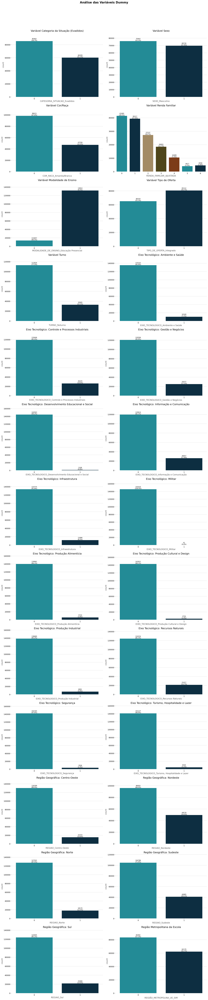

In [ ]:
# Função para adicionar rótulos de contagem e porcentagens nos gráficos
def add_percentage_by_group(ax, data, x):
    counts = data[x].value_counts()
    totals = counts.sum()
    percentages = (counts / totals) * 100
    labels = [f'{count}\n({percentage:.1f}%)' for count, percentage in zip(counts, percentages)]
    
    for bar, label in zip(ax.patches, labels):
        ax.annotate(label, 
                    (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                    ha='center', va='bottom', fontsize=10)
    
    ax.set_ylim(0, ax.get_ylim()[1] * 1.1)  # Ajusta o limite superior do eixo Y

# Configuração da paleta de cores
color_palette3 = ["#109BA8", "#053048", "#AD8D5C", "#594B12", "#8c3608"]

# Variáveis para plotagem
variaveis = [
    ('CATEGORIA_SITUACAO_Evadidos', 'Variável Categoria da Situação (Evadidos)'),
    ('SEXO_Masculino', 'Variável Sexo'),
    ('COR_RACA_Amarela/Branca', 'Variável Cor/Raça'),
    ('RENDA_FAMILIAR_AJUSTADA', 'Variável Renda Familiar'),
    ('MODALIDADE_DE_ENSINO_Educação Presencial', 'Variável Modalidade de Ensino'),
    ('TIPO_DE_OFERTA_Integrado', 'Variável Tipo de Oferta'),
    ('TURNO_Noturno', 'Variável Turno'),
    ('EIXO_TECNOLOGICO_Ambiente e Saúde', 'Eixo Tecnológico: Ambiente e Saúde'),
    ('EIXO_TECNOLOGICO_Controle e Processos Industriais', 'Eixo Tecnológico: Controle e Processos Industriais'),
    ('EIXO_TECNOLOGICO_Gestão e Negócios', 'Eixo Tecnológico: Gestão e Negócios'),
    ('EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social', 'Eixo Tecnológico: Desenvolvimento Educacional e Social'),
    ('EIXO_TECNOLOGICO_Informação e Comunicação', 'Eixo Tecnológico: Informação e Comunicação'),
    ('EIXO_TECNOLOGICO_Infraestrutura', 'Eixo Tecnológico: Infraestrutura'),
    ('EIXO_TECNOLOGICO_Militar', 'Eixo Tecnológico: Militar'),
    ('EIXO_TECNOLOGICO_Produção Alimentícia', 'Eixo Tecnológico: Produção Alimentícia'),
    ('EIXO_TECNOLOGICO_Produção Cultural e Design', 'Eixo Tecnológico: Produção Cultural e Design'),
    ('EIXO_TECNOLOGICO_Produção Industrial', 'Eixo Tecnológico: Produção Industrial'),
    ('EIXO_TECNOLOGICO_Recursos Naturais', 'Eixo Tecnológico: Recursos Naturais'),
    ('EIXO_TECNOLOGICO_Segurança', 'Eixo Tecnológico: Segurança'),
    ('EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer', 'Eixo Tecnológico: Turismo, Hospitalidade e Lazer'),
    ('REGIAO_Centro-Oeste', 'Região Geográfica: Centro-Oeste'),
    ('REGIAO_Nordeste', 'Região Geográfica: Nordeste'),
    ('REGIAO_Norte', 'Região Geográfica: Norte'),
    ('REGIAO_Sudeste', 'Região Geográfica: Sudeste'),
    ('REGIAO_Sul', 'Região Geográfica: Sul'),
    ('REGIÃO_METROPOLINA_UE_SIM', 'Região Metropolitana da Escola')
]

# Configuração do gráfico
plt.figure(figsize=(20, len(variaveis) * 4))
# plt.suptitle("Análise das Variáveis Dummy", fontweight="bold", fontsize=20)

for i, (var, title) in enumerate(variaveis, 1):
    plt.subplot(len(variaveis) // 2 + 1, 2, i)
    plt.gca().set_title(title)
    ax = sns.countplot(x=var, palette=color_palette3, data=data)
    add_percentage_by_group(ax, data, var)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [129]:
variables = [
    'CATEGORIA_SITUACAO_Evadidos','_Renda_Familiar_Ord', 'SEXO_Masculino', 'COR_RACA_Amarela/Branca', 'MODALIDADE_DE_ENSINO_Educação Presencial', 'TIPO_DE_OFERTA_Integrado', 
    'TURNO_Noturno', 'EIXO_TECNOLOGICO_Ambiente e Saúde', 'EIXO_TECNOLOGICO_Controle e Processos Industriais', 'EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social', 
    'EIXO_TECNOLOGICO_Gestão e Negócios', 'EIXO_TECNOLOGICO_Informação e Comunicação', 'EIXO_TECNOLOGICO_Infraestrutura', 'EIXO_TECNOLOGICO_Militar', 'EIXO_TECNOLOGICO_Produção Alimentícia', 
    'EIXO_TECNOLOGICO_Produção Cultural e Design' , 'EIXO_TECNOLOGICO_Produção Industrial', 'EIXO_TECNOLOGICO_Recursos Naturais', 'EIXO_TECNOLOGICO_Segurança', 
    'EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer' , 'REGIAO_Centro-Oeste' , 'REGIAO_Nordeste', 'REGIAO_Norte' , 'REGIAO_Sudeste', 'REGIAO_Sul',
    'REGIÃO_METROPOLINA_UE_SIM'
]
barplot_features = variables 

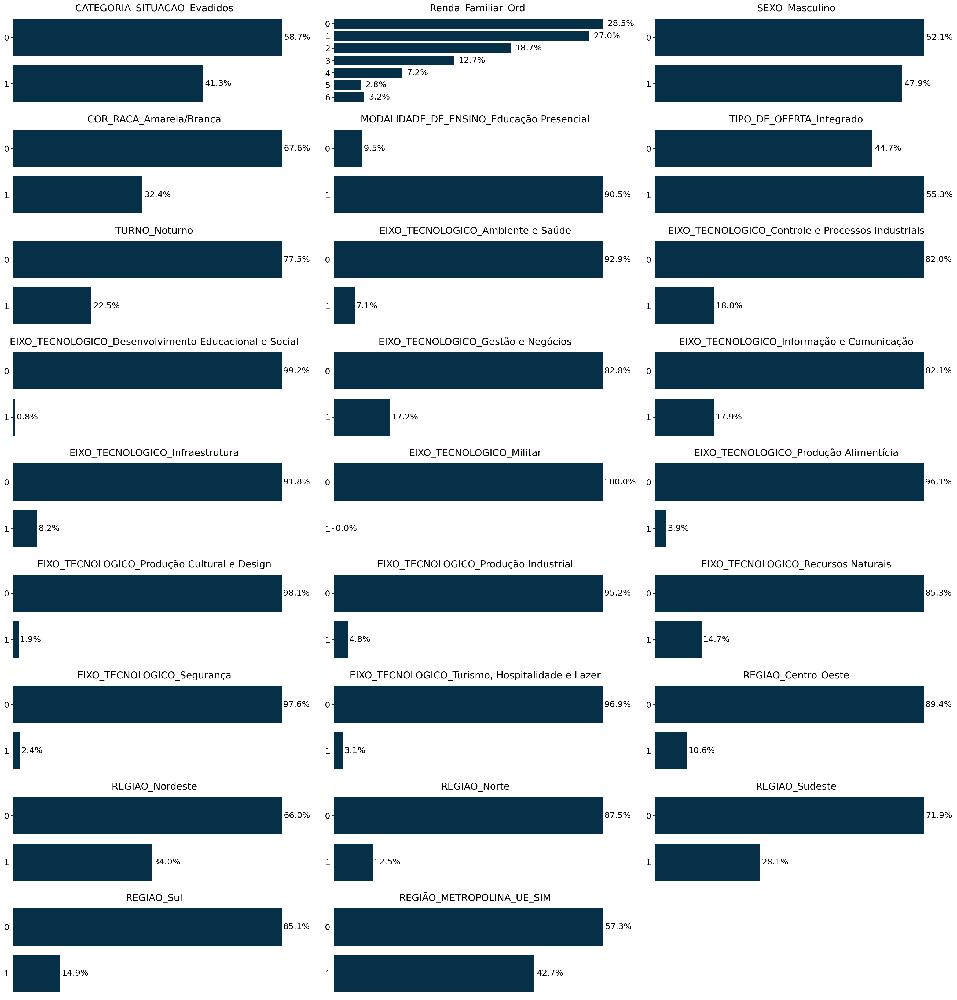

In [130]:
analysis_plots(data=data, features=barplot_features, barplot=True, figsize=(24, 25))

#### 3.2.1 Análise Bivariada e Multivariada
Será feita a análise bivariada e multivariada a seguir para ver como as variáveis estão relacionadas entre si, especialmente com a variável alvo (evadidos).

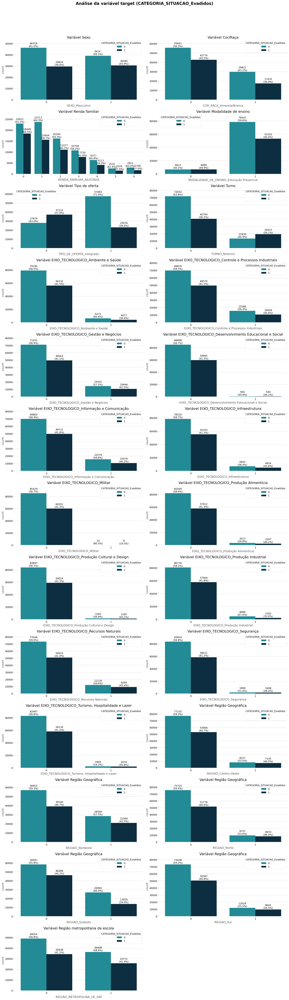

In [ ]:
def add_percentage_by_group(ax, data, x, hue):
    counts = data.groupby([x, hue]).size().unstack(fill_value=0)
    
    percentages = counts.apply(lambda c: c / c.sum() * 100, axis=1)
    

    hue_order = ax.legend_.get_texts()
    hue_labels = [t.get_text() for t in hue_order]
    
    for i, c in enumerate(ax.containers):
        labels = []
        for j, v in enumerate(c):
            height = v.get_height()
            if height > 0:
                try:
                    percentage = percentages.iloc[j, percentages.columns.get_loc(hue_labels[i])]
                except KeyError:
                    percentage = percentages.iloc[j, i]
                labels.append(f'{int(height)}\n({percentage:.1f}%)')
            else:
                labels.append('')
        ax.bar_label(c, labels=labels, label_type='edge', padding=2)

    plt.tight_layout()
    ax.set_ylim(0, ax.get_ylim()[1] * 1.1)  

# Função para plotar gráficos categóricos com título e porcentagens
color_palette3 = ["#109BA8","#053048","#AD8D5C","#594B12","#8c3608"]

plt.figure(figsize=(20, 85))
# plt.suptitle("Análise da variável target (CATEGORIA_SITUACAO_Evadidos)", fontweight="bold", fontsize=20)

plt.subplot(16, 2, 1)
plt.gca().set_title('Variável Sexo')
ax1 = sns.countplot(x='SEXO_Masculino', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax1, data, 'SEXO_Masculino', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 2)
plt.gca().set_title('Variável Cor/Raça')
ax2 = sns.countplot(x='COR_RACA_Amarela/Branca', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax2, data, 'COR_RACA_Amarela/Branca', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 3)
plt.gca().set_title('Variável Renda familiar')
ax3 = sns.countplot(x='RENDA_FAMILIAR_AJUSTADA', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax3, data, 'RENDA_FAMILIAR_AJUSTADA', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 4)
plt.gca().set_title('Variável Modalidade de ensino')
ax4 = sns.countplot(x='MODALIDADE_DE_ENSINO_Educação Presencial', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax4, data, 'MODALIDADE_DE_ENSINO_Educação Presencial', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 5)
plt.gca().set_title('Variável Tipo de oferta')
ax5 = sns.countplot(x='TIPO_DE_OFERTA_Integrado', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax5, data, 'TIPO_DE_OFERTA_Integrado', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 6)
plt.gca().set_title('Variável Turno')
ax6 = sns.countplot(x='TURNO_Noturno', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax6, data, 'TURNO_Noturno', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 7)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Ambiente e Saúde')
ax12 = sns.countplot(x='EIXO_TECNOLOGICO_Ambiente e Saúde', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax12, data, 'EIXO_TECNOLOGICO_Ambiente e Saúde', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 8)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Controle e Processos Industriais')
ax13 = sns.countplot(x='EIXO_TECNOLOGICO_Controle e Processos Industriais', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax13, data, 'EIXO_TECNOLOGICO_Controle e Processos Industriais', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 9)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Gestão e Negócios')
ax14 = sns.countplot(x='EIXO_TECNOLOGICO_Gestão e Negócios', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax14, data, 'EIXO_TECNOLOGICO_Gestão e Negócios', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 10)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social')
ax15 = sns.countplot(x='EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax15, data, 'EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 11)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Informação e Comunicação')
ax16 = sns.countplot(x='EIXO_TECNOLOGICO_Informação e Comunicação', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax16, data, 'EIXO_TECNOLOGICO_Informação e Comunicação', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 12)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Infraestrutura')
ax17 = sns.countplot(x='EIXO_TECNOLOGICO_Infraestrutura', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax17, data, 'EIXO_TECNOLOGICO_Infraestrutura', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 13)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Militar')
ax19 = sns.countplot(x='EIXO_TECNOLOGICO_Militar', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax19, data, 'EIXO_TECNOLOGICO_Militar', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 14)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Produção Alimentícia')
ax20 = sns.countplot(x='EIXO_TECNOLOGICO_Produção Alimentícia', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax20, data, 'EIXO_TECNOLOGICO_Produção Alimentícia', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 15)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Produção Cultural e Design')
ax21 = sns.countplot(x='EIXO_TECNOLOGICO_Produção Cultural e Design', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax21, data, 'EIXO_TECNOLOGICO_Produção Cultural e Design', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 16)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Produção Industrial')
ax22 = sns.countplot(x='EIXO_TECNOLOGICO_Produção Industrial', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax22, data, 'EIXO_TECNOLOGICO_Produção Industrial', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 17)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Recursos Naturais')
ax23 = sns.countplot(x='EIXO_TECNOLOGICO_Recursos Naturais', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax23, data, 'EIXO_TECNOLOGICO_Recursos Naturais', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 18)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Segurança')
ax24 = sns.countplot(x='EIXO_TECNOLOGICO_Segurança', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax24, data, 'EIXO_TECNOLOGICO_Segurança', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2,19)
plt.gca().set_title('Variável EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer')
ax25 = sns.countplot(x='EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax25, data, 'EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 20)
plt.gca().set_title('Variável Região Geográfica')
ax7 = sns.countplot(x='REGIAO_Centro-Oeste', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax7, data, 'REGIAO_Centro-Oeste', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 21)
plt.gca().set_title('Variável Região Geográfica')
ax8 = sns.countplot(x='REGIAO_Nordeste', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax8, data, 'REGIAO_Nordeste', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 22)
plt.gca().set_title('Variável Região Geográfica')
ax9 = sns.countplot(x='REGIAO_Norte', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax9, data, 'REGIAO_Norte', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 23)
plt.gca().set_title('Variável Região Geográfica')
ax10 = sns.countplot(x='REGIAO_Sudeste', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax10, data, 'REGIAO_Sudeste', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2, 24)
plt.gca().set_title('Variável Região Geográfica')
ax11 = sns.countplot(x='REGIAO_Sul', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax11, data, 'REGIAO_Sul', 'CATEGORIA_SITUACAO_Evadidos')

plt.subplot(16, 2,25)
plt.gca().set_title('Variável Região metropolitana da escola')
ax26 = sns.countplot(x='REGIÃO_METROPOLINA_UE_SIM', hue='CATEGORIA_SITUACAO_Evadidos', palette=color_palette3, data=data)
add_percentage_by_group(ax26, data, 'REGIÃO_METROPOLINA_UE_SIM', 'CATEGORIA_SITUACAO_Evadidos')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

<Figure size 3750x600 with 0 Axes>

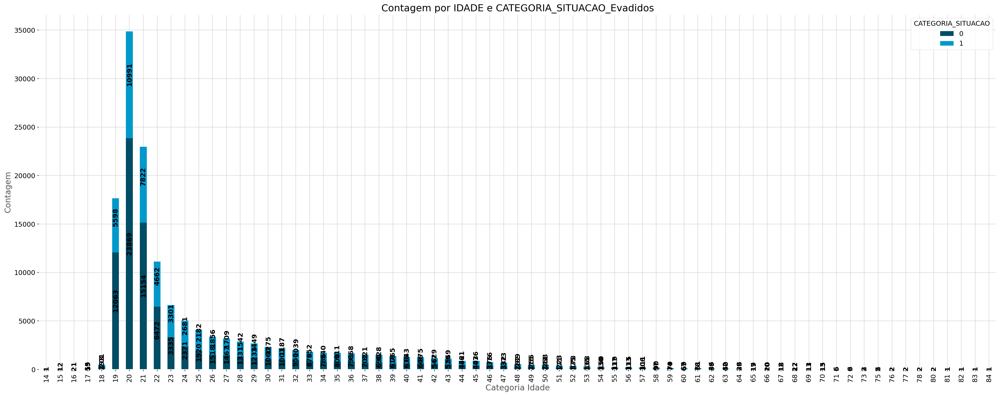

In [128]:
# Agrupando e contando as ocorrências de IDADE por SITUACAO_MATRICULA
contagem = data.groupby(['IDADE', 'CATEGORIA_SITUACAO_Evadidos']).size().unstack(fill_value=0)

# Configurando o gráfico de barras empilhadas
plt.figure(figsize=(25, 4))
contagem.plot(kind='bar', stacked=True, color=['#004D66', '#0099CC', '#66CCCC'], figsize=(25, 10))

# Título e rótulos
plt.title('Contagem por IDADE e CATEGORIA_SITUACAO_Evadidos')
plt.xlabel('Categoria Idade')
plt.ylabel('Contagem')

# Adicionando os valores absolutos nas barras empilhadas
for idx, idade in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[idade, situacao]
        if valor > 0:
            plt.text(idx, acumulado + valor / 2, str(valor), fontsize=12, fontweight='bold', ha='center', rotation='vertical',  color='black')
        acumulado += valor

# Ajustar a legenda e layout
plt.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

plt.show()


Insights:
- A maioria dos alunos evadidos está na faixa etária entre 19 e 22 anos.
- A região que tem mais evadidos proporcionalmente é o Centro_oeste com 20% de evadidos.
- Alunos dos sexo Masculino são 17% da proporção de evadidos.
- A renda familiar que mais tem alunos evadidos é entre 0 e 0,5 salário mímimo com 17%.
- Alunos matrículados no turno: Nortuno são  quase 26% do total de evadidos.
- Os alunos dos cursos que fazem parte do Eixo Tecnolóhico de: Processos Industriais aproximadamente 20% evadem.
- 16% dos alunos que evadiram fizem o curso técnico na Modalidade: Presencial.

<Figure size 3750x900 with 0 Axes>

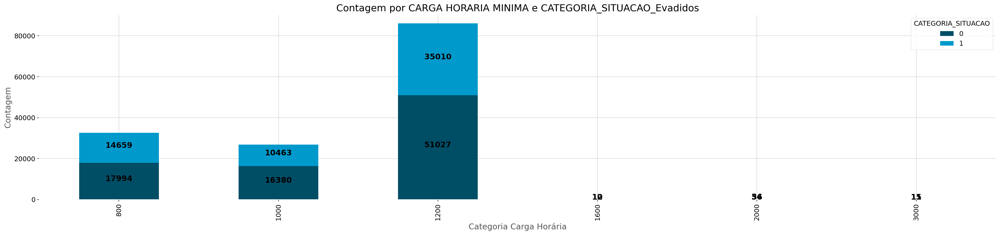

In [129]:
# Agrupando e contando as ocorrências de CARGA_HORARIA_MINIMA por SITUACAO_MATRICULA
contagem = data.groupby(['CARGA_HORARIA_MINIMA', 'CATEGORIA_SITUACAO_Evadidos']).size().unstack(fill_value=0)

# Configurando o gráfico de barras empilhadas
plt.figure(figsize=(25, 6))
contagem.plot(kind='bar', stacked=True, color=['#004D66', '#0099CC', '#66CCCC'], figsize=(25, 6))

# Título e rótulos
plt.title('Contagem por CARGA HORARIA MINIMA e CATEGORIA_SITUACAO_Evadidos')
plt.xlabel('Categoria Carga Horária')
plt.ylabel('Contagem')

# Adicionando os valores absolutos nas barras empilhadas
for idx, carga_horaria in enumerate(contagem.index):
    acumulado = 0
    for situacao in contagem.columns:
        valor = contagem.loc[carga_horaria, situacao]
        if valor > 0:
            plt.text(idx, acumulado + valor / 2, str(valor), fontsize=14, fontweight='bold', ha='center', color='black')
        acumulado += valor

# Ajustar a legenda e layout
plt.legend(title='CATEGORIA_SITUACAO')
plt.tight_layout()

plt.show()

In [130]:
data.groupby('CATEGORIA_SITUACAO_Evadidos')['IDADE'].mean()

CATEGORIA_SITUACAO_Evadidos
0    24.282418
1    26.716587
Name: IDADE, dtype: Float64

In [82]:
from ydata_profiling import ProfileReport
# profile = ProfileReport(df, title="Profiling Report")
# profile

In [ ]:
profile = ProfileReport(data, title="Profiling Report - EDA - Evasão na Rede Federal", lazy=False, explorative=True,
      plot={"correlation": {"cmap": "RdBu_r", "bad": "#000000"}})
profile


Quanto a varíavel carga horária mínima, a grande maioria dos evadidos ocorrem em cursos com 1200 de carga horária. Cerca de 20%. 

#### 3.2.2 Análise da variável target (Evadido-1 Não_Evadido-0)

CATEGORIA_SITUACAO_Evadidos
0    85462
1    60209
Name: count, dtype: Int64
----------------------
CATEGORIA_SITUACAO_Evadidos
0    58.7%
1    41.3%
Name: proportion, dtype: object


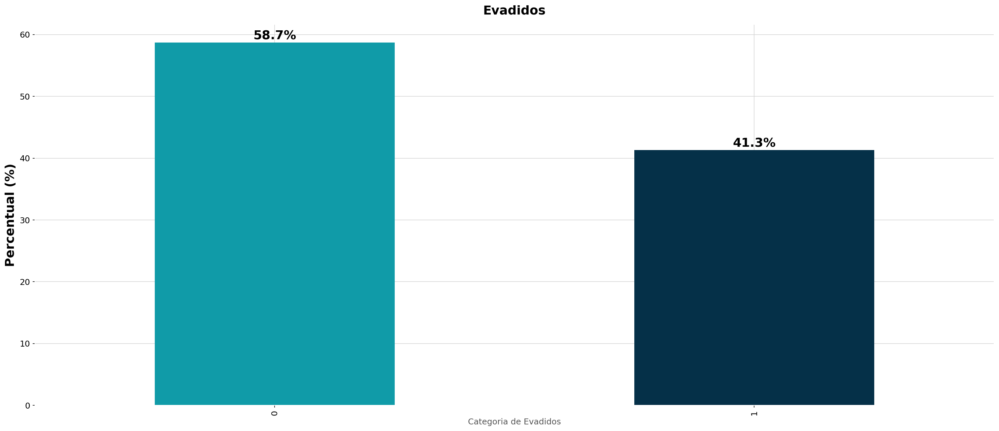

In [131]:
#Contabilizando a variável target
print(data['CATEGORIA_SITUACAO_Evadidos'].value_counts())
print('----------------------')
print(data['CATEGORIA_SITUACAO_Evadidos'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%')

contagem = data['CATEGORIA_SITUACAO_Evadidos'].value_counts()
percentuais = data['CATEGORIA_SITUACAO_Evadidos'].value_counts(normalize=True).mul(100).round(1)

# Gerando o gráfico de barras
plt.figure(figsize=(25, 10))
percentuais.plot(kind='bar', color=color_palette3)
plt.title('Evadidos', fontweight='bold', fontsize=18, pad=15, loc='center')
plt.xlabel('Categoria de Evadidos', fontsize=12)
plt.ylabel('Percentual (%)', fontsize=18, fontweight='bold', ha='center', color='black')

# Adicionando os valores percentuais acima das barras
for i, valor in enumerate(percentuais):
    plt.text(i, valor + 0.5, f'{valor}%', fontsize=18, fontweight='bold', ha='center', color='black')

plt.show()

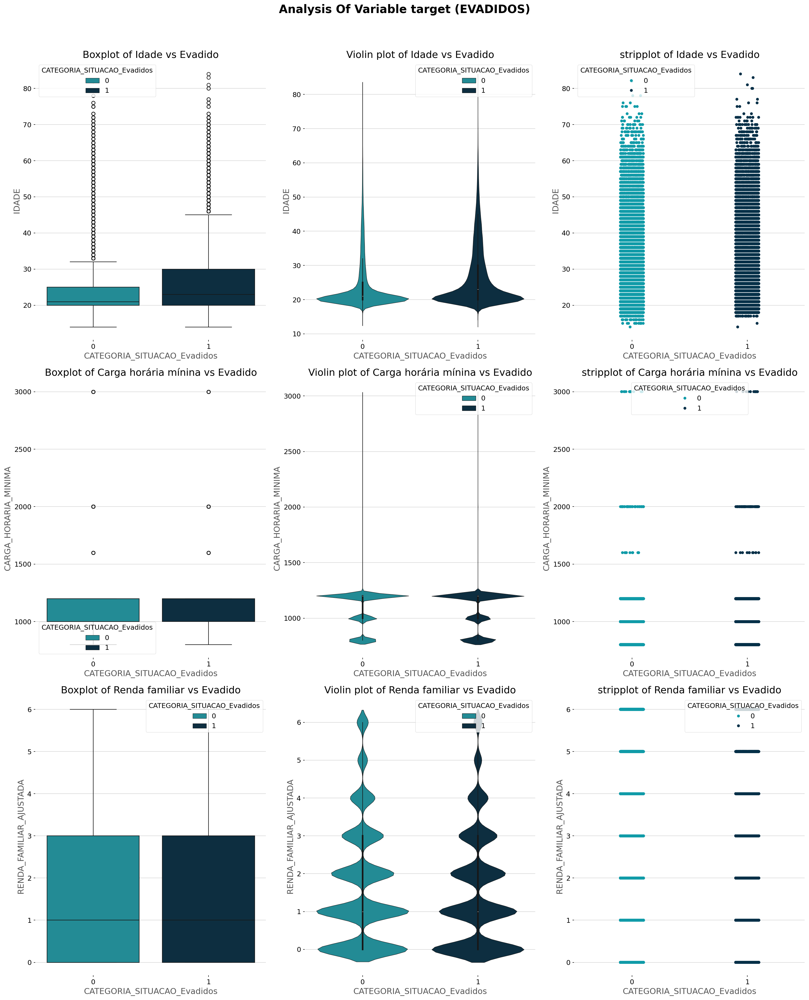

In [111]:
plt.figure(figsize = (20, 25))
plt.suptitle("Analysis Of Variable target (EVADIDOS)", fontweight="bold", fontsize=20)

plt.subplot(3,3,1)
sns.boxplot(x='CATEGORIA_SITUACAO_Evadidos', y='IDADE', data=data, hue= "CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Boxplot of Idade vs Evadido')

plt.subplot(3,3,2)
sns.violinplot(x='CATEGORIA_SITUACAO_Evadidos', y='IDADE', data=data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Violin plot of Idade vs Evadido')

plt.subplot(3,3,3)
sns.stripplot(x='CATEGORIA_SITUACAO_Evadidos', y='IDADE', data=data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('stripplot of Idade vs Evadido')

plt.subplot(3,3,4)
sns.boxplot(x='CATEGORIA_SITUACAO_Evadidos', y='CARGA_HORARIA_MINIMA', data= data, hue= "CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Boxplot of Carga horária mínina vs Evadido')

plt.subplot(3,3,5)
sns.violinplot(x='CATEGORIA_SITUACAO_Evadidos', y='CARGA_HORARIA_MINIMA', data= data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Violin plot of Carga horária mínina vs Evadido')

plt.subplot(3,3,6)
sns.stripplot(x='CATEGORIA_SITUACAO_Evadidos', y='CARGA_HORARIA_MINIMA', data= data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('stripplot of Carga horária mínina vs Evadido')

plt.subplot(3,3,7)
sns.boxplot(x='CATEGORIA_SITUACAO_Evadidos', y='RENDA_FAMILIAR_AJUSTADA', data= data, hue= "CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Boxplot of Renda familiar vs Evadido')

plt.subplot(3,3,8)
sns.violinplot(x='CATEGORIA_SITUACAO_Evadidos', y='RENDA_FAMILIAR_AJUSTADA', data= data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('Violin plot of Renda familiar vs Evadido')

plt.subplot(3,3,9)
sns.stripplot(x='CATEGORIA_SITUACAO_Evadidos', y='RENDA_FAMILIAR_AJUSTADA', data= data, hue="CATEGORIA_SITUACAO_Evadidos", palette=color_palette3)
plt.title('stripplot of Renda familiar vs Evadido')


plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

Analisando a variável de IDADE, é possível confirmar a observação anterior: quanto menor a idade do aluno, que são aqueles que mais procuram cursos técnicos, maior a probabilidade de evadir da escola. A mesma tendência se aplica a carga horária mínima; o curso ter uma carga horaria maior favorece a evasão. Quando a renda familiar, observa-se que os alunos que ganham até 1,5 salários mínimos são os que mais estão propensos a evadirem.

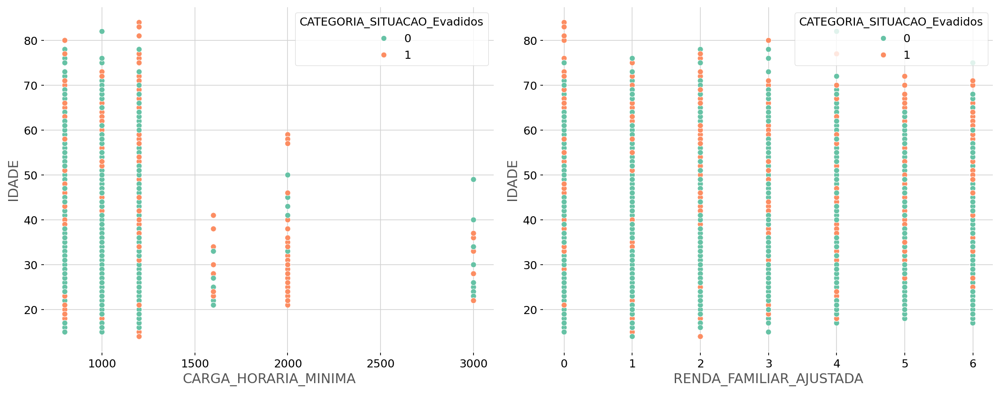

In [117]:
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
sns.scatterplot(data=data, x='CARGA_HORARIA_MINIMA', y='IDADE', hue='CATEGORIA_SITUACAO_Evadidos', ax=axes[0])
sns.scatterplot(data=data, x='RENDA_FAMILIAR_AJUSTADA', y='IDADE',  hue='CATEGORIA_SITUACAO_Evadidos', ax=axes[1])
plt.tight_layout()
plt.show()

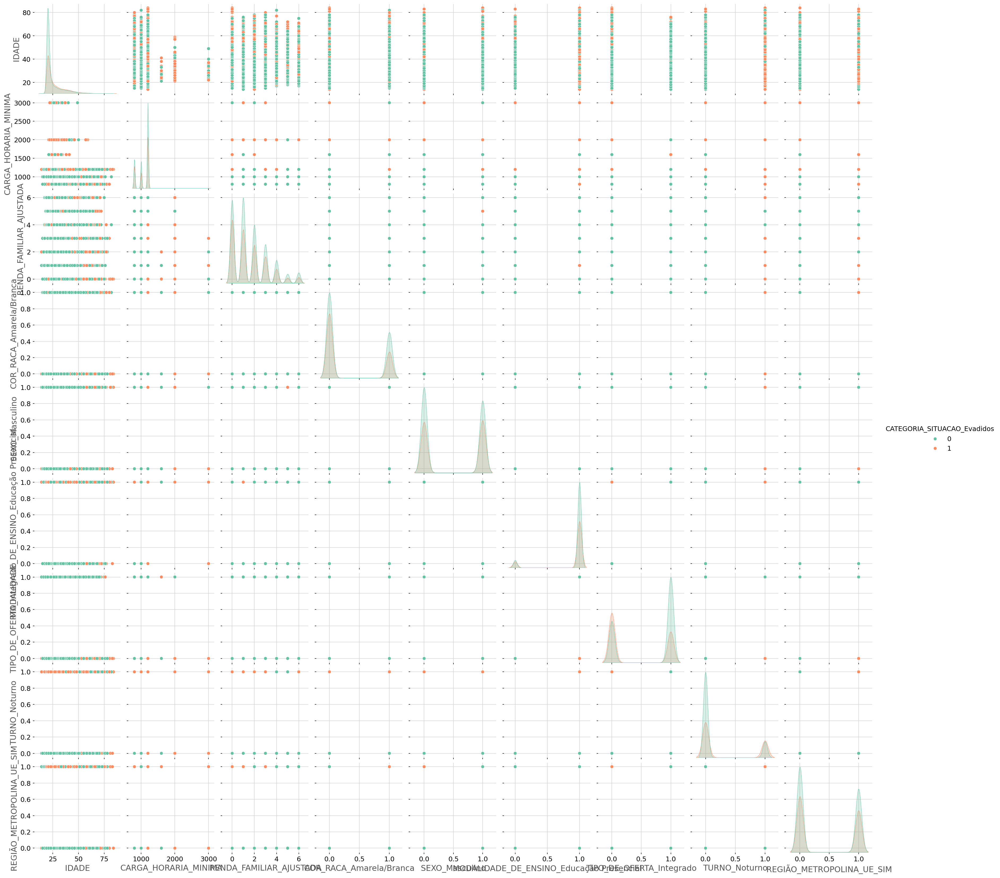

In [ ]:
# limiting the data - Tempo de processamento 60 min
raw_raw_v = data[['IDADE', 'CARGA_HORARIA_MINIMA',
       'RENDA_FAMILIAR_AJUSTADA', 'COR_RACA_Amarela/Branca', 'SEXO_Masculino', 'MODALIDADE_DE_ENSINO_Educação Presencial', 'TIPO_DE_OFERTA_Integrado', 'TURNO_Noturno',
       'REGIÃO_METROPOLINA_UE_SIM', 'CATEGORIA_SITUACAO_Evadidos']]

# Visualizing
g = sns.pairplot(raw_raw_v, hue = 'CATEGORIA_SITUACAO_Evadidos')


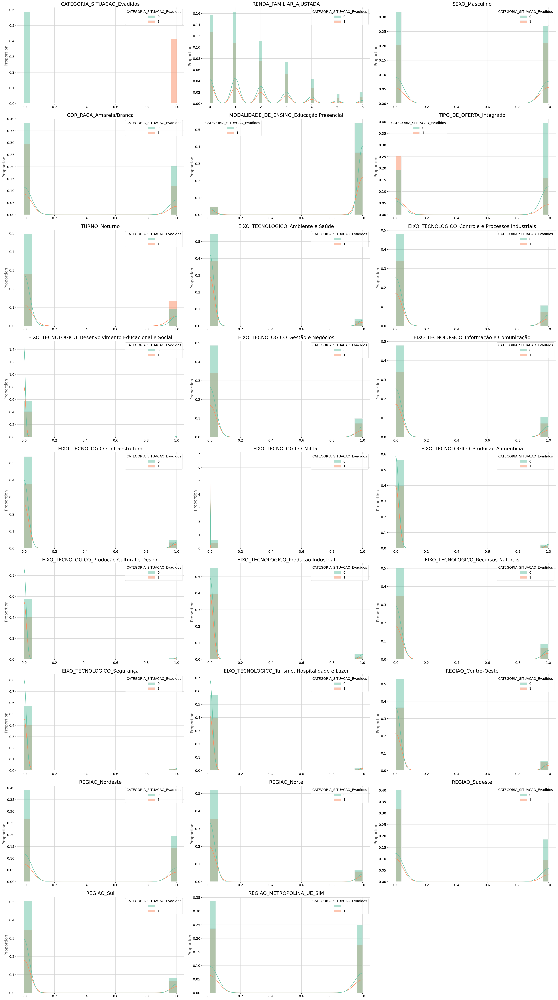

In [132]:
# rodar essa 
analysis_plots(data=data, features=barplot_features, histplot=True, kde=True, hue='CATEGORIA_SITUACAO_Evadidos', figsize=(28, 50))

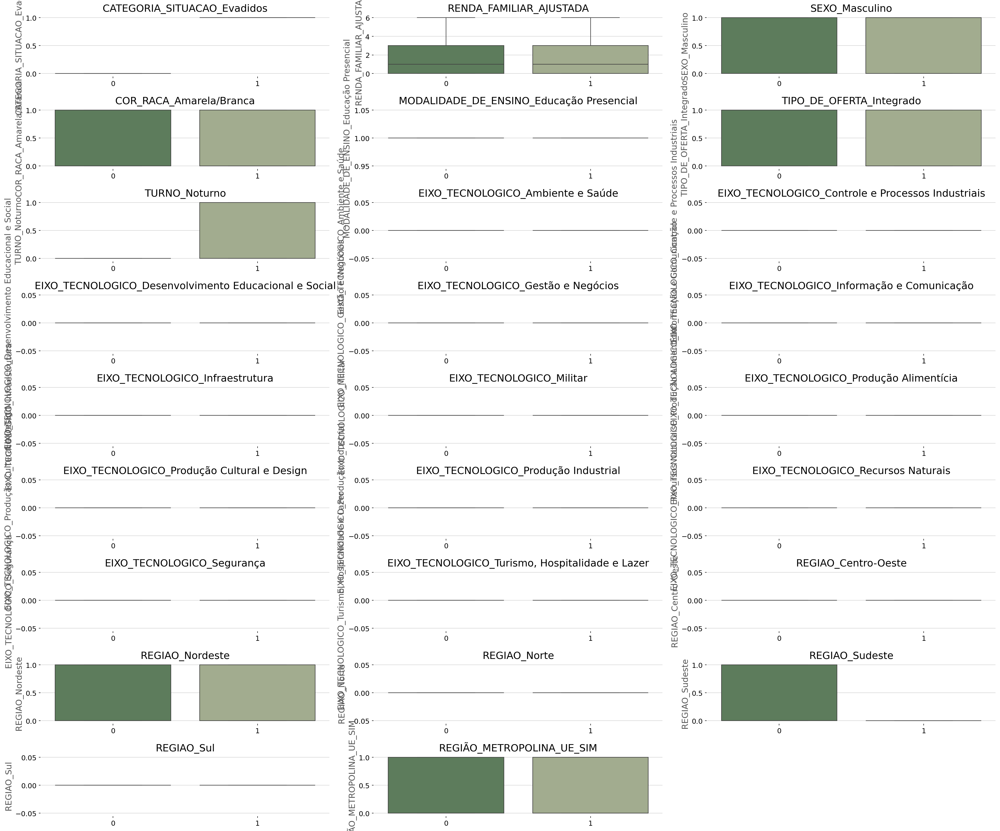

In [133]:
analysis_plots(data=data, features=barplot_features, boxplot=True, boxplot_x='CATEGORIA_SITUACAO_Evadidos', figsize=(24, 20))

Insights:

- Alunos  que evadem...
-  Alunos  que evadem...
-  Alunos  que evadem... 

- Uma observação importante é que uma boa prática seria discretizar essas variáveis contínuas para melhor analisar suas distribuições entre alunos que evadem e os que não evadem. No entanto, com os gráficos acima, é possível ver claramente a discriminação entre os dois grupos. Como o foco será no poder preditivo, construindo modelos mais robustos como o LightGBM, em termos de pré-processamento, a discretização de variáveis aumentaria a dimensionalidade e provavelmente seria prejudicial.

### 3.3 Matriz de Correlação
Será examinado a matriz de correlação para identificar quaisquer relações lineares entre as variáveis do conjunto de dados, especialmente em relação à variável alvo, e avaliar a força e a direção dessas relações.

In [134]:
data.corr()

,IDADE,CARGA_HORARIA_MINIMA,RENDA_FAMILIAR_AJUSTADA,CATEGORIA_SITUACAO_Evadidos,COR_RACA_Amarela/Branca,SEXO_Masculino,MODALIDADE_DE_ENSINO_Educação Presencial,TIPO_DE_OFERTA_Integrado,TURNO_Noturno,EIXO_TECNOLOGICO_Ambiente e Saúde,...,EIXO_TECNOLOGICO_Produção Industrial,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_SIM
IDADE,1.000000,-0.173702,-0.035166,0.141659,-0.033864,-0.010960,-0.255478,-0.495939,0.272386,-0.003031,...,-0.055874,-0.067860,0.054060,0.051163,-0.004391,-0.022591,0.023615,0.030583,-0.026674,0.021796
CARGA_HORARIA_MINIMA,-0.173702,1.000000,0.013017,-0.026755,-0.002010,0.048712,0.193042,0.195593,-0.056521,0.079066,...,0.103500,0.143693,0.035133,-0.129633,-0.032728,0.081656,-0.028517,-0.060779,0.022754,0.008509
RENDA_FAMILIAR_AJUSTADA,-0.035166,0.013017,1.000000,-0.032016,0.073832,0.012047,-0.005115,0.061283,-0.053190,-0.000954,...,0.012888,-0.009859,0.002589,-0.014272,-0.009766,-0.091308,-0.024891,0.089727,0.039830,-0.021587
CATEGORIA_SITUACAO_Evadidos,0.141659,-0.026755,-0.032016,1.000000,-0.062443,0.049252,-0.056593,-0.286585,0.194800,-0.010878,...,-0.038123,0.017592,0.022640,0.016108,0.035911,0.016986,0.038940,-0.092415,0.026914,0.002003
COR_RACA_Amarela/Branca,-0.033864,-0.002010,0.073832,-0.062443,1.000000,0.021607,0.014129,0.054784,-0.020387,-0.023473,...,0.013453,-0.021603,-0.012281,-0.001441,-0.043801,-0.189869,-0.160493,0.148482,0.252186,0.014408
SEXO_Masculino,-0.010960,0.048712,0.012047,0.049252,0.021607,1.000000,0.044386,0.009812,0.047720,-0.089960,...,-0.052421,-0.003012,-0.027546,-0.065300,-0.003135,-0.009002,-0.043021,0.015282,0.035345,0.012528
MODALIDADE_DE_ENSINO_Educação Presencial,-0.255478,0.193042,-0.005115,-0.056593,0.014129,0.044386,1.000000,0.360027,0.174638,0.004323,...,0.072673,0.055445,0.013985,0.048105,0.015080,0.182250,-0.115513,-0.191111,0.092887,0.064825
TIPO_DE_OFERTA_Integrado,-0.495939,0.195593,0.061283,-0.286585,0.054784,0.009812,0.360027,1.000000,-0.565123,-0.017586,...,0.096432,0.107572,-0.117469,-0.076640,0.043323,0.016592,-0.054382,-0.041184,0.043005,-0.046067
TURNO_Noturno,0.272386,-0.056521,-0.053190,0.194800,-0.020387,0.047720,0.174638,-0.565123,1.000000,-0.013711,...,-0.035297,-0.173348,0.125565,0.050503,-0.023579,-0.010558,-0.015157,-0.007001,0.057333,0.022891
EIXO_TECNOLOGICO_Ambiente e Saúde,-0.003031,0.079066,-0.000954,-0.010878,-0.023473,-0.089960,0.004323,-0.017586,-0.013711,1.000000,...,-0.062091,-0.114812,-0.043428,-0.049623,0.005559,0.000214,0.016914,-0.008541,-0.010005,-0.010936


In [135]:
corr_matrix = data.corr(numeric_only=True)

In [136]:
corr_matrix['CATEGORIA_SITUACAO_Evadidos'].sort_values(ascending=False)

CATEGORIA_SITUACAO_Evadidos                              1.000000
TURNO_Noturno                                            0.194800
IDADE                                                    0.141659
SEXO_Masculino                                           0.049252
REGIAO_Norte                                             0.038940
REGIAO_Centro-Oeste                                      0.035911
REGIAO_Sul                                               0.026914
EIXO_TECNOLOGICO_Segurança                               0.022640
EIXO_TECNOLOGICO_Recursos Naturais                       0.017592
REGIAO_Nordeste                                          0.016986
EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer          0.016108
EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social    0.013806
EIXO_TECNOLOGICO_Gestão e Negócios                       0.010382
EIXO_TECNOLOGICO_Produção Cultural e Design              0.004954
REGIÃO_METROPOLINA_UE_SIM                                0.002003
EIXO_TECNO

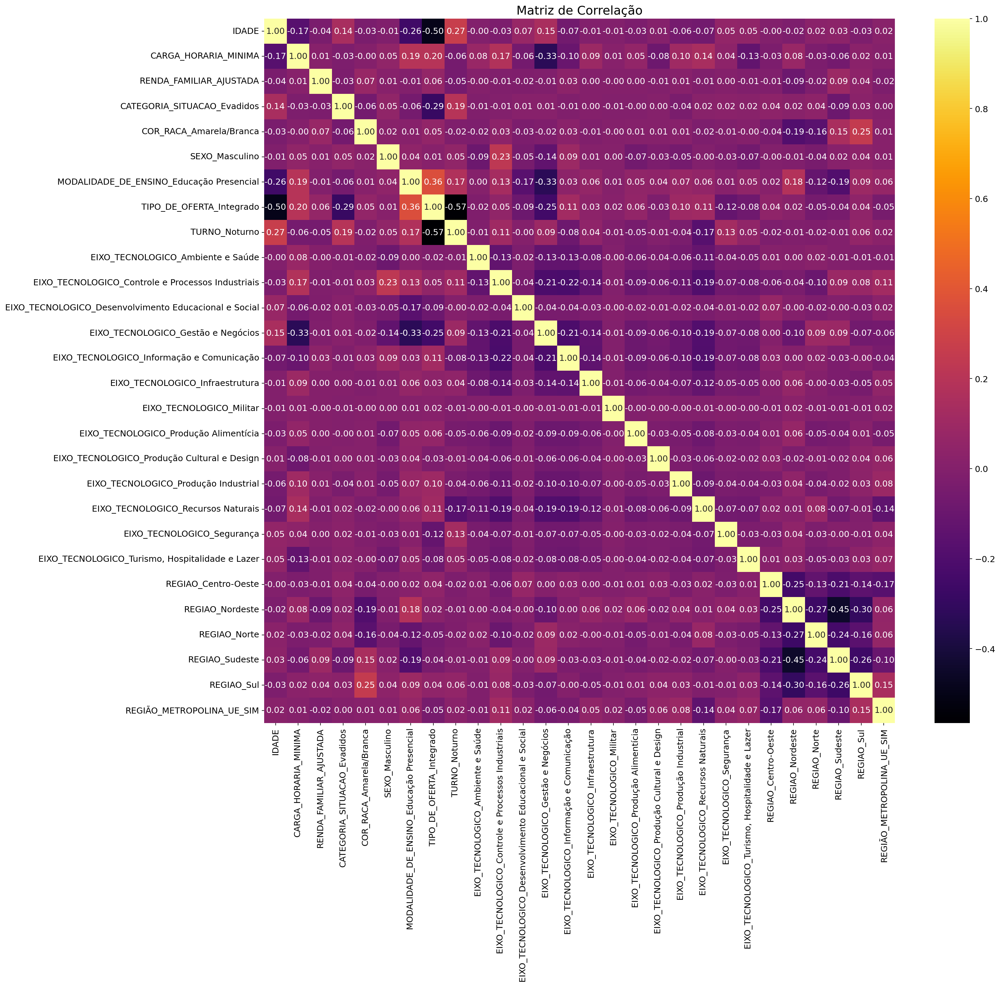

In [137]:
# Plotar a matriz de correlação
plt.figure(figsize=(20, 18))
sns.heatmap(corr_matrix, annot=True, cmap='inferno', fmt='.2f') # coolwarm
plt.title('Matriz de Correlação')
plt.show()

Insights: REVER
- Turno noturno, modalidade de ensino presencial e cursos ofertados no modalidade subsequente apresentam uma correlação negativa moderada com a variável alvo. Isso faz total sentido. Quanto maior a idade do aluno, maior a probabilidade de ele cancelar. Além disso, alunos com idade mais baixa e de reigão norte tendem a evadir devido as dificuldades de acessibilidade da região do Brasil.
- Idade do alunos estão fortemente correlacionados positivamente. Quanto mais velho o cliealunonte, maior o risco dele evadir e vice-versa. Portanto, a escola deve concentrar seus esforços em reter também os alunos mais velhos.
- O gênero apresenta uma correlação positiva moderada com a (....). Isso pode indicar que os alunos do sexo masculino tendem a evadirem mais do que os do sexo feminino.
- Algumas variáveis que são naturalmente relacionadas estão altamente correlacionadas, como esperado. Este é o caso de alguns eixos tecnológicos. 

---
## 4. Construção do modelo
Modelagem: dividir os dados em conjuntos de treinamento e teste, treinamento do modelo, comparação, seleção de características e tunning.

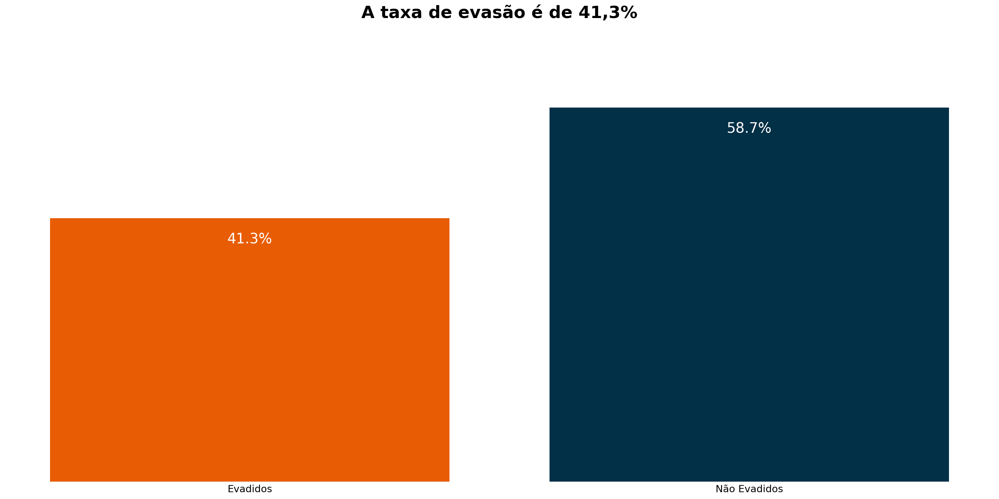

In [138]:
# Agrupar os dados pela variável de evasão.
evadidos_grp = data.groupby(['CATEGORIA_SITUACAO_Evadidos'])[['CATEGORIA_SITUACAO_Evadidos']].count().rename(columns={'CATEGORIA_SITUACAO_Evadidos': 'count'}).reset_index()
evadidos_grp['pct'] = (evadidos_grp['count'] / evadidos_grp['count'].sum()) * 100
evadidos_grp = evadidos_grp.sort_values(by=['pct'])

# Definir o gráfico.
fig, ax = plt.subplots(figsize=(25, 10))
        
# Plotar o gráfico de barras.
bars = ax.bar(x=evadidos_grp['CATEGORIA_SITUACAO_Evadidos'], height=evadidos_grp['pct'], color=['#e85d04', '#023047'])
        
# Customize the plot.
ax.set_title('A taxa de evasão é de 41,3%', fontweight='bold', fontsize=24, pad=100, loc='center')
ax.set_xlabel('')
ax.set_xticks(ticks=range(2), labels=['Não Evadidos', 'Evadidos'], fontsize=14)
ax.tick_params(axis=u'both', which=u'both',length=0)
ax.invert_xaxis()
        
ax.yaxis.set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.grid(False)

for bar in bars:
    height = bar.get_height()
    ax.annotate('{:.1f}%'.format(height), 
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, -30),  
                textcoords="offset points",
                ha='center', va='center',
                fontsize=20, color='white')

A variável alvo está desequilibrada. Aproximadamente 41% dos alunos são evadidos. Portanto, será adotadas algumas estratégias para lidar com isso. Elas são:

- Divisão estratificada e validação cruzada em k-fold para manter a proporção da variável alvo nos conjuntos de teste e validação, mesmo durante a afinação de hiperparâmetros.
- Definir diferentes pesos para classes das instâncias da classe majoritária e da classe minoritária. A ideia é atribuir pesos maiores à classe minoritária, de modo que o modelo seja penalizado ao classificar erroneamente um aluno evadido. Esses pesos são definidos como um hiperparâmetro específico do modelo.
- Analisar a trade-off entre precisão e recall, se necessário. O principal objetivo aqui é prever as probabilidades de evasão, e não uma previsão binária. Isso permitirá que a unidade de ensino tome decisões mais informadas. Em vez de simplesmente avaliar se um aluno irá evadir ou não, poderá verificar a probabilidade de ele interromper o estudo.

Será analisado os valores únicos das variáveis categóricas. A cardinalidade é um fator importante ao escolher uma técnica de codificação para essas variáveis.

In [139]:
#Será criado listas separadas para as características categóricas, numéricas e a variável alvo, a fim de analisar os dados de forma individual.
numerical_features = data.select_dtypes('number').columns.tolist()
categorical_features = data.select_dtypes('object').columns.tolist()
target = 'CATEGORIA_SITUACAO_Evadidos'

print(f'Quais são as {len(numerical_features)} features numéricas. Elas são: ')
print(numerical_features)
print(f'\nQuais são as {len(categorical_features)} features categóricas. Elas são: ')
print(categorical_features)
print(f'\nA feature alvo (target) é: {target}.')

Quais são as 28 features numéricas. Elas são: 
['IDADE', 'CARGA_HORARIA_MINIMA', 'RENDA_FAMILIAR_AJUSTADA', 'CATEGORIA_SITUACAO_Evadidos', 'COR_RACA_Amarela/Branca', 'SEXO_Masculino', 'MODALIDADE_DE_ENSINO_Educação Presencial', 'TIPO_DE_OFERTA_Integrado', 'TURNO_Noturno', 'EIXO_TECNOLOGICO_Ambiente e Saúde', 'EIXO_TECNOLOGICO_Controle e Processos Industriais', 'EIXO_TECNOLOGICO_Desenvolvimento Educacional e Social', 'EIXO_TECNOLOGICO_Gestão e Negócios', 'EIXO_TECNOLOGICO_Informação e Comunicação', 'EIXO_TECNOLOGICO_Infraestrutura', 'EIXO_TECNOLOGICO_Militar', 'EIXO_TECNOLOGICO_Produção Alimentícia', 'EIXO_TECNOLOGICO_Produção Cultural e Design', 'EIXO_TECNOLOGICO_Produção Industrial', 'EIXO_TECNOLOGICO_Recursos Naturais', 'EIXO_TECNOLOGICO_Segurança', 'EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer', 'REGIAO_Centro-Oeste', 'REGIAO_Nordeste', 'REGIAO_Norte', 'REGIAO_Sudeste', 'REGIAO_Sul', 'REGIÃO_METROPOLINA_UE_SIM']

Quais são as 0 features categóricas. Elas são: 
[]

A feature alvo 

In [140]:
for feature in categorical_features:
    print(feature)
    print('-'*40)
    print(f'Existem {data[feature].nunique()} valores únicos values. Eles são: ')
    print(data[feature].value_counts(normalize=True))
    print(feature)

Renda_familiar como vimos apresenta relações ordinais. Portanto, o OrdinalEncoder pode ser uma boa escolha para codificá-las.
Exceto Turno, Modalidade de ensino, todas as variáveis categóricas possuem uma categoria "Não declarada". Será investigado a distribuição de evasão dentro dessa categoria para decidir como tratá-la. Se "desconhecido" apresentar uma diferenciação entre alunos que evadiram e que não evadiram, será uma boa prática mantê-la como uma categoria adicional das variáveis. Fazer a imputação ou removê-las introduziria viés e perda de informação, uma vez que o padrão de evasão não ocorre de forma aleatória nesse grupo, o que ajudaria o modelo a distinguir entre alunos que evadiram e os que não evadiram.

### 4.1 Dividir os Dados em Conjuntos de Treinamento e Teste
- Primeiramente, será dividido os dados em conjuntos de treinamento e teste.
- O conjunto de teste deve ser composto por dados que o modelo nunca viu antes.
-Focando no conjunto de treinamento para evitar vazamento de dados, obter uma representação realista e avaliar o modelo corretamente com novos dados não vistos.
- Será especificado stratify=y para que a função train_test_split garanta que o processo de divisão mantenha a mesma porcentagem de cada classe-alvo tanto nos conjuntos de treinamento quanto de teste. Isso é particularmente útil quando se lida com conjuntos de dados desequilibrados, como é o caso, pois há mais alunos em curso e concluídos do que alunos que evadiram.

In [141]:
X = data.drop(columns=['CATEGORIA_SITUACAO_Evadidos'], axis=1)
y = data['CATEGORIA_SITUACAO_Evadidos'].copy()

In [142]:
# Dividir os dados em conjunto de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

In [143]:
print(f'Conjunto de dados do preditor de treinamento: {X_train.shape}.')
print(f'Conjunto de dados do alvo de treinamento: {y_train.shape}.')
print("---------------------------------------------------------------")
print(f'Conjunto de dados do preditor de teste: {X_test.shape}.')
print(f'Conjunto de dados do alvo de teste: {y_test.shape}.')

Conjunto de dados do preditor de treinamento: (116536, 27).
Conjunto de dados do alvo de treinamento: (116536,).
---------------------------------------------------------------
Conjunto de dados do preditor de teste: (29135, 27).
Conjunto de dados do alvo de teste: (29135,).


In [144]:
print(f'Proporção do alvo de treinamento: ')
print(f'{y_train.value_counts(normalize=True)}')
print(f'\nProporção do alvo de teste: ')
print(f'{y_test.value_counts(normalize=True)}')

Proporção do alvo de treinamento: 
CATEGORIA_SITUACAO_Evadidos
0    0.586677
1    0.413323
Name: proportion, dtype: Float64

Proporção do alvo de teste: 
CATEGORIA_SITUACAO_Evadidos
0    0.586683
1    0.413317
Name: proportion, dtype: Float64


In [ ]:
from ydata_profiling import ProfileReport, compare

train_report  = ProfileReport(X_train, title="Train")
test_report = ProfileReport(X_test, title="Teste")

comparisson_report = compare([train_report, test_report])

comparisson_report

In [145]:
train = pd.concat([X_train, y_train], axis=1)
train.head()

,IDADE,CARGA_HORARIA_MINIMA,RENDA_FAMILIAR_AJUSTADA,COR_RACA_Amarela/Branca,SEXO_Masculino,MODALIDADE_DE_ENSINO_Educação Presencial,TIPO_DE_OFERTA_Integrado,TURNO_Noturno,EIXO_TECNOLOGICO_Ambiente e Saúde,EIXO_TECNOLOGICO_Controle e Processos Industriais,...,EIXO_TECNOLOGICO_Recursos Naturais,EIXO_TECNOLOGICO_Segurança,"EIXO_TECNOLOGICO_Turismo, Hospitalidade e Lazer",REGIAO_Centro-Oeste,REGIAO_Nordeste,REGIAO_Norte,REGIAO_Sudeste,REGIAO_Sul,REGIÃO_METROPOLINA_UE_SIM,CATEGORIA_SITUACAO_Evadidos
9493,22,1200,6,1,1,1,1,0,0,0,...,0,0,0,0,0,0,1,0,1,1
91974,20,1000,0,0,1,1,1,0,0,1,...,0,0,0,0,0,1,0,0,1,0
37082,20,1200,1,0,0,1,1,0,1,0,...,0,0,0,0,1,0,0,0,0,1
28429,21,1000,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
130047,30,800,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


----
## EDA Conclusões
**Principais Insights:**
- A Instituição ou o gestor devem estar atento à ocorrência da evasão e seus fatores. A distribuição dos evadidos pelas variáveis apresentados ajudam a entender como elas contribuem para esse fato ocorrer. Grande parte das viriáveis apresentam representação na proporção de 12% a 20% do total de alunos.
- Quase 60% dos alunos que evadem são de cursos técnicos presenciais. Isso mostra a tendência para a oferta EaD com as disponibilidade de redes, internet e mobile.
- Cursos ofertados na modalidade de oferta Subsequente e concomitante são onde estão a grande parte dos alunos que evadem. O fato do curso ser realizado na modalidade Integrada ao ensino médio favorece a não evasão dos alunos.
- Naturamente, a idade dos alunos que evadem são entre 17 a 21 anos. Algumas considerações, a primeira que é a idade que jovem se deparam com a necessidade de ajudar na complementação da renda familiar e por isso, tendem a evadir da escola. Por outro lado, são esses jovens o que mais procuram a realização de cursos técnicos por verem neles uma oportunidade para continuar uma renda.
- As regiões Nordeste e Sudeste são as que mais tem proporcionamente alunos evadidos. Isso também ocorre por serem as regiões que tem mais matrículas na base utilizada.
- Alguns eixos tecnológicos apresentam percentuais de evasão maior que os demais. Essa relação ter a ver com a dificuldade que alguns cursos desses eixos tecnológicos apresentam para determinados perfis de estudantes.
- Por fim, cabe informar que aproximadamente apenas 16% da base de dados apresentam alunos evadidos. Esse deslanceamento deve ser tratado para que o modelo de aprendizado de máquina possa apresentar valores em métricas como precisão, recall e f1 significativos contribuir na possibilidade de predição de evasão de alunos na Rede Federal EPCT.